# Image Segmentation with Fast.ai v2 and SemTorch

In [1]:
env = dict()
env['use_dataparallel'] = True

import os
if env['use_dataparallel']:
    os.environ['CUDA_VISIBLE_DEVICES'] = '0,1'
    os.environ['OPENBLAS_NUM_THREADS'] = '1'
else:
    os.environ['CUDA_VISIBLE_DEVICES'] = '1'
    os.environ['OPENBLAS_NUM_THREADS'] = '1'

In [2]:
!nvidia-smi

Wed Sep 22 16:28:26 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 450.80.02    Driver Version: 450.80.02    CUDA Version: 11.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla V100-PCIE...  On   | 00000000:5E:00.0 Off |                    0 |
| N/A   36C    P0    26W / 250W |      0MiB / 32510MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
|   1  Tesla V100-PCIE...  On   | 00000000:86:00.0 Off |                    0 |
| N/A   

# Import-initialization


%matplotlib inline

or

%matplotlib notebook

In [3]:
!pip install semtorch
!pip install --upgrade albumentations
!pip install fastai==2.3.0
!pip show fastai

from fastai.basics import *
from fastai.vision import models
from fastai.vision.all import *
from fastai.metrics import *
from fastai.data.all import *
from fastai.callback import *

# SemTorch
from semtorch import get_segmentation_learner

from pathlib import Path
import random
import numpy as np

# Display larger jupyter cells!
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>"))

if env['use_dataparallel']:
    from fastai.distributed import *
    cuda_training_device = 0           # otherwise: RuntimeError: module must have its parameters and buffers on device cuda:0 (device_ids[0]) but found one of them on device: cuda:1
else:
    pass
    #cuda_training_device = 1           # the device of your choice

You should consider upgrading via the '/local/ranieri/venvs/ml-local-node-10/bin/python3.6 -m pip install --upgrade pip' command.
You should consider upgrading via the '/local/ranieri/venvs/ml-local-node-10/bin/python3.6 -m pip install --upgrade pip' command.


You should consider upgrading via the '/local/ranieri/venvs/ml-local-node-10/bin/python3.6 -m pip install --upgrade pip' command.
Name: fastai
Version: 2.3.0
Summary: fastai simplifies training fast and accurate neural nets using modern best practices
Home-page: https://github.com/fastai/fastai/tree/master/
Author: Jeremy Howard, Sylvain Gugger, and contributors
Author-email: info@fast.ai
License: Apache Software License 2.0
Location: /local/ranieri/venvs/ml-local-node-10/lib/python3.6/site-packages
Requires: pyyaml, matplotlib, scipy, torch, packaging, scikit-learn, pandas, pillow, requests, fastcore, pip, fastprogress, torchvision, spacy
Required-by: SemTorch


/local/ranieri/venvs/ml-local-node-10/lib64/python3.6/site-packages/torch/nn/_reduction.py:44: UserWarning: size_average and reduce args will be deprecated, please use reduction='mean' instead.
  warnings.warn(warning.format(ret))


# Determinism


In [4]:
from datetime import datetime

env['seed'] = 2021
env['launch_time'] = datetime.now().strftime('%Y-%m-%d_%H.%M.%S')

random.seed(env['seed'])
set_seed(env['seed'])
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

# Secondary Functions


Get filenames both for images and masks

In [5]:
#export
def get_y_fn(img_fn):
    if 'mask' in str(img_fn):
        print(f'Warning! {img_fn} looks like a mask!')
    return Path(str(img_fn).replace("images", "masks").replace('.jpg', '.png'))

#export
def get_x_fns(path, folders, debug=False):
    new_fns = []
    for dset_dir in folders:
        fns = get_image_files(path / dset_dir)
        for fn in fns:
            if not 'mask' in str(fn):
                new_fns.append(fn)
    if debug:
        fn_name = inspect.currentframe().f_code.co_name
        print(f'{fn_name} - {len(new_fns)} - {new_fns}')
    return new_fns

Aux Functions



In [6]:
# dataset/train, dataset/valid
def ValidParentSplitter(x):
    return Path(x).parent.name == str(env['validation_dir'])

# dataset/train/images, dataset/train/masks, dataset/valid/images, dataset/valid/masks
def ValidGrandParentSplitter(x):
    return Path(x).parent.parent.name == env['validation_dir'].name

# dataset/subdataset/train/images, dataset/subdataset/train/masks, dataset/subdataset/valid/images, dataset/subdataset/valid/masks
def ValidGrandGrandParentSplitter(x):
    return Path(x).parent.parent.parent.name == env['validation_dir'].name

Loading the codes of the different classes. All the datasets have the same codes.

In [7]:
import torchvision

codes = ['NoPatt','circlets','fringe','long_incisions','eyebrows','oblique_fringe','spirals','Background']

name2id = {v:k for k,v in enumerate(codes)}
print(name2id)
void_code   = name2id['Background']
nopatt_code = name2id['NoPatt']

#export
def surfpatt_metric(input, target):
    target      = target.squeeze(1)
    void_mask   = target != void_code
    nopatt_mask = target != nopatt_code
    mask        = torch.logical_and(void_mask, nopatt_mask)
    return (input.argmax(dim=1)[mask]==target[mask]).float().mean()

{'NoPatt': 0, 'circlets': 1, 'fringe': 2, 'long_incisions': 3, 'eyebrows': 4, 'oblique_fringe': 5, 'spirals': 6, 'Background': 7}


Early Stopping parameters

In [8]:
env['monitor_training']   = "valid_loss"
env['comp_training']      = np.less

env['monitor_evaluating'] = "f1-score"
env['comp_evaluating']    = np.greater

env['patience']           = 10

Augmentations 

In [9]:
import cv2

cv2.setNumThreads(0)
cv2.ocl.setUseOpenCL(False)

from albumentations import (
    Compose,
    HorizontalFlip,
    OneOf,
    ElasticTransform,
    GridDistortion, 
    OpticalDistortion,
    Flip,
    Rotate,
    Transpose,
    CLAHE,
    ShiftScaleRotate,
    RandomRotate90,
    HueSaturationValue,
    Emboss,
    Sharpen,
    PiecewiseAffine,
    #IAAEmboss,
    #IAASharpen,
    #IAAPiecewiseAffine,
    #IAAAdditiveGaussianNoise,
    GaussNoise,
    Blur,
    MotionBlur,
    MedianBlur,
    RandomContrast,
    RandomBrightness,
)

In [10]:
class SegmentationAlbumentationsTransform(ItemTransform):
    split_idx = 0
    def __init__(self, aug): 
        self.aug = aug
    def encodes(self, x):
        img,mask = x
        aug = self.aug(image=np.array(img), mask=np.array(mask))
        return PILImage.create(aug["image"]), PILMask.create(aug["mask"])

def strong_aug(p=1):
    return Compose([
        RandomRotate90(),
        Flip(),
        Transpose(),
        OneOf([
            #IAAAdditiveGaussianNoise(),
            GaussNoise(),
        ], p=0.2),
        OneOf([
            MotionBlur(p=.2),
            MedianBlur(blur_limit=3, p=.1),
            Blur(blur_limit=3, p=.1),
        ], p=0.2),
        ShiftScaleRotate(shift_limit=0.0625, scale_limit=0.2, rotate_limit=45, p=.2),
        OneOf([
            OpticalDistortion(p=0.3),
            GridDistortion(p=.1),
            PiecewiseAffine(p=0.3),
            #IAAPiecewiseAffine(p=0.3),
        ], p=0.2),
        OneOf([
            CLAHE(clip_limit=2),
            Sharpen(),
            #IAASharpen(),
            #IAAEmboss(),
            Emboss(),
            RandomContrast(),
            RandomBrightness(),
        ], p=0.3),
        #HueSaturationValue(p=0.3),
    ], p=p)
    
basicTransformPipeline=Compose([
                        HorizontalFlip    (p=0.25),
                        RandomRotate90    (p=0.25),
                        Transpose         (p=0.25),
                        ShiftScaleRotate  (p=0.25, shift_limit=0.0625, scale_limit=0.50, rotate_limit=45),
                        Blur              (p=0.1,  blur_limit=3),
                        ElasticTransform  (p=0.1,  alpha=120, sigma=120 * 0.05, alpha_affine=120 * 0.03),
                        GridDistortion    (p=0.1,  num_steps=1, distort_limit=0.05),
                        OpticalDistortion (p=0.1,  distort_limit=0.05, shift_limit=0.01),
                        HueSaturationValue(p=0.1),
                        CLAHE             (p=0.1),
                    ],p=1)

basicTransformPipeline  = SegmentationAlbumentationsTransform(basicTransformPipeline)

strongTransformPipeline = strong_aug(p=1)
strongTransformPipeline = SegmentationAlbumentationsTransform(strongTransformPipeline)

/local/ranieri/venvs/ml-local-node-10/lib64/python3.6/site-packages/albumentations/augmentations/transforms.py:1772: FutureWarning: This class has been deprecated. Please use RandomBrightnessContrast
  FutureWarning,
/local/ranieri/venvs/ml-local-node-10/lib64/python3.6/site-packages/albumentations/augmentations/transforms.py:1746: FutureWarning: This class has been deprecated. Please use RandomBrightnessContrast
  FutureWarning,


# Get and setup dataset


In [11]:
basepath       = '/home/ranieri/dataset/surface-pattern-recognition/segmentation'
dataset_suffix = 'v3alpha-RGB'
#newbasepath   = '/local/ranieri/dataset/surface-pattern-recognition/segmentation'
newbasepath    = '/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation'

In [12]:
# rsync the dataset to the node's scratch space (much faster I/O)
!echo "Copying files to: {newbasepath}"
!mkdir -p {newbasepath}
!rsync -a "{basepath}/SURFpattSegmentation_{dataset_suffix}" "{newbasepath}"
basepath = newbasepath

Copying files to: /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation


In [13]:
env['orig_img_size'] = (1585, 1502)

In [14]:
env['project_name'] = f'SURFpatt_{dataset_suffix}'

env['path'] = Path(basepath) / f'SURFpattSegmentation_{dataset_suffix}'

env['training_dir']   = env['path'] / 'training'
env['validation_dir'] = env['path'] / 'validation'

### Perform RGB-to-grayscale conversion of masks



In [15]:
#export
from fastcore.transform import ItemTransform
        
class TargetMaskConvertTransform(ItemTransform):
    def __init__(self):
        self.mapping = {
                        (0, 0, 255): 0,  # 0 = blue - NoPatt
                        (255, 0, 0): 1,  # 1 = red - circlets
                        (0, 255, 0): 2,  # 2 = green - fringe
                        (0, 0, 44): 3,  # 3 = black - long incisions
                        (255, 26, 185): 4,  # 4 = magenta - eyebrows
                        (255, 211, 0): 5,  # 5 = yellow - oblique fringe
                        (0, 88, 0): 6,  # 6 = dark green - spirals
                        (255,255,255): 7, # 7 = white - Background
        }
        
    def mask_to_class_rgb(self, mask, debug=False):
        if debug:
            print('mask_to_class_rgb() - converting RGB mask to grayscale')
        mask = torch.from_numpy(np.array(mask))
        mask = torch.squeeze(mask)  # remove 1

        # check the present values in the mask, 0 and 255 in my case
        if debug:
            print(f'Unique RGB values: {torch.unique(mask)}') 
        # -> unique values rgb     tensor([  0, 255], dtype=torch.uint8)

        class_mask = mask
        if debug:
            print(f'class_mask: {class_mask.shape}')
        class_mask = class_mask.permute(2, 0, 1).contiguous()
        h, w = class_mask.shape[1], class_mask.shape[2]
        mask_out = torch.empty(h, w, dtype=torch.long)

        for k in self.mapping:
            idx = (class_mask == torch.tensor(k, dtype=torch.uint8).unsqueeze(1).unsqueeze(2))         
            validx = (idx.sum(0) == 3)          
            mask_out[validx] = torch.tensor(self.mapping[k], dtype=torch.long)

        # check the present values after mapping, in my case 0, 1, 2, 3
        if debug:
            print(f'Unique grayscale values mapped: {torch.unique(mask)}')
        # -> unique values mapped  tensor([0, 1, 2, 3])
       
        return mask_out
    
    def gray_to_rgb(self, gray):
        rgb = np.zeros((gray.shape[0], gray.shape[1], 3)).astype(np.uint8)
        rgb[:,:,0] = gray
        rgb[:,:,1] = gray
        rgb[:,:,2] = gray
        return rgb
    
    def encodes(self, x, debug=False):
        if type(x) is not tuple and type(x) is not list:        # this is necessary because TargetMaskConvertTransform gets trapped into the PKL even just doing learn.export()
            return x
        img,mask = x
        
        #Convert to array
        mask_arr = np.array(mask)
        if debug:
            print(f'TargetMaskConvertTransform.encodes() uniques before: {np.unique(mask_arr)}')
        
        gray_torch_mask = self.mask_to_class_rgb(mask_arr, debug=debug)
        if debug:
            print(type(gray_torch_mask))
            print(gray_torch_mask.shape)
        gray_mask_arr = gray_torch_mask.numpy().astype(np.uint8)
        if debug:
            print(f'TargetMaskConvertTransform.encodes() uniques middle: {np.unique(gray_mask_arr)}')
            print(type(gray_mask_arr))
            print(gray_mask_arr.dtype)
            print(gray_mask_arr.shape)
            print(gray_mask_arr)
        
        gray_mask_arr_3ch = self.gray_to_rgb(gray_mask_arr)
        if debug:
            print(type(gray_mask_arr_3ch))
            print(gray_mask_arr_3ch.dtype)
            print(gray_mask_arr_3ch.shape)
            print(gray_mask_arr_3ch)
        
        # Back to PILMask
        mask = PILMask(PILMask.create(gray_mask_arr_3ch).convert('L'))
        if debug:
            print(f'TargetMaskConvertTransform.encodes() uniques after: {np.unique(mask)} - mask mode: {mask.mode}')
        return img, mask

In [16]:
#export
def segmentron_splitter(model):
    return [params(model.backbone), params(model.head)]

# DeepLabV3+

In [17]:
for s in [ 'training', 'validation' ]:
        env[s+'_images'] = env[s+'_dir']  / 'images'
        env[s+'_masks']  = env[s+'_dir']  / 'masks'
    
for s in [ 'training', 'validation' ]:
        print(env[s+'_images'])
        print(env[s+'_masks'])

/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB/training/images
/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB/training/masks
/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB/validation/images
/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB/validation/masks


In [18]:
for s in [ 'training', 'validation' ]:
        env[s+'_images_fns'] = get_image_files(env[s+'_images'])
        env[s+'_masks_fns']  = get_image_files(env[s+'_masks'])

for s in [ 'training', 'validation' ]:
        n = random.randint(0, len(env[s+'_images_fns'])-1)
        print(env[s+'_images_fns'][n])
        print(env[s+'_masks_fns'][n])

/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB/training/images/24_382-col.jpg
/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB/training/masks/24_382-col.png
/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB/validation/images/24_22-col.jpg
/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB/validation/masks/24_22-col.png


/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB/training/images/1_21-col.jpg (1585, 1502)
/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB/training/masks/1_21-col.png (1585, 1502)
/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB/validation/images/12_30-col.jpg (1585, 1502)
/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB/validation/masks/12_30-col.png (1585, 1502)


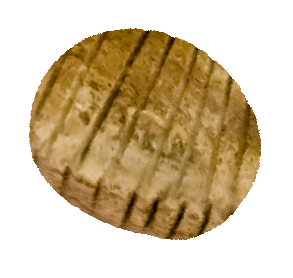

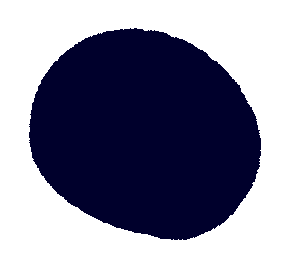

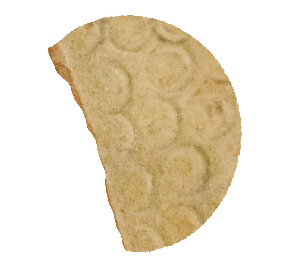

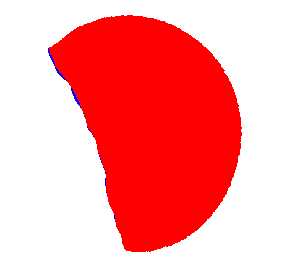

In [19]:
for s in [ 'training', 'validation' ]:
        # open and show random image
        n = random.randint(0, len(env[s+'_images_fns'])-1)
        img_f = env[s+'_images_fns'][n]
        image = PILImage.create(img_f)
        image.show(figsize=(5, 5))
        print(img_f, image.size)
        mask_f = env[s+'_masks_fns'][n]
        mask = PILImage.create(mask_f)
        mask.show(figsize=(5, 5))
        print(mask_f, mask.size)

tensor(255, dtype=torch.uint8)
<class 'fastai.vision.core.PILImage'> <class 'fastai.vision.core.PILImage'> <class 'fastai.vision.core.PILImage'> <class 'fastai.vision.core.PILMask'>
tensor(7, dtype=torch.uint8)


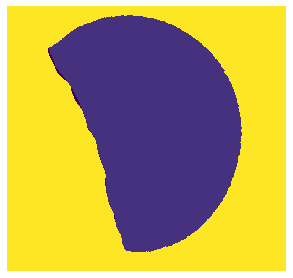

In [20]:
print(torch.max(image2tensor(mask)))
tfm = TargetMaskConvertTransform()
image2, mask2 = tfm.encodes((image, mask))
print(type(image), type(mask), type(image2), type(mask2))
print(torch.max(image2tensor(mask2)))
show_image(mask2)

In [21]:
for s in [ 'training', 'validation' ]:
        n = random.randint(0, len(env[s+'_images_fns'])-1)
        img_f = env[s+'_images_fns'][n]
        print(img_f)
        print(get_y_fn(img_f))

/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB/training/images/25_6-col.jpg
/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB/training/masks/25_6-col.png
/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB/validation/images/5_11-col.jpg
/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB/validation/masks/5_11-col.png


In [22]:
# double check the whole dataset to see if every pair (image, mask) is in place
missing_pairs = 0
for s in [ 'training', 'validation' ]:
        for img_fn in env[s+'_images_fns']:
            #print(str(img_fn) + ' -> ' + str(get_y_fn(img_fn)))
            if not img_fn.is_file() or not get_y_fn(img_fn).is_file():
                short_img_fn  = str(img_fn).replace(str(env["path"])+'/',"")
                short_mask_fn = str(get_y_fn(img_fn)).replace(str(env["path"])+'/',"")
                print(f'One between {short_img_fn} and {short_mask_fn} is missing!')
                missing_pairs += 1
                
print(f'A total of {missing_pairs} missing pairs were found...')

A total of 0 missing pairs were found...


# Learning Setup


In [23]:
env['segmentation_type'] = "Semantic Segmentation"
env['arch'] = "deeplabv3+"
env['backbone'] = "resnet152"
env['wd'] = 1e-4
env['n_classes'] = len(codes)

#env['num_workers'] = 0      # 20 min per epoch @ bs = 8
#env['num_workers'] = 8      # 12 min  per epoch @ bs = 8
env['num_workers'] = 16      # 10 min  per epoch @ bs = 8
#env['num_workers'] = 32     # 12 min  per epoch @ bs = 8

env['cmap']        = matplotlib.colors.LinearSegmentedColormap.from_list("", ['blue','red','green','black','magenta','yellow','pink','white'])

In [24]:
def is_frozen(learn, debug=False):
    for child in learn.model.children():
        if debug:
            print(child)
        for param in child.parameters():
            if debug:
                print(param.requires_grad)
            if param.requires_grad == False:
                return True, 'a', 'frozen'
    return False, 'b', 'unfrozen'

In [25]:
def show_hyperparams():
    dp_str = ''
    dv_ids = learn.model.device_ids if 'device_ids' in learn.model.__dict__ else ''
    if 'use_dataparallel' in env:
        dp_str = f' - device_ids: {dv_ids}, n_gpu: {torch.cuda.device_count()}'
    print(f'Batch size: {env["bs"]}, image size: {env["img_size"]}, learning rate: {env["lr"]}, round: {env["train_round"]}' + dp_str)

In [26]:
def get_save_fn(env, debug=False):
    part1 = env['project_name'] + '-' + env['arch'] + '-' + env['backbone'] + '-'
    part2 = env['data-augmentation'] + '-img_size-' + '-'.join(str(x) for x in env['img_size']) + '-'
    part3 = str(env['train_round']) + env['model_frozen_letter']+ '-' + env['launch_time']
    part4 = '-' + 'WD-' + str(env['wd']) + '-' + 'BS-' + str(env['bs']) + '-'
    part5 = 'LR-' + (str(env['lr'].start) + '-' + str(env['lr'].stop) if type(env['lr']) is slice else str(env['lr']))
    env['save_fn'] = part1 + part2 + part3 + part4 + part5   # at the third unspecified error on a four-lines long instruction, one gives up with the one-linearism
    if debug:
        print(f'save_fn = {env["save_fn"]}')
    return 

In [27]:
class SaveBestAccuracyCallback(TrackerCallback):
    def __init__(self, monitor='accuracy', save_str:str='best-accuracy-model'):
        super().__init__(monitor=monitor) #, reset_on_fit=True)
        #self.prev_acc = 0.0
        self.save_str = save_str
        
    def after_epoch(self):
        super().after_epoch()
        if self.new_best:
            print(f'Better model found at epoch {self.epoch} with {self.monitor} value: {self.best}.')
            self.save(f'{self.save_str}-epoch-{self.epoch}-{self.monitor}-{self.best:.4f}')

In [28]:
def fit_one_cycle(env, learn, epochs):
    get_save_fn(env, debug=True)
    
    monitor_training   = env['monitor_training']
    comp_training      = env['comp_training']

    monitor_evaluating = env['monitor_evaluating']
    comp_evaluating    = env['comp_evaluating']

    patience           = env['patience']
    
    callbacks = [
        ShowGraphCallback(),
        EarlyStoppingCallback(monitor=monitor_training, comp=comp_training, patience=patience),
        SaveModelCallback(monitor=monitor_training, comp=comp_training, every_epoch=False, fname=env['save_fn']+'-best'),
        SaveBestAccuracyCallback(monitor=monitor_training, save_str=env['save_fn'])
        ]
    
    if env['use_dataparallel']:
        n_gpu = torch.cuda.device_count()
        ctx = learn.parallel_ctx if n_gpu else None
        gpu = None
        
        with partial(ctx, gpu)():
            print(f"Training in {ctx.__name__} context on GPU {list(range(n_gpu))}")
            learn.fit_one_cycle(epochs, env['lr'], cbs=callbacks)
        !nvidia-smi
    else:    
        learn.fit_one_cycle(epochs, env['lr'], cbs=callbacks)
        
    learn.show_results(max_n=16, figsize=(40,40), ncols=4, nrows=4, vmin=0, vmax=env['n_classes']-1, cmap=env['cmap'])

In [29]:
import sklearn.metrics as skm
import sklearn.metrics._classification as skmc

'''
**********************************************************************************
** Here we split Scikit Learn precision_recall_fscore_support() function in two **
** parts. The first one takes preds and targets for each batch and gives the *****
** confusion matrix for the batch. The accumulate() function sums up all the *****
** confusion matrices, at the end of the validation step, the value() function ***
** calls the second part of precision_recall_fscore_support() function and *******
** computes precision/recall/f-score/support all at once.
**********************************************************************************
'''

def precision_recall_fscore_support_part_one(y_true, y_pred, beta=1.0, labels=None,
                                    pos_label=1, average=None,
                                    warn_for=('precision', 'recall', 'f-score'),
                                    sample_weight=None,
                                    zero_division="warn"):
    '''
    Given y_true, y_pred (of any kind, even segmentation masks), returns the
    Multiclass Confusion Matrix. In segmentation tasks, you can pass the whole
    dataset's y_true, y_pred (uncompressed masks of thousands of images), so
    this function has to be called for each validation batch.
    '''
    skmc._check_zero_division(zero_division)
    if beta < 0:
        raise ValueError("beta should be >=0 in the F-beta score")
    labels = skmc._check_set_wise_labels(y_true, y_pred, average, labels, pos_label)

    # Calculate tp_sum, pred_sum, true_sum ###
    samplewise = average == 'samples'
    partial_MCM = skm.multilabel_confusion_matrix(y_true, y_pred,
                                      sample_weight=sample_weight,
                                      labels=labels, samplewise=samplewise)
    return partial_MCM


def precision_recall_fscore_support_part_two(MCM, beta=1.0, labels=None,
                                    pos_label=1, average=None,
                                    warn_for=('precision', 'recall', 'f-score'),
                                    sample_weight=None,
                                    zero_division="warn"):
    tp_sum = MCM[:, 1, 1]
    pred_sum = tp_sum + MCM[:, 0, 1]
    true_sum = tp_sum + MCM[:, 1, 0]

    if average == 'micro':
        tp_sum = np.array([tp_sum.sum()])
        pred_sum = np.array([pred_sum.sum()])
        true_sum = np.array([true_sum.sum()])

    # Finally, we have all our sufficient statistics. Divide! #
    beta2 = beta ** 2

    # Divide, and on zero-division, set scores and/or warn according to
    # zero_division:
    precision = skmc._prf_divide(tp_sum, pred_sum, 'precision', 'predicted', average, warn_for, zero_division)
    recall = skmc._prf_divide(tp_sum, true_sum, 'recall', 'true', average, warn_for, zero_division)
    
    # warn for f-score only if zero_division is warn, it is in warn_for
    # and BOTH prec and rec are ill-defined
    if zero_division == "warn" and ("f-score",) == warn_for:
        if (pred_sum[true_sum == 0] == 0).any():
            skmc._warn_prf(average, "true nor predicted", 'F-score is', len(true_sum))

    # if tp == 0 F will be 1 only if all predictions are zero, all labels are
    # zero, and zero_division=1. In all other case, 0
    if np.isposinf(beta):
        f_score = recall
    else:
        denom = beta2 * precision + recall

        denom[denom == 0.] = 1  # avoid division by 0
        f_score = (1 + beta2) * precision * recall / denom

    # Average the results
    if average == 'weighted':
        weights = true_sum
        if weights.sum() == 0:
            zero_division_value = 0.0 if zero_division in ["warn", 0] else 1.0
            # precision is zero_division if there are no positive predictions
            # recall is zero_division if there are no positive labels
            # fscore is zero_division if all labels AND predictions are
            # negative
            return (zero_division_value if pred_sum.sum() == 0 else 0,
                    zero_division_value,
                    zero_division_value if pred_sum.sum() == 0 else 0,
                    None)

    elif average == 'samples':
        weights = sample_weight
    else:
        weights = None

    if average is not None:
        assert average != 'binary' or len(precision) == 1
        precision = np.average(precision, weights=weights)
        recall = np.average(recall, weights=weights)
        f_score = np.average(f_score, weights=weights)
        true_sum = None  # return no support

    return precision, recall, f_score, true_sum


mk_class('ActivationType', **{o:o.lower() for o in ['No', 'Sigmoid', 'Softmax', 'BinarySoftmax']},
         doc="All possible activation classes for `AccumMetric")

class PrecisionRecallAUCROCMulticlass(Metric):
    "Helper function for calculating Averaged Precision/Recall/Area Under the Receiver Operating Characteristic Curve (AUC-ROC) metrics for multiclass target in segmentation"
    def __init__(self, skm_metric=skm.precision_score, axis=1): self.axis,self.skm_metric = axis,skm_metric
    def reset(self): self.metric, self.learn = {}, None
    def accumulate(self, learn):
        self.learn = learn
        pred,targ  = flatten_check(learn.pred.argmax(dim=self.axis), learn.y)
        activation = ActivationType.Sigmoid if sigmoid else ActivationType.No
        
        if self.skm_metric == skm.roc_auc_score:
            self.metric = skm_to_fastai(self.skm_metric, axis=self.axis, thresh=None, activation=activation, flatten=True,
                                 labels=None, multi_class='ovo', average='macro', sample_weight=None)
        else:
            self.metric = skm_to_fastai(self.skm_metric, axis=self.axis, thresh=None, activation=activation, flatten=True,
                                 labels=None, pos_label=1,       average='macro', sample_weight=None)

    @property
    def name(self): return self.skm_metric.__name__
    @property
    def value(self):
        pred,targ  = flatten_check(self.learn.pred.argmax(dim=self.axis), self.learn.y)
        metric = self.metric(pred,targ)
        print(f'metric.shape = {metric.shape} - metric = {metric}')
        return metric

In [30]:
f1score = precision = recall = support = None

class MulticlassPrecisionRecallFScoreSupport(Metric):
    "Macro F1 Score/Precision/Recall/Support metrics for multiclass target in segmentation problems. Confusion matrix is accumulated batch by batch using sklearn modified code."
    def __init__(self, axis=1, metric='f-score', debug=False): self.axis, self.debug, self.metric = axis, debug, metric    # 'fscore', 'precision', 'recall', 'support'
    def reset(self): self.MCM, self.counter = None, 0
    def accumulate(self, learn):
        if self.isfscore():
            self.learn  = learn
            pred,targ   = flatten_check(learn.pred.argmax(dim=self.axis), learn.y)
            y_true      = targ.cpu().numpy()
            y_pred      = pred.cpu().numpy()
            partial_MCM = precision_recall_fscore_support_part_one(y_true, y_pred, beta=1.0,      # builds the partial Multiclass Confusion Matrix for the current validation batch
                                                               labels=None, pos_label=1,
                                                               average='macro',
                                                               warn_for=('precision', 'recall', 'f-score'),
                                                               sample_weight=None, zero_division="warn")
        
            if self.debug:
                print(f'{self.__class__.__name__} - {self.metric} - accumulate() batch: {self.counter} -> partial MCM: {partial_MCM}')
        
            if self.MCM is None:
                self.MCM = partial_MCM
            else:
                self.MCM += partial_MCM

            if self.debug:
                print(self.counter, self.MCM)
        else:
            if self.debug:
                print(f'{self.__class__.__name__} - {self.metric} - skipping accumulate() batch: {self.counter}')
        self.counter += 1
    
    def isfscore(self):
        return self.metric.replace('-','').replace('_','') == 'fscore' or self.metric.replace('-','').replace('_','') == 'f1score'
    @property
    def name(self): return self.metric
    @property
    def value(self):
        global f1score, precision, recall, support
        if self.isfscore():
            if self.debug:
                print(f'{self.__class__.__name__} - {self.metric} - value() n_batch: {self.counter} -> partial MCM: {self.MCM}')
            p, r, f1, s = precision_recall_fscore_support_part_two(self.MCM, beta=1.0,
                                                                   labels=None, pos_label=1,
                                                                   average='macro',
                                                                   warn_for=('precision', 'recall', 'f-score'),
                                                                   sample_weight=None, zero_division="warn")
            precision, recall, f1score, support = p, r, f1, s
        else:
            if self.debug:
                print(f'{self.__class__.__name__} - {self.metric} - value() n_batch: {self.counter} -> using p, r, f1, s precomputed values: {precision} - {recall} - {f1score} - {support}')

        if self.isfscore():
            metric_value = f1score
        elif self.metric == 'precision':
            metric_value = precision
        elif self.metric == 'recall':
            metric_value = recall
        elif self.metric == 'support':
            metric_value = support
        else:
            metric_value = float('nan')
        return metric_value

In [31]:
class PILMask(PILBase): _open_args,_show_args = {'mode':'RGB'},{'alpha':0.5}
PILMask._open_args = {'mode':'RGB'}
OpenMask = Transform(PILMask.create)
OpenMask.loss_func = CrossEntropyLossFlat(axis=1)
PILMask.create = OpenMask
PILMask._tensor_cls = TensorMask

def MaskBlock(codes=None):
    "A `TransformBlock` for segmentation masks, potentially with `codes`"
    return TransformBlock(type_tfms=PILMask.create, item_tfms=AddMaskCodes(codes=codes), batch_tfms=IntToFloatTensor)

def init_learner(env):
    env['img_size']    = [int(x / 2) for x in env['orig_img_size']]
    env['bs']          = 8
       
    db = DataBlock(blocks=(ImageBlock, MaskBlock(codes)),
                   get_items=partial(get_x_fns, folders=['training', 'validation']),
                   get_y=get_y_fn,
                   splitter=FuncSplitter(ValidGrandParentSplitter),
                   item_tfms=[Resize(env['img_size']), TargetMaskConvertTransform()],
                   batch_tfms=Normalize.from_stats(*imagenet_stats)
                  )
    db.summary(env['path'])
    dls = db.dataloaders(env['path'], bs=env['bs'], num_workers=env['num_workers'])
    dls.show_batch(figsize=(8, 8), vmin=0, vmax=env['n_classes']-1, cmap=env['cmap'])

    metrics = [surfpatt_metric, # DiceMulti(),
               MulticlassPrecisionRecallFScoreSupport(metric='f-score'),
               MulticlassPrecisionRecallFScoreSupport(metric='precision'),
               MulticlassPrecisionRecallFScoreSupport(metric='recall'),
              ]
    
    learn = get_segmentation_learner(dls=dls, number_classes=env['n_classes'], segmentation_type=env['segmentation_type'],
                                 architecture_name=env['arch'], backbone_name=env['backbone'], 
                                 metrics=metrics, wd=env['wd'],
                                 splitter=segmentron_splitter).to_fp16()
    learn.freeze() # Freezing the backbone
    return learn

Setting-up type transforms pipelines
Found 1821 items
2 datasets of sizes 1290,531
Setting up Pipeline: PILBase.create
Setting up Pipeline: get_y_fn -> PILBase.create

Building one sample
  Pipeline: PILBase.create
    starting from
      /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB/training/images/11_79-col.jpg
    applying PILBase.create gives
      PILImage mode=RGB size=1585x1502
  Pipeline: get_y_fn -> PILBase.create
    starting from
      /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB/training/images/11_79-col.jpg
    applying get_y_fn gives
      /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB/training/masks/11_79-col.png
    applying PILBase.create gives
      PILMask mode=RGB size=1585x1502

Final sample: (PILImage mode=RGB size=1585x1502, PILMask mode=RGB size=1585x1502)


Found 1821 items
2 datasets of sizes 1290,531
Se

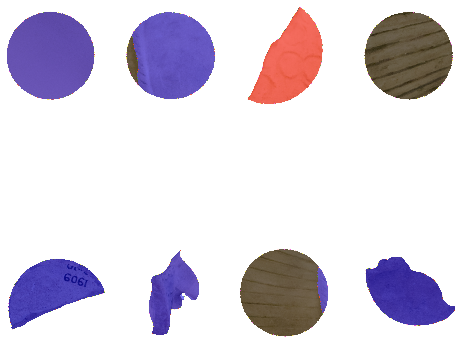

In [32]:
learn = init_learner(env)

In [33]:
import os
def reload_best_model(learn, prefix, debug=False):
    model_dir = learn.path.absolute() / learn.model_dir
    print(f'Looking for {prefix}-*-best models in: {model_dir}')
    print(20*'-')
    files = model_dir.glob(f'{prefix}*-best.pth')
    files = sorted(files, key=os.path.getmtime)
    for i in files:
        print(i)
    print(20*'-')
    print(f'Reloading {i}')
    learn.load(str(i).replace('.pth', ''))
    metrics = learn.validate()
    if debug:
        print(f'learn.metrics: {learn.metrics}')
        for idx, this_metric in enumerate(learn.metrics):
            print(f'this_metric.name: {this_metric.name}')
        print(f'metrics: {metrics}')
    for idx, metric_score in enumerate(metrics):
        if idx != 0:
            metric_str = str(learn.metrics[idx-1].name)
            print(f'{idx} - {metric_str} = {metric_score}')
        else:
            print(f'{idx} - valid_loss = {metric_score}')

In [34]:
def garbage_collect():
    import gc
    gc.collect()
    torch.cuda.empty_cache()

In [35]:
def test_albumentation_transforms(which_pipeline):
    for s in [ 'training', 'validation' ]:
            n = random.randint(0, len(env[s+'_images_fns'])-1)
            img_f = env[s+'_images_fns'][n]
            image = PILImage.create(img_f)
            print(img_f, image.size)
            mask_f = env[s+'_masks_fns'][n]
            mask = PILImage.create(mask_f)
            print(mask_f, mask.size)
            augimg, augmask = which_pipeline.encodes((image, mask))

            #subplot(r,c) provide the no. of rows and columns
            f, axarr = plt.subplots(1,4,figsize=(15,5)) 

            # use the created array to output your multiple images. In this case I have stacked 4 images vertically
            axarr[0].imshow(image)
            axarr[1].imshow(augimg)
            axarr[2].imshow(mask)
            axarr[3].imshow(augmask)

/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB/training/images/18_10-col.jpg (1585, 1502)
/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB/training/masks/18_10-col.png (1585, 1502)
/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB/validation/images/4_117-col.jpg (1585, 1502)
/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB/validation/masks/4_117-col.png (1585, 1502)


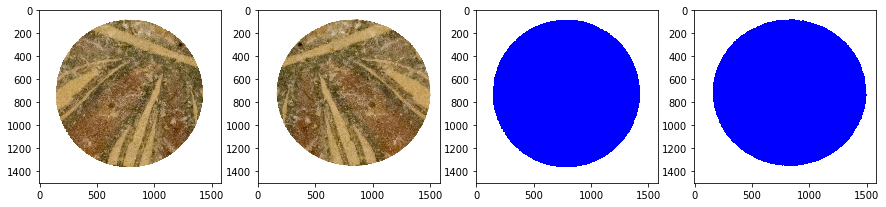

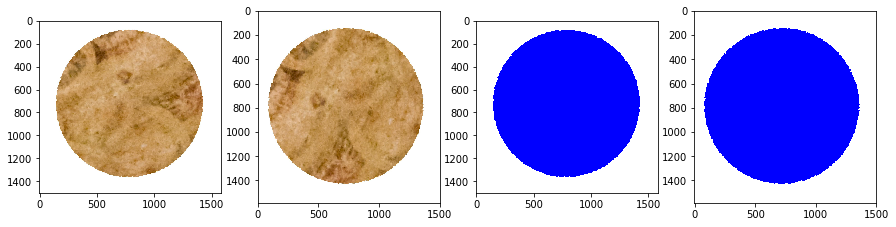

In [36]:
test_albumentation_transforms(basicTransformPipeline)

/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB/training/images/15_23-col.jpg (1585, 1502)
/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB/training/masks/15_23-col.png (1585, 1502)
/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB/validation/images/2_8-col.jpg (1585, 1502)
/var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB/validation/masks/2_8-col.png (1585, 1502)


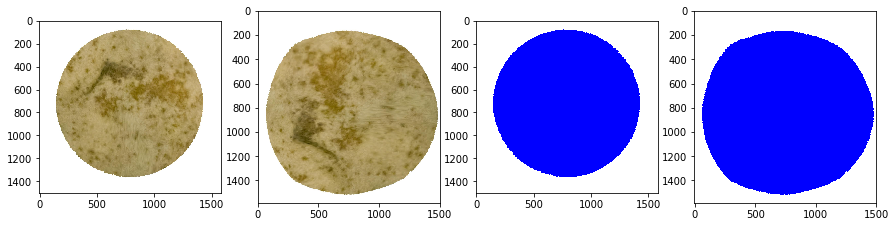

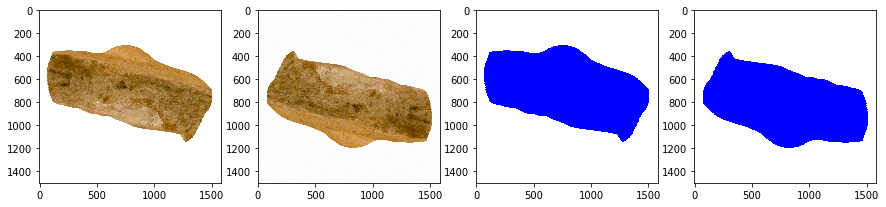

In [37]:
test_albumentation_transforms(strongTransformPipeline)

In [38]:
env['img_size_div'] = [1]
env['batch_sizes']  = [8]

# Define training ground functions

In [39]:
def next_round(env):
    env['train_round'] += 1
    env['img_size']     = [int(env['orig_img_size'][0] / env['img_size_div'][env['train_round']-1])] * 2     
    env['bs']           = env['batch_sizes'][env['train_round']-1]

In [40]:
def alloc_datablock(env, splitter=ValidGrandParentSplitter, training_dir='training', valid_dir='validation'):
    if env['data-augmentation'] == 'no-data-aug':
        print('---------------------------------')
        print('Running with no data augmentation')
        print('---------------------------------')
        item_tfms=[Resize(env['img_size']), TargetMaskConvertTransform()]
    elif env['data-augmentation'] == 'basic-data-aug':
        print('------------------------------------')
        print('Running with basic data augmentation')
        print('------------------------------------')
        item_tfms=[Resize(env['img_size']), TargetMaskConvertTransform(), basicTransformPipeline]
    elif env['data-augmentation'] == 'strong-data-aug':
        print('-------------------------------------')
        print('Running with strong data augmentation')
        print('-------------------------------------')
        item_tfms=[Resize(env['img_size']), TargetMaskConvertTransform(), strongTransformPipeline]
    db = DataBlock(blocks=(ImageBlock, MaskBlock(codes)),
                   get_items=partial(get_x_fns, folders=[training_dir, valid_dir]),
                   get_y=get_y_fn,
                   splitter=FuncSplitter(splitter),
                   item_tfms=item_tfms,
                   batch_tfms=Normalize.from_stats(*imagenet_stats)
                  )
    db.summary(env['path'])
    dls = db.dataloaders(env['path'], bs=env['bs'], num_workers=env['num_workers'])
    dls.show_batch(max_n=16, figsize=(40,40), ncols=4, nrows=4, vmin=0, vmax=env['n_classes']-1, cmap=env['cmap'])
    return dls

In [41]:
def do_lr_find_impl(env, learn):
    if env['use_dataparallel']:
        n_gpu = torch.cuda.device_count()
        ctx = learn.parallel_ctx if n_gpu else None
        gpu = None
        
        with partial(ctx, gpu)():
            print(f"LR_finding in {ctx.__name__} context on GPU {list(range(n_gpu))}")
            suggested_lrs = learn.lr_find() # find learning rate
            
        !nvidia-smi
    else:
        suggested_lrs = learn.lr_find()     # find learning rate
    
    learn.recorder                          # plot learning rate graph
    print(f'Suggested LRs: {suggested_lrs}')
    if suggested_lrs is None:
        suggested_lrs = [1e-4, 1e-4]
    return suggested_lrs

In [42]:
def do_lr_find(env, learn, dls):
    learn.dls = dls
    learn.freeze()
    return do_lr_find_impl(env, learn)

In [43]:
def set_lr(env, learn, suggested_lrs):
    # lr_min is the minimum value in the curve plotted by lr_find()   -> this means that it may be 1e-1 or even 1e0 so it's actually 10x or even 100x the "reasonable" lr_max
    # lr_steep is the x coord of the plot where the slope is steepest -> this means that it may be 1e-2 or so, so it's a reasonable value for actual lr_max
    lr_min = min(suggested_lrs[1]/100, 1e-2)
    lr_max = min(suggested_lrs[1]/10,  5e-2)
    lr_min = max(lr_min, 1e-4)
    lr_max = max(lr_max, 1e-3)
    print(f'Setting LRs to: slice({lr_min}, {lr_max})')
    env['lr'] = slice(lr_min, lr_max)
    model_frozen, env['model_frozen_letter'], env['model_frozen_str '] = is_frozen(learn, debug=False)
    get_save_fn(env, debug=True)
    show_hyperparams()

In [44]:
def train_model(env, learn, epochs=10):
    fit_one_cycle(env, learn, epochs=epochs)
    reload_best_model(learn, '-'.join(env['save_fn'].split('-')[:4]))

In [45]:
def do_lr_find_unfreeze(env, learn):
    learn.unfreeze()
    return do_lr_find_impl(env, learn)

In [46]:
def set_lr_unfreeze(env, learn, suggested_lrs):
    lr_min = min(suggested_lrs[1]/100, 1e-5)
    lr_max = min(suggested_lrs[1]/10,  1e-4)
    lr_min = max(lr_min, 1e-7)
    lr_max = max(lr_max, 1e-6)
    print(f'Setting LRs to: slice({lr_min}, {lr_max})')
    env['lr'] = slice(lr_min, lr_max)
    model_frozen, env['model_frozen_letter'], env['model_frozen_str '] = is_frozen(learn, debug=False)
    get_save_fn(env, debug=True)
    show_hyperparams()

In [47]:
def train_model_unfreeze(env, learn, epochs=10):
    fit_one_cycle(env, learn, epochs=epochs)
    reload_best_model(learn, '-'.join(env['save_fn'].split('-')[:4]))

In [48]:
def do_training_round (env, learn, epochs=10):
    next_round(env)
    dls = alloc_datablock(env)
    
    suggested_lrs = do_lr_find(env, learn, dls)
    set_lr(env, learn, suggested_lrs)
    train_model(env, learn, epochs=epochs)
                
    suggested_lrs = do_lr_find_unfreeze(env, learn)
    set_lr_unfreeze(env, learn, suggested_lrs)
    train_model_unfreeze(env, learn, epochs=epochs)

In [49]:
def show_results(env, learn):
    learn.show_results(max_n=16, figsize=(40,40), ncols=4, nrows=4, vmin=0, vmax=env['n_classes']-1, cmap=env['cmap'])

In [50]:
learn.model

DeepLabV3Plus(
  (backbone): ResNetV1(
    (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): BottleneckV1b(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample): Sequential

# No data Aug


## Round 1

In [51]:
env['train_round']       = 0
env['data-augmentation'] = 'no-data-aug'

---------------------------------
Running with no data augmentation
---------------------------------
Setting-up type transforms pipelines
Found 1821 items
2 datasets of sizes 1290,531
Setting up Pipeline: PILBase.create
Setting up Pipeline: get_y_fn -> PILBase.create

Building one sample
  Pipeline: PILBase.create
    starting from
      /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB/training/images/11_79-col.jpg
    applying PILBase.create gives
      PILImage mode=RGB size=1585x1502
  Pipeline: get_y_fn -> PILBase.create
    starting from
      /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB/training/images/11_79-col.jpg
    applying get_y_fn gives
      /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB/training/masks/11_79-col.png
    applying PILBase.create gives
      PILMask mode=RGB size=1585x1502

Final sample: (PILImage mode=R

Wed Sep 22 16:32:08 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 450.80.02    Driver Version: 450.80.02    CUDA Version: 11.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla V100-PCIE...  On   | 00000000:5E:00.0 Off |                    0 |
| N/A   43C    P0    45W / 250W |  30959MiB / 32510MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
|   1  Tesla V100-PCIE...  On   | 00000000:86:00.0 Off |                    0 |
| N/A   

epoch,train_loss,valid_loss,surfpatt_metric,f-score,precision,recall,time
0,0.709824,0.487219,0.000131,0.230068,0.386220,0.247868,11:32
1,0.500797,0.377883,0.041718,0.283059,0.593794,0.279153,11:32
2,0.411313,0.318488,0.160346,0.388328,0.688590,0.361508,11:36
3,0.374438,0.277870,0.285655,0.473534,0.645786,0.439299,11:36
4,0.333053,0.240211,0.383740,0.555279,0.634390,0.519764,11:36
5,0.335021,0.231718,0.363859,0.542008,0.626956,0.515478,11:34
6,0.323019,0.215574,0.397001,0.564625,0.797289,0.522963,11:36
7,0.301527,0.234076,0.446026,0.562506,0.614472,0.553531,11:35
8,0.295568,0.235910,0.500236,0.588653,0.697398,0.595962,11:36
9,0.279954,0.210859,0.355797,0.554937,0.757198,0.500292,11:36


Better model found at epoch 0 with valid_loss value: 0.4872188866138458.
Better model found at epoch 0 with valid_loss value: 0.4872188866138458.


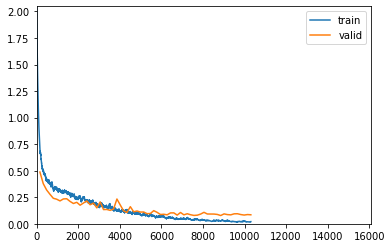

/local/ranieri/venvs/ml-local-node-10/lib64/python3.6/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Better model found at epoch 1 with valid_loss value: 0.37788334488868713.
Better model found at epoch 1 with valid_loss value: 0.37788334488868713.
Better model found at epoch 2 with valid_loss value: 0.3184882700443268.
Better model found at epoch 2 with valid_loss value: 0.3184882700443268.
Better model found at epoch 3 with valid_loss value: 0.2778698205947876.
Better model found at epoch 3 with valid_loss value: 0.2778698205947876.
Better model found at epoch 4 with valid_loss value: 0.24021072685718536.
Better model found at epoch 4 with valid_loss value: 0.24021072685718536.
Better model found at epoch 5 with valid_loss value: 0.23171843588352203.
Better model found at epoch 5 with valid_loss value: 0.23171843588352203.
Better model found at epoch 6 with valid_loss value: 0.21557435393333435.
Better model found at epoch 6 with valid_loss value: 0.21557435393333435.
Better model found at epoch 9 with valid_loss value: 0.2108590006828308.
Better model found at epoch 9 with valid_lo

Looking for SURFpatt_v3alpha-RGB-deeplabv3+-resnet152-*-best models in: /home/ranieri/notebooks/models
--------------------
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1a-2021-09-20_17.43.42-WD-0.0001-BS-8-LR-0.0015848932266235352-0.015848932266235353-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1b-2021-09-20_17.43.42-WD-0.0001-BS-8-LR-6.30957365501672e-08-6.30957365501672e-07-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB-deeplabv3+-resnet152-basic-data-aug-img_size-1585-1585-1a-2021-09-20_17.43.42-WD-0.0001-BS-8-LR-0.0007585775852203369-0.007585775852203369-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1a-2021-09-21_12.18.58-WD-0.0001-BS-8-LR-0.0027542285919189453-0.027542285919189453-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB-deeplabv3+-resnet152-no-data-aug-i

/local/ranieri/venvs/ml-local-node-10/lib64/python3.6/site-packages/fastai/learner.py:56: UserWarning: Saved filed doesn't contain an optimizer state.
  elif with_opt: warn("Saved filed doesn't contain an optimizer state.")


0 - valid_loss = 0.07790853083133698
1 - surfpatt_metric = 0.7428135871887207
2 - f-score = 0.8918912660581623
3 - precision = 0.8978517154491681
4 - recall = 0.8879773615664683
LR_finding in parallel_ctx context on GPU [0, 1]


Thu Sep 23 05:18:19 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 450.80.02    Driver Version: 450.80.02    CUDA Version: 11.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla V100-PCIE...  On   | 00000000:5E:00.0 Off |                    0 |
| N/A   43C    P0    45W / 250W |  30949MiB / 32510MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
|   1  Tesla V100-PCIE...  On   | 00000000:86:00.0 Off |                    0 |
| N/A   

epoch,train_loss,valid_loss,surfpatt_metric,f-score,precision,recall,time
0,0.026461,0.079704,0.740455,0.888915,0.901926,0.879481,12:09
1,0.025715,0.078604,0.728676,0.890172,0.907597,0.875908,12:09
2,0.023534,0.079063,0.740015,0.890137,0.902761,0.880158,12:08
3,0.025872,0.078068,0.731600,0.891251,0.907133,0.878883,12:08
4,0.025161,0.078675,0.738814,0.892623,0.898522,0.888151,12:10
5,0.025430,0.078377,0.739838,0.890670,0.903619,0.881168,12:11
6,0.023805,0.078537,0.742531,0.891416,0.896613,0.887818,12:09
7,0.021399,0.078428,0.749424,0.889664,0.897478,0.885062,12:09
8,0.025076,0.083305,0.750980,0.884743,0.881710,0.888764,12:11
9,0.021177,0.080515,0.749582,0.890001,0.891597,0.889492,12:10


Better model found at epoch 0 with valid_loss value: 0.0797036811709404.
Better model found at epoch 0 with valid_loss value: 0.0797036811709404.


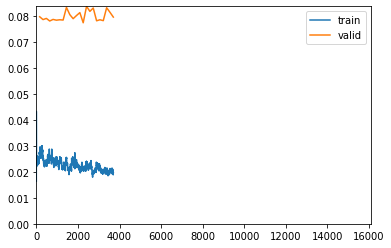

Better model found at epoch 1 with valid_loss value: 0.07860374450683594.
Better model found at epoch 1 with valid_loss value: 0.07860374450683594.
Better model found at epoch 3 with valid_loss value: 0.07806819677352905.
Better model found at epoch 3 with valid_loss value: 0.07806819677352905.
Better model found at epoch 13 with valid_loss value: 0.07738026976585388.
Better model found at epoch 13 with valid_loss value: 0.07738026976585388.
No improvement since epoch 13: early stopping
Thu Sep 23 10:11:07 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 450.80.02    Driver Version: 450.80.02    CUDA Version: 11.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M

Looking for SURFpatt_v3alpha-RGB-deeplabv3+-resnet152-*-best models in: /home/ranieri/notebooks/models
--------------------
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1a-2021-09-20_17.43.42-WD-0.0001-BS-8-LR-0.0015848932266235352-0.015848932266235353-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1b-2021-09-20_17.43.42-WD-0.0001-BS-8-LR-6.30957365501672e-08-6.30957365501672e-07-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB-deeplabv3+-resnet152-basic-data-aug-img_size-1585-1585-1a-2021-09-20_17.43.42-WD-0.0001-BS-8-LR-0.0007585775852203369-0.007585775852203369-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1a-2021-09-21_12.18.58-WD-0.0001-BS-8-LR-0.0027542285919189453-0.027542285919189453-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB-deeplabv3+-resnet152-no-data-aug-i

0 - valid_loss = 0.0773872658610344
1 - surfpatt_metric = 0.7536393404006958
2 - f-score = 0.8899723055367149
3 - precision = 0.8919447283798156
4 - recall = 0.8900488645583314


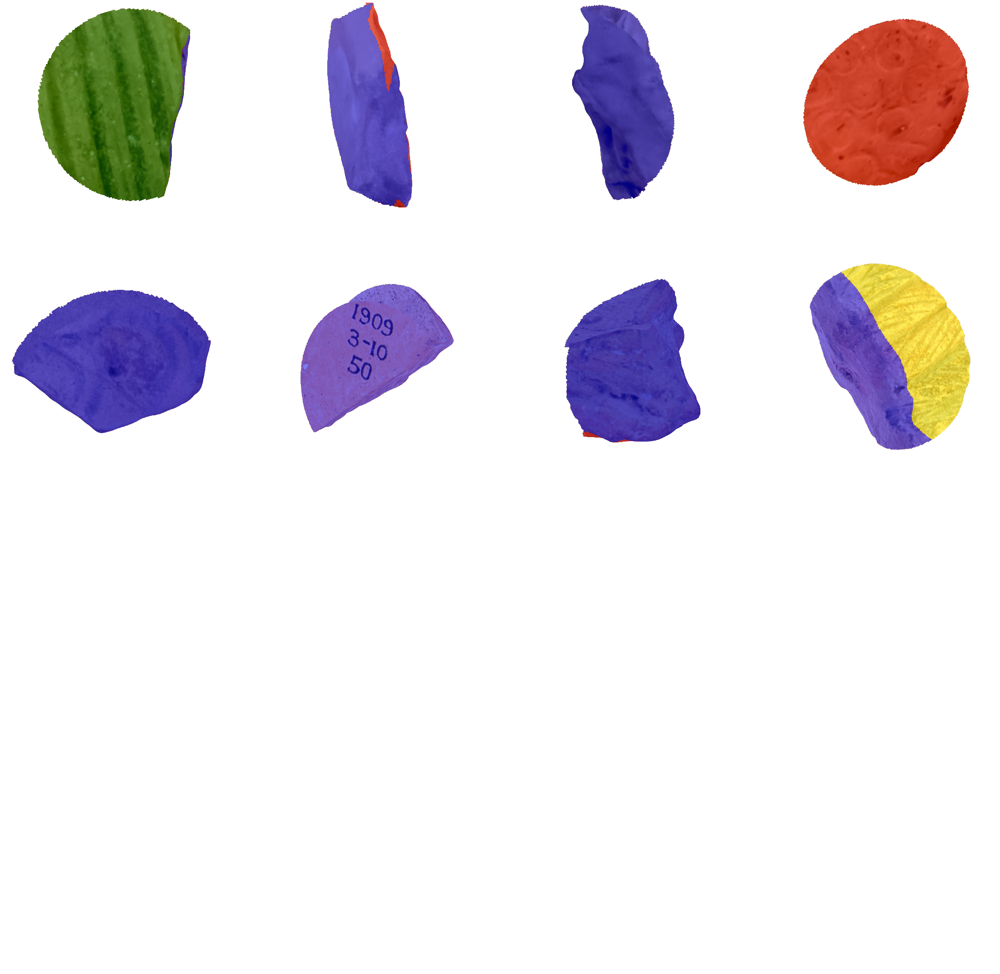

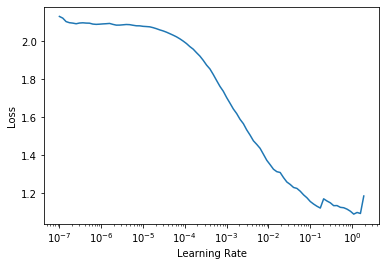

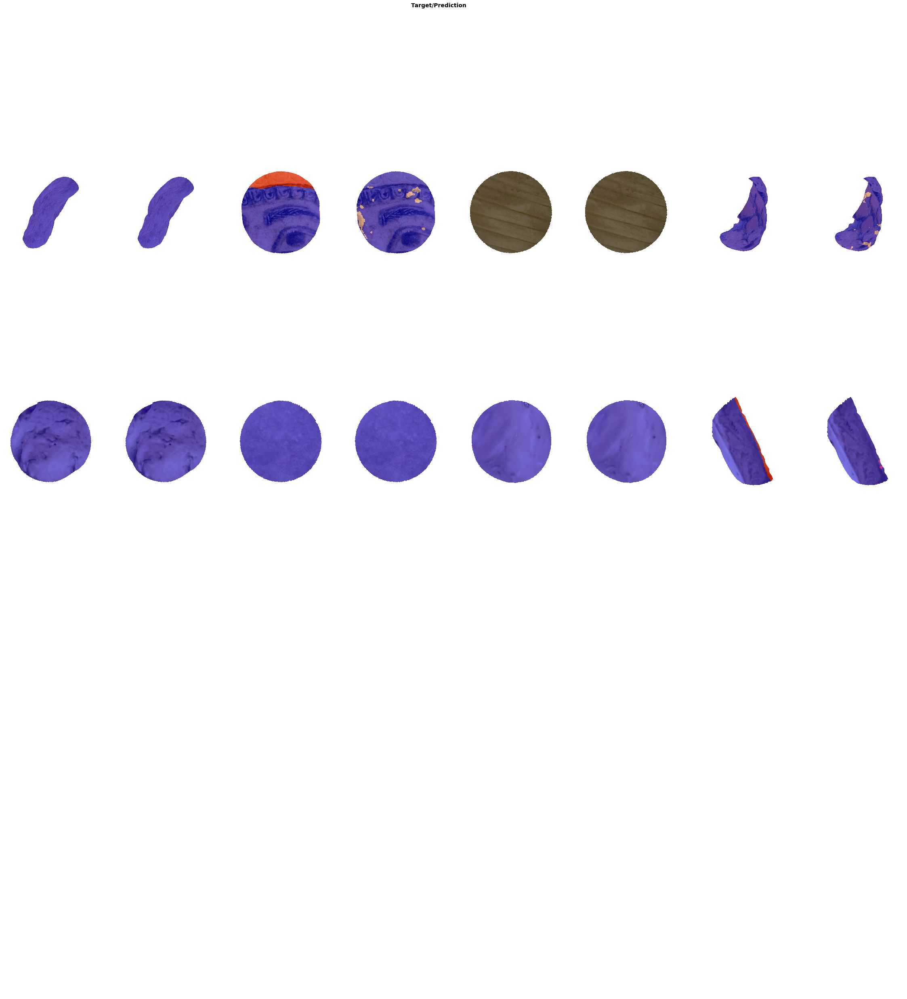

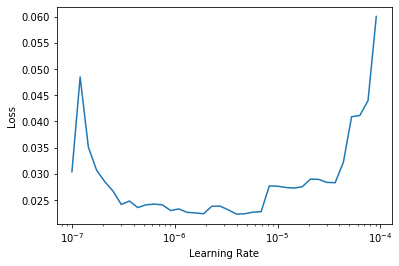

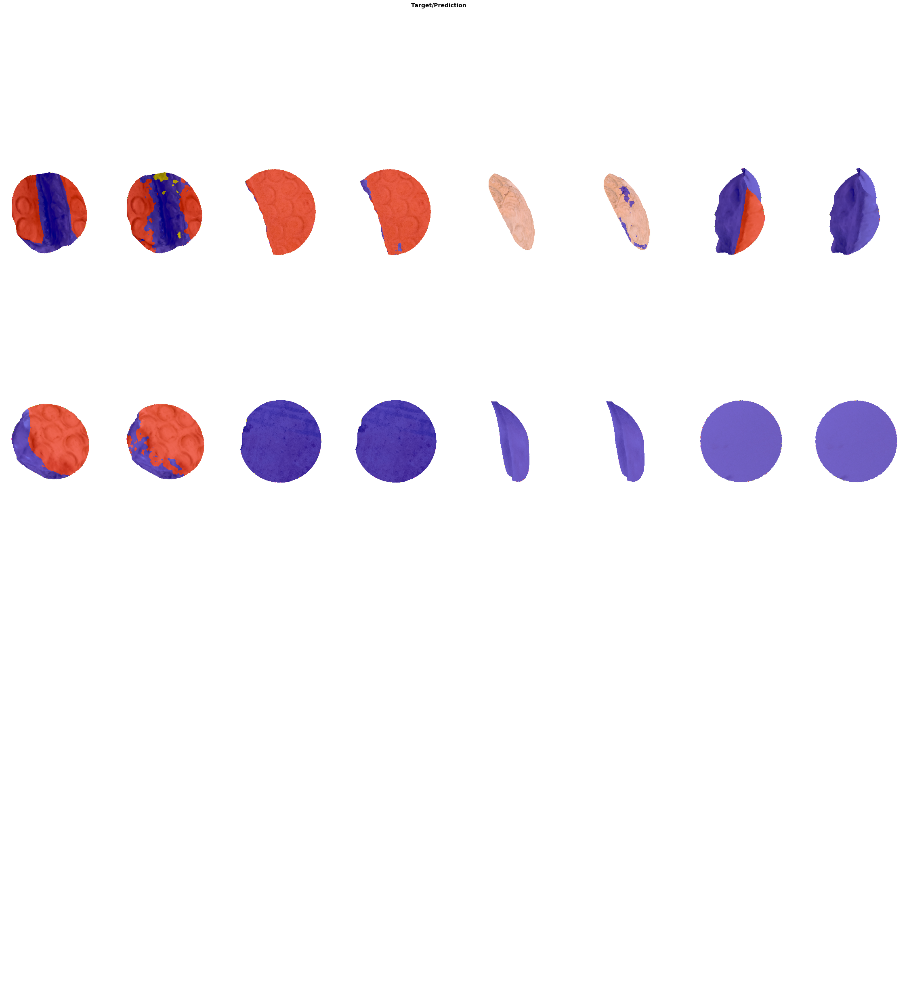

In [52]:
do_training_round(env, learn, epochs=100)

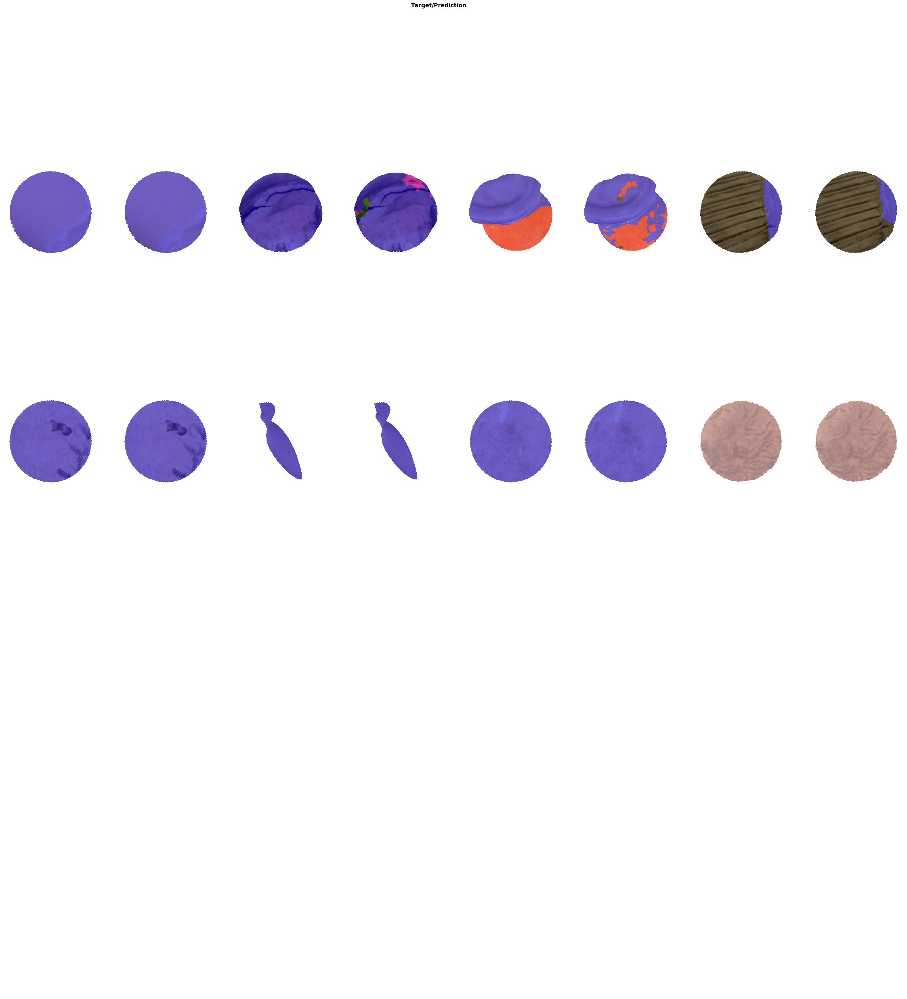

In [53]:
show_results(env, learn)

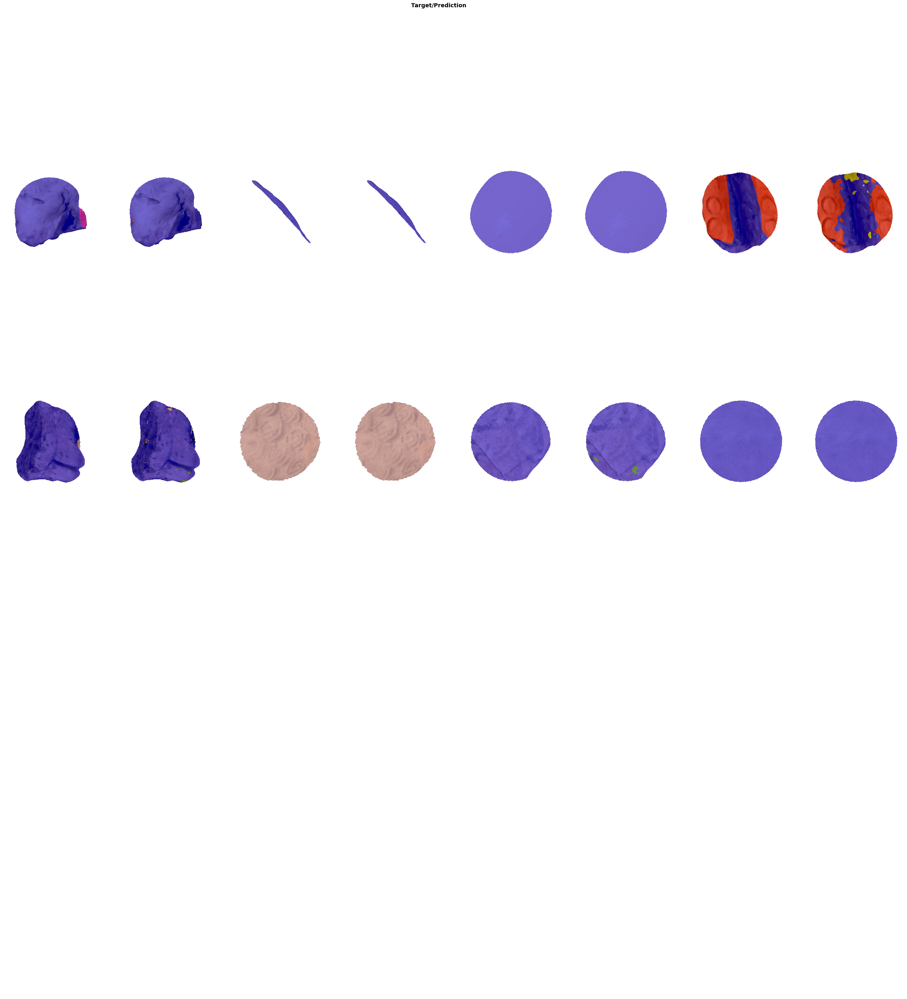

In [54]:
show_results(env, learn)

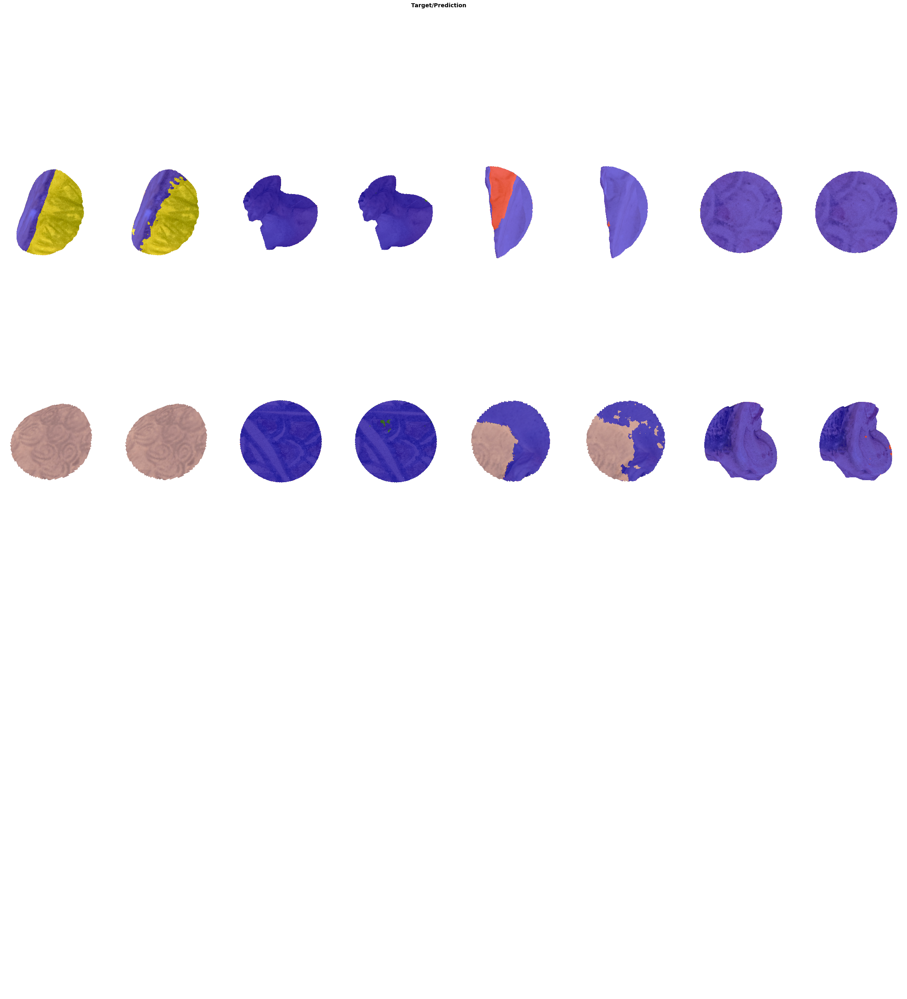

In [55]:
show_results(env, learn)

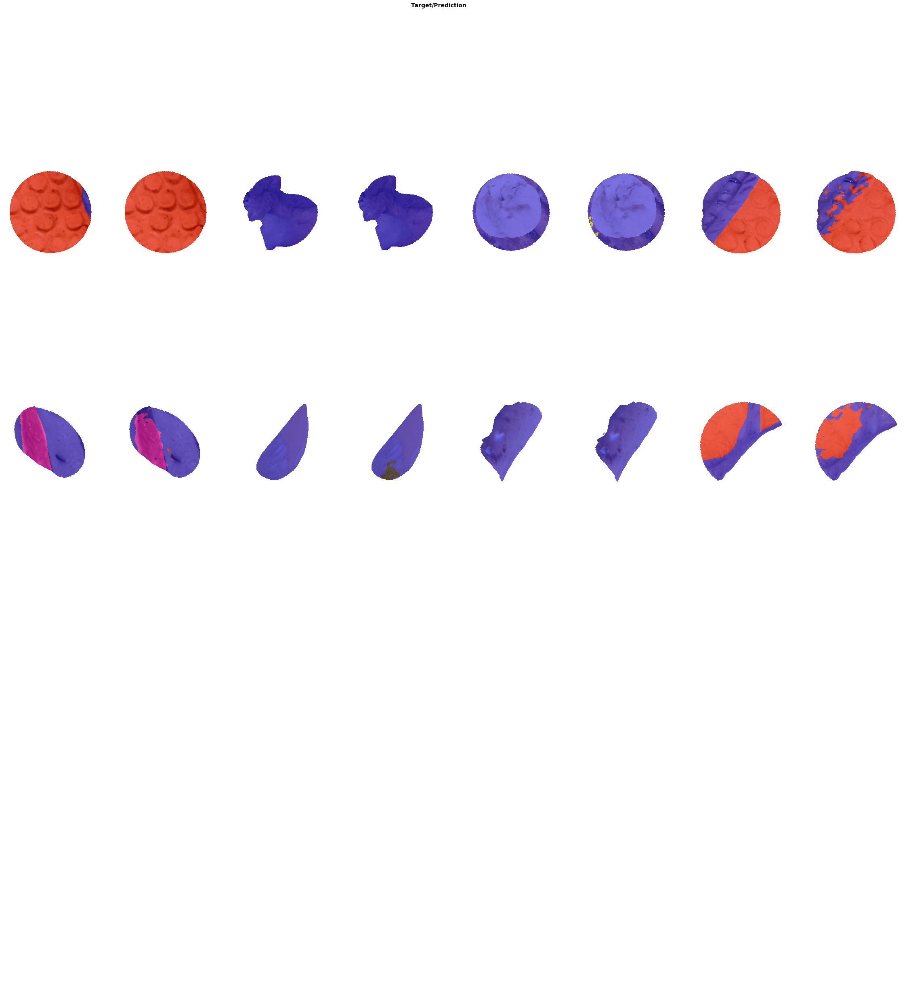

In [56]:
show_results(env, learn)

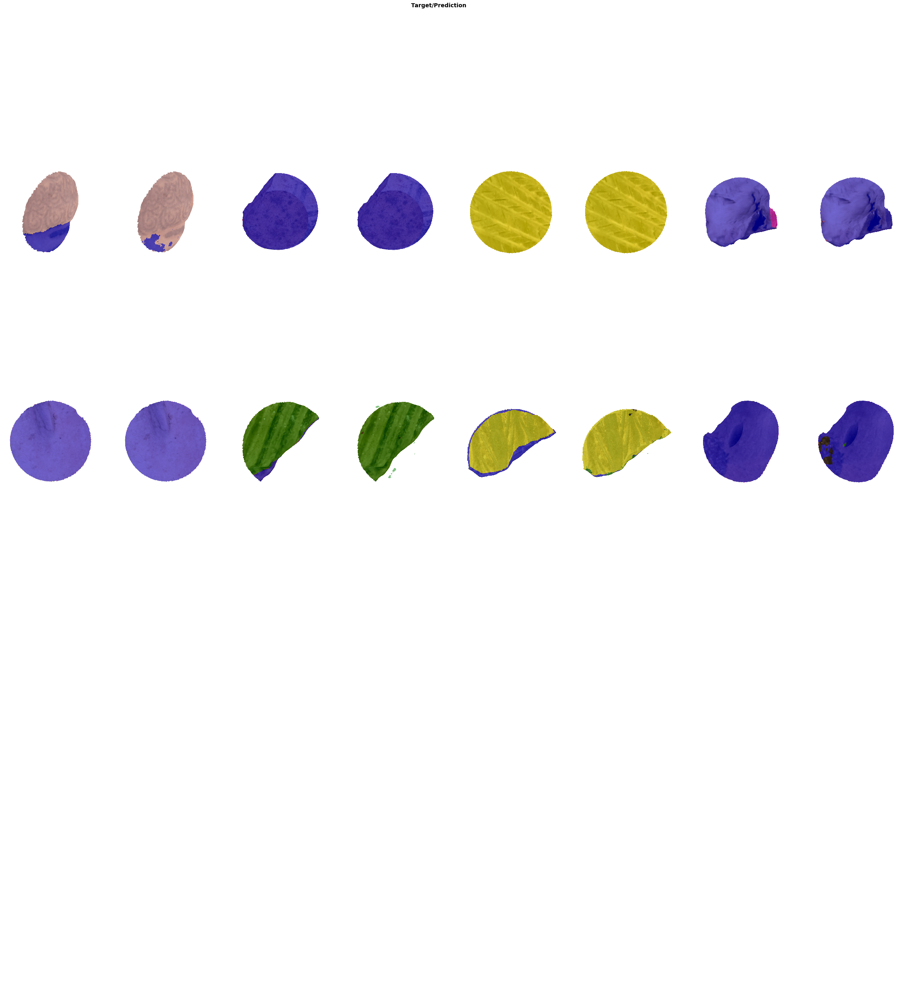

In [57]:
show_results(env, learn)

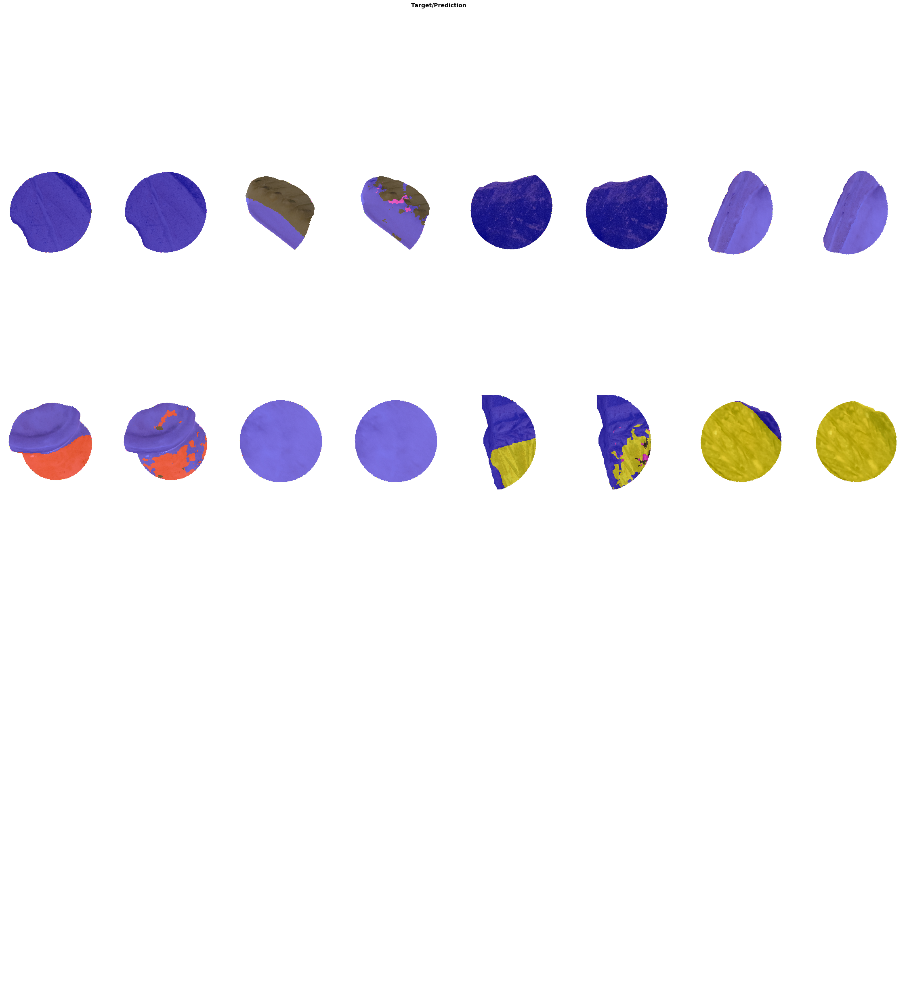

In [58]:
show_results(env, learn)

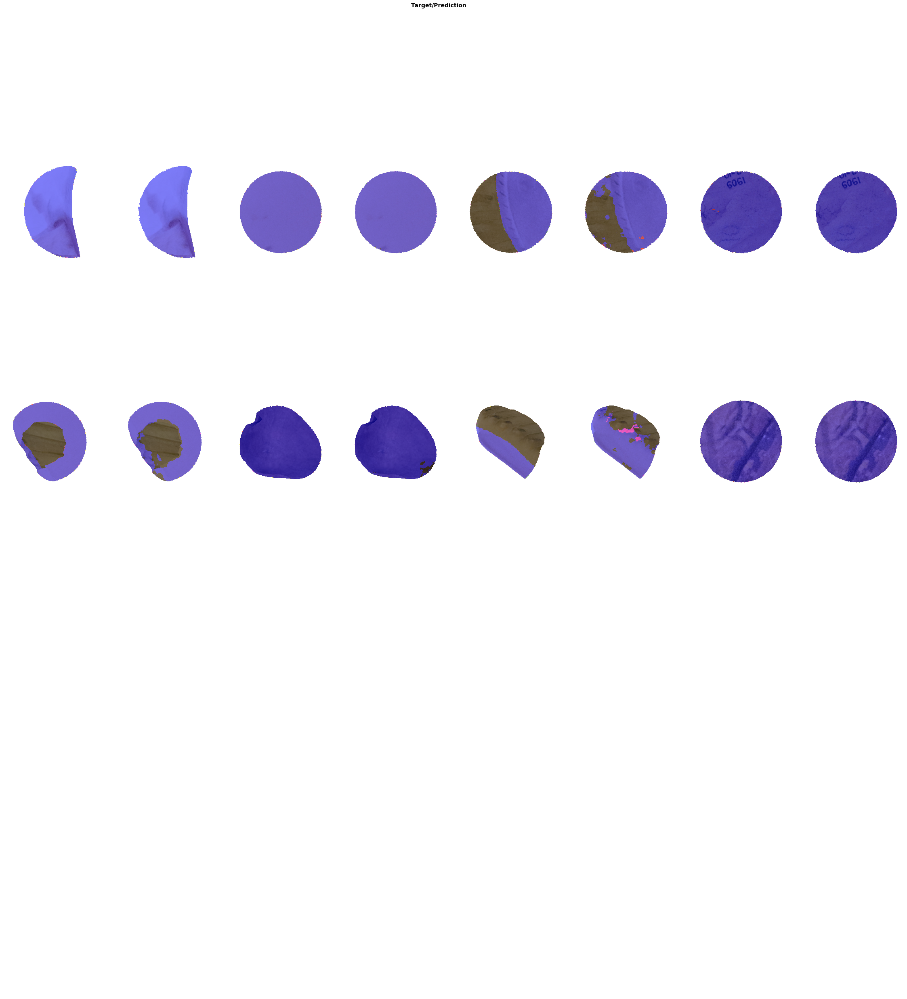

In [59]:
show_results(env, learn)

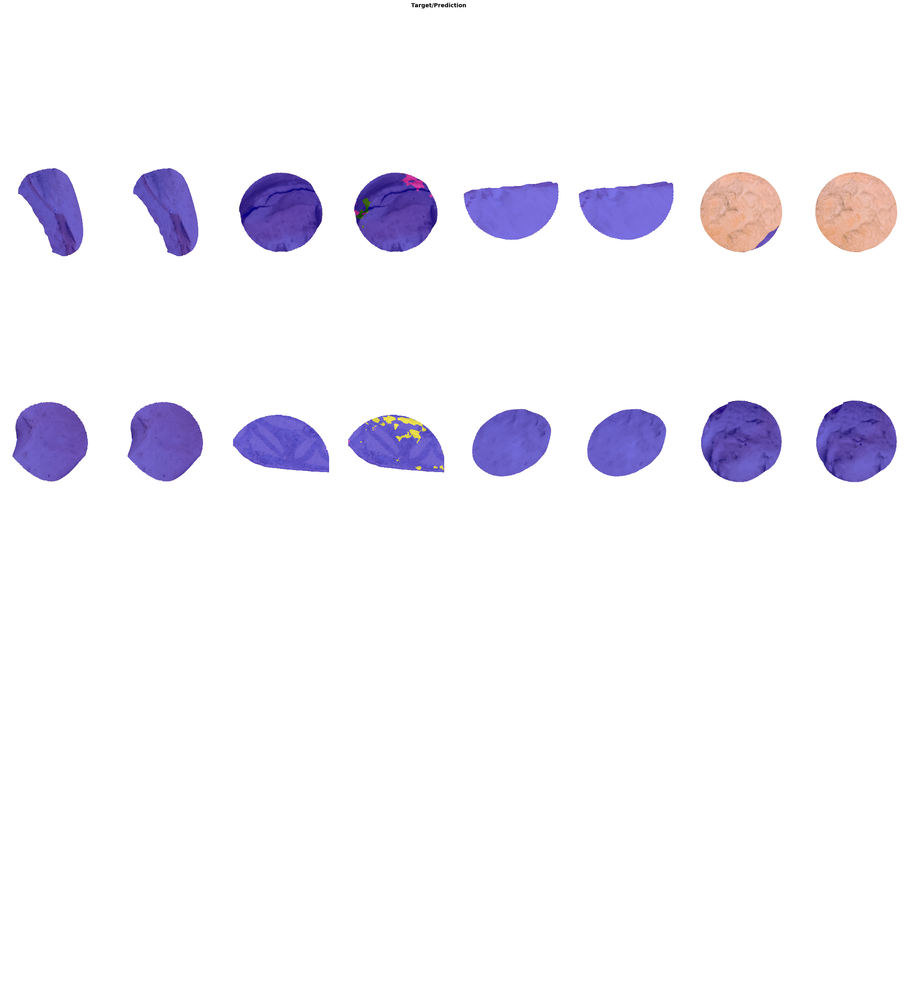

In [60]:
show_results(env, learn)

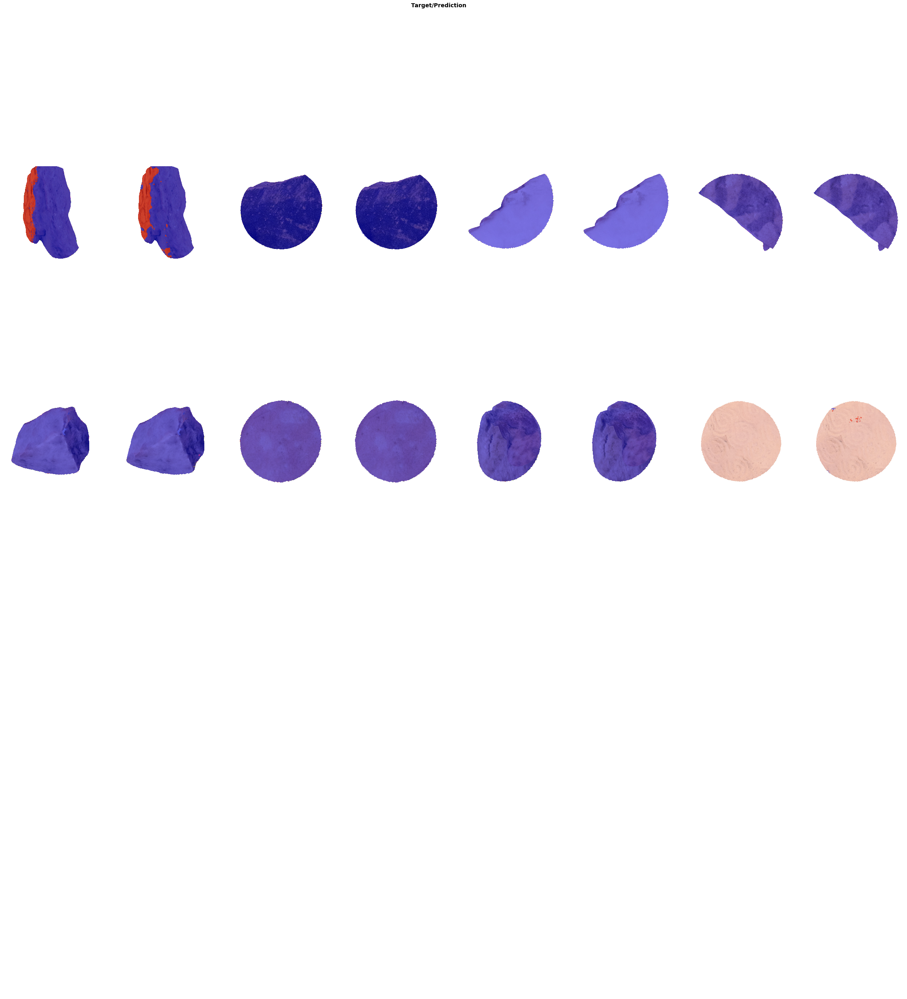

In [61]:
show_results(env, learn)

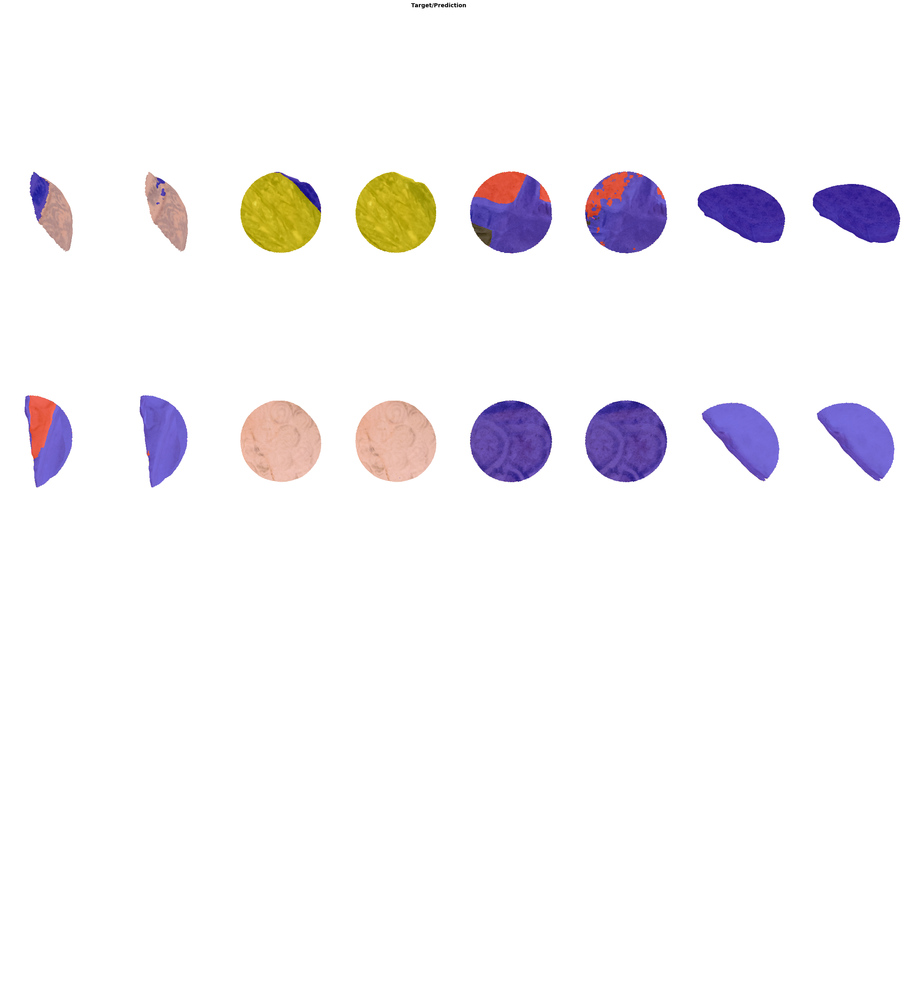

In [62]:
show_results(env, learn)

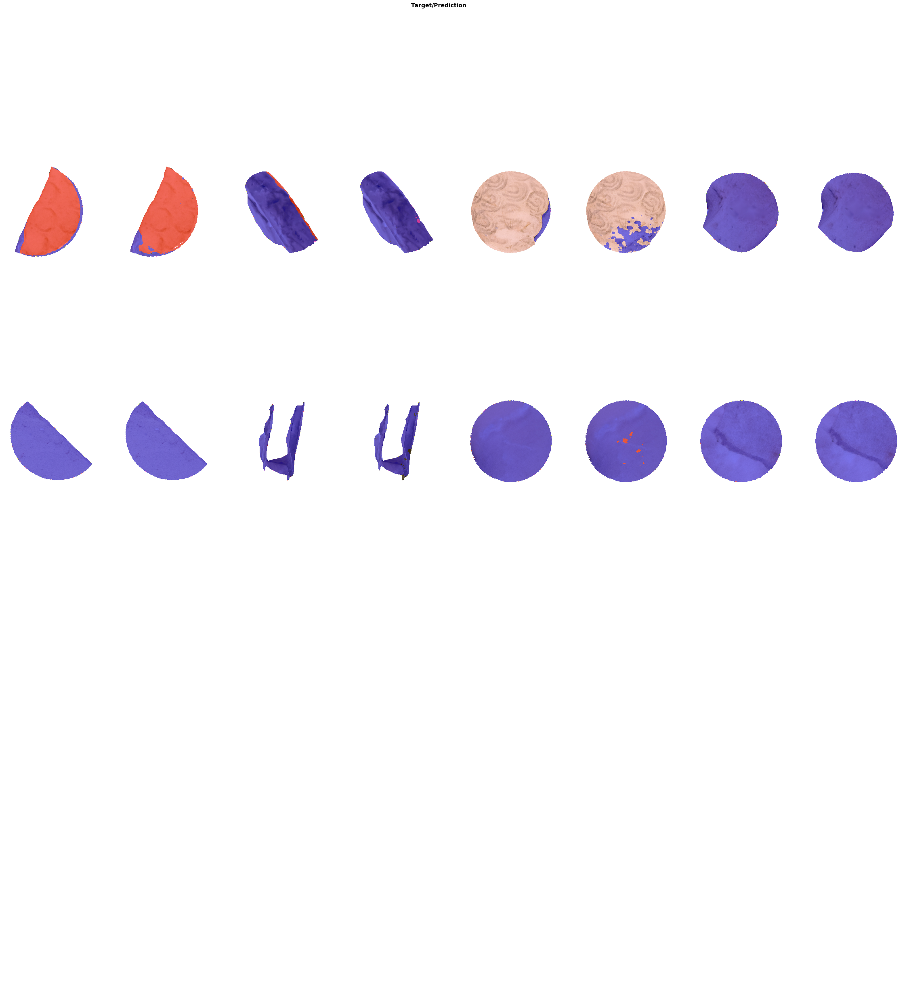

In [63]:
show_results(env, learn)

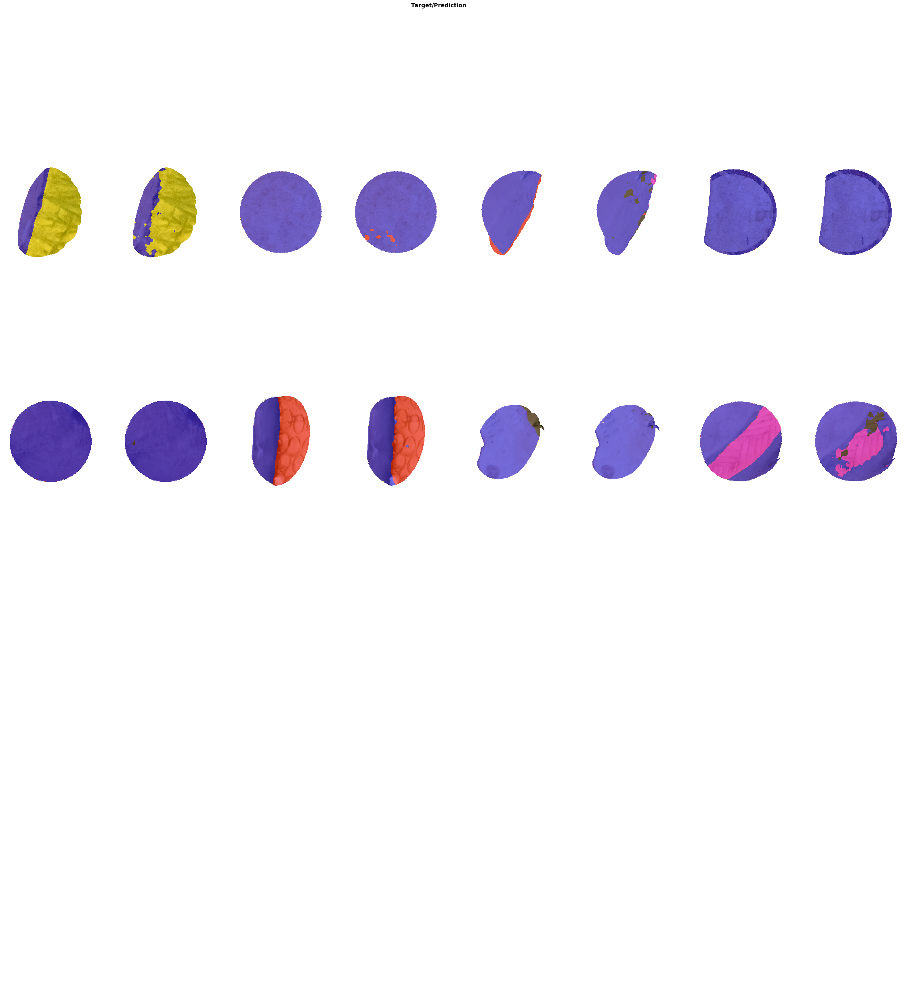

In [64]:
show_results(env, learn)

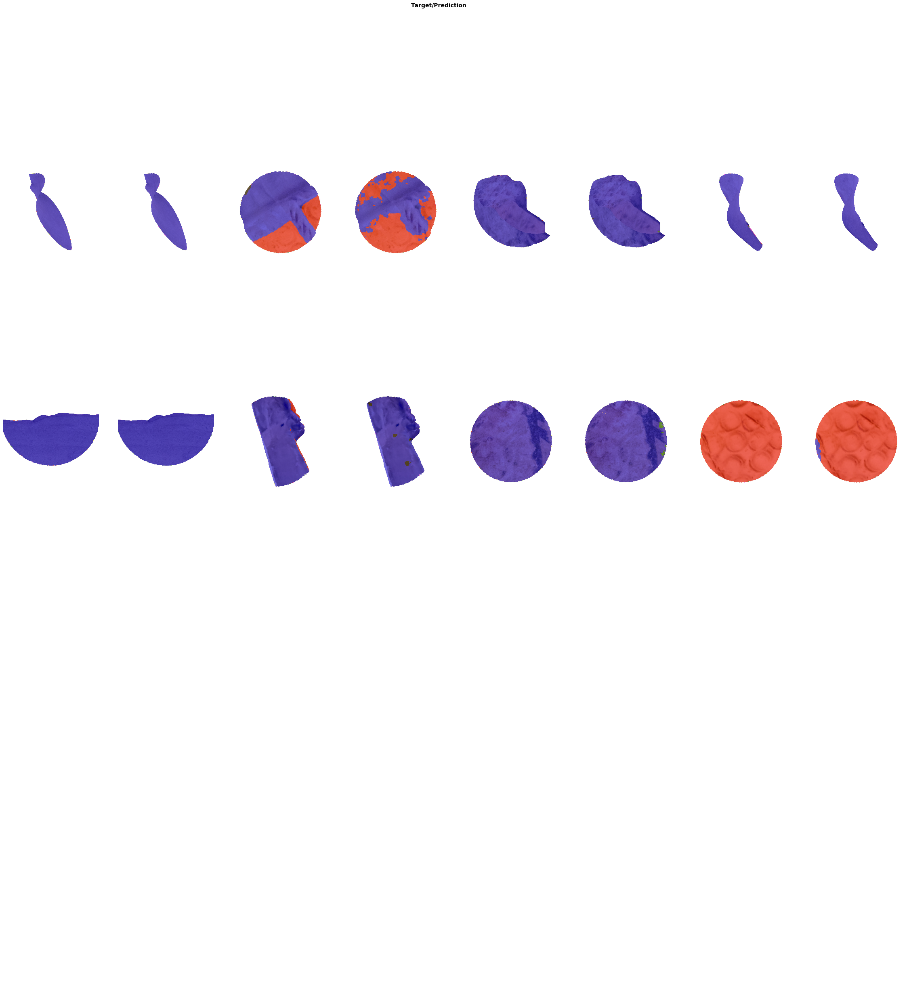

In [65]:
show_results(env, learn)

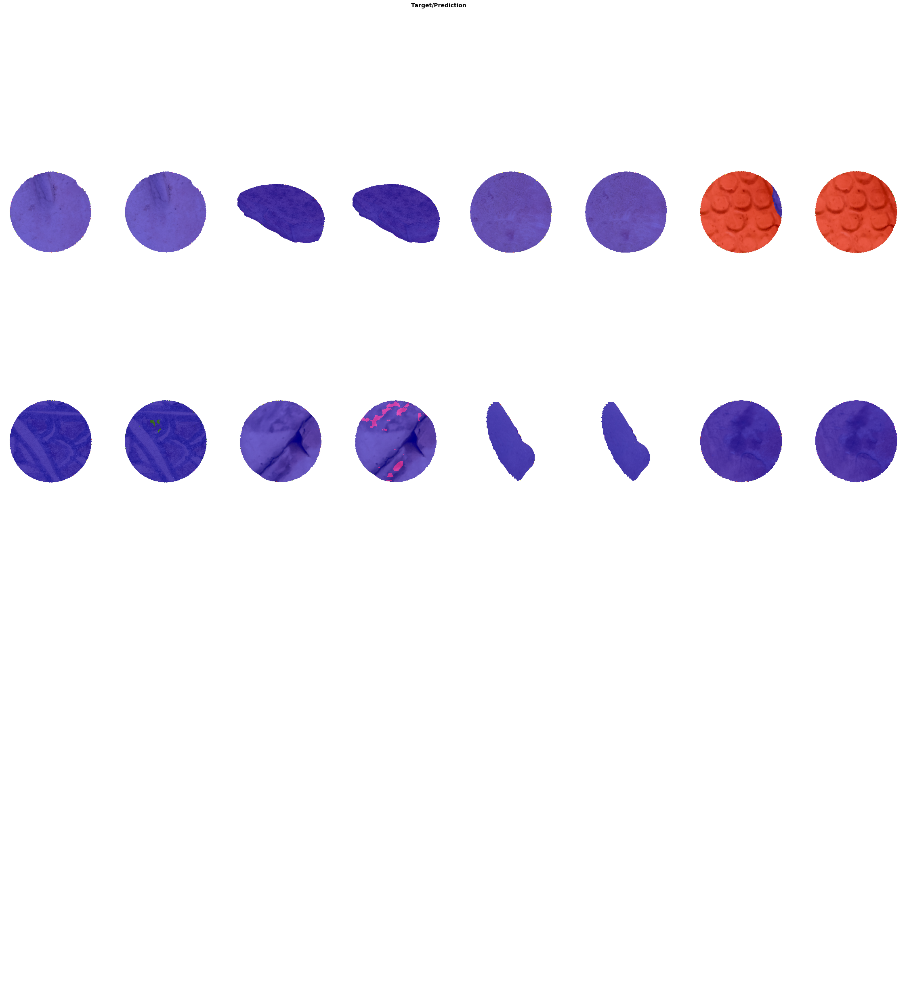

In [66]:
show_results(env, learn)

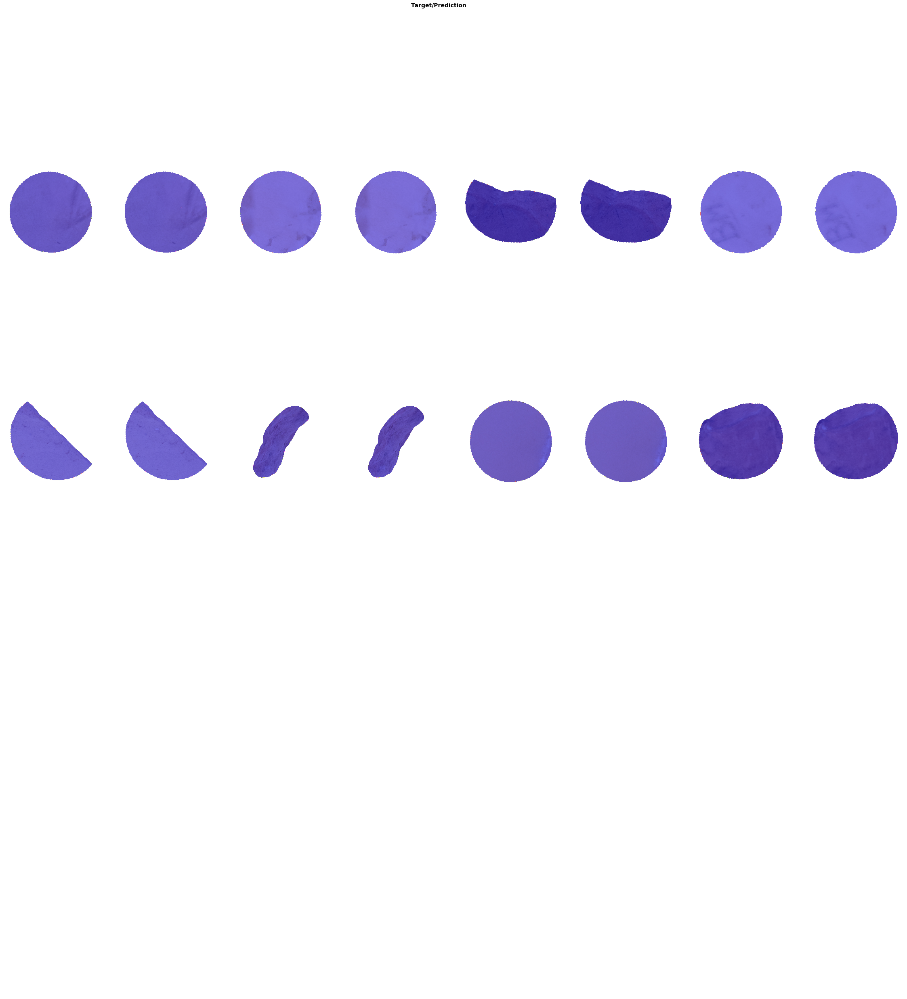

In [67]:
show_results(env, learn)

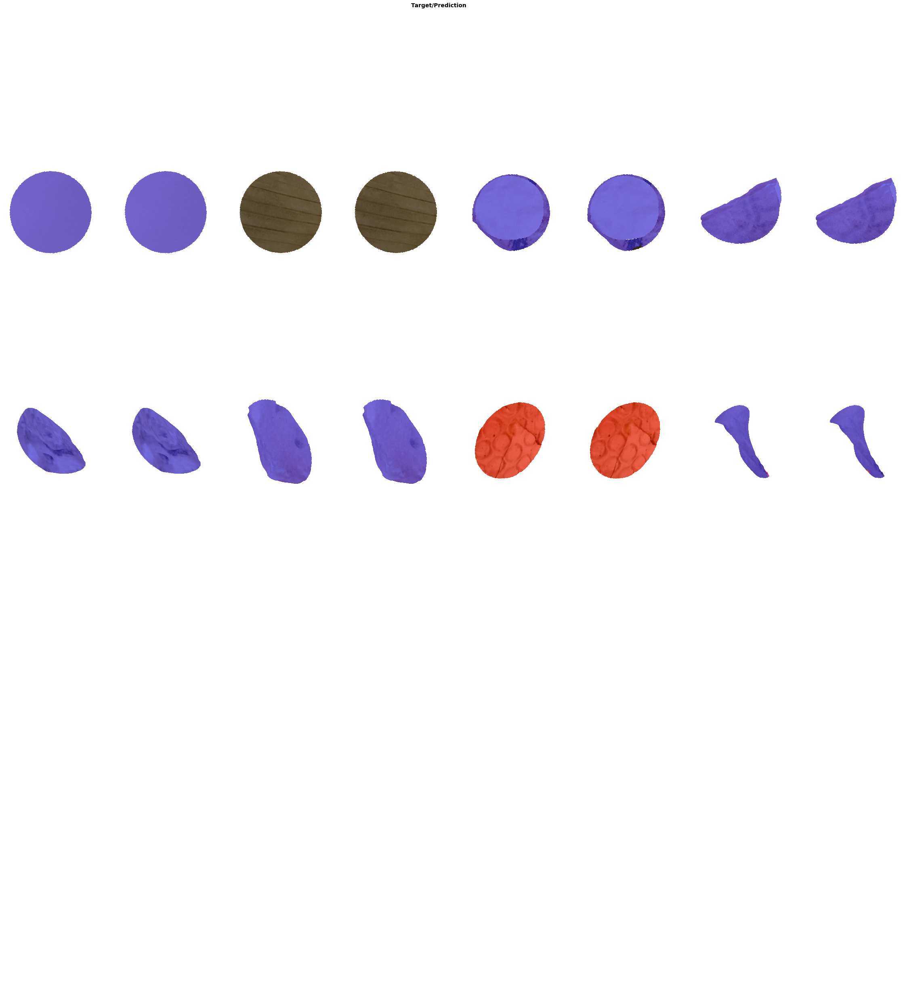

In [68]:
show_results(env, learn)

# Basic Data Aug

Setting-up type transforms pipelines
Found 1821 items
2 datasets of sizes 1290,531
Setting up Pipeline: PILBase.create
Setting up Pipeline: get_y_fn -> PILBase.create

Building one sample
  Pipeline: PILBase.create
    starting from
      /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB/training/images/11_79-col.jpg
    applying PILBase.create gives
      PILImage mode=RGB size=1585x1502
  Pipeline: get_y_fn -> PILBase.create
    starting from
      /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB/training/images/11_79-col.jpg
    applying get_y_fn gives
      /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB/training/masks/11_79-col.png
    applying PILBase.create gives
      PILMask mode=RGB size=1585x1502

Final sample: (PILImage mode=RGB size=1585x1502, PILMask mode=RGB size=1585x1502)


Found 1821 items
2 datasets of sizes 1290,531
Se

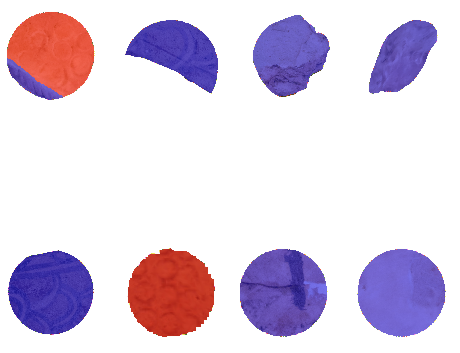

In [69]:
learn = init_learner(env)

## Round 1

------------------------------------
Running with basic data augmentation
------------------------------------
Setting-up type transforms pipelines
Found 1821 items
2 datasets of sizes 1290,531
Setting up Pipeline: PILBase.create
Setting up Pipeline: get_y_fn -> PILBase.create

Building one sample
  Pipeline: PILBase.create
    starting from
      /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB/training/images/11_79-col.jpg
    applying PILBase.create gives
      PILImage mode=RGB size=1585x1502
  Pipeline: get_y_fn -> PILBase.create
    starting from
      /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB/training/images/11_79-col.jpg
    applying get_y_fn gives
      /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB/training/masks/11_79-col.png
    applying PILBase.create gives
      PILMask mode=RGB size=1585x1502

Final sample: (PILIma

Thu Sep 23 14:10:21 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 450.80.02    Driver Version: 450.80.02    CUDA Version: 11.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla V100-PCIE...  On   | 00000000:5E:00.0 Off |                    0 |
| N/A   44C    P0    45W / 250W |  30949MiB / 32510MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
|   1  Tesla V100-PCIE...  On   | 00000000:86:00.0 Off |                    0 |
| N/A   

epoch,train_loss,valid_loss,surfpatt_metric,f-score,precision,recall,time
0,0.814289,0.520619,0.000011,0.229852,0.300787,0.247704,11:34
1,0.551163,0.408199,0.001832,0.234574,0.539103,0.250754,11:32
2,0.494557,0.354202,0.067563,0.321175,0.595851,0.300558,11:30
3,0.434528,0.307792,0.160061,0.369352,0.577917,0.348765,11:29
4,0.412529,0.284213,0.261590,0.435762,0.586901,0.413793,11:31
5,0.414452,0.241290,0.317266,0.511730,0.739874,0.476410,11:35
6,0.393773,0.238918,0.315083,0.518841,0.723228,0.468256,11:35
7,0.384753,0.283237,0.237549,0.466132,0.791578,0.419030,11:34
8,0.352466,0.256397,0.296200,0.509528,0.678541,0.457311,11:34
9,0.339854,0.265501,0.296056,0.426052,0.714216,0.420763,11:32


Better model found at epoch 0 with valid_loss value: 0.5206190347671509.
Better model found at epoch 0 with valid_loss value: 0.5206190347671509.


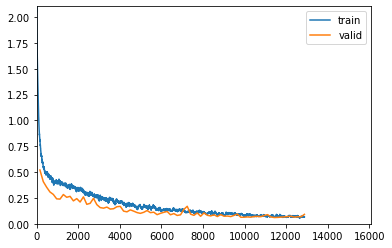

Better model found at epoch 1 with valid_loss value: 0.4081994295120239.
Better model found at epoch 1 with valid_loss value: 0.4081994295120239.
Better model found at epoch 2 with valid_loss value: 0.35420215129852295.
Better model found at epoch 2 with valid_loss value: 0.35420215129852295.
Better model found at epoch 3 with valid_loss value: 0.30779239535331726.
Better model found at epoch 3 with valid_loss value: 0.30779239535331726.
Better model found at epoch 4 with valid_loss value: 0.28421348333358765.
Better model found at epoch 4 with valid_loss value: 0.28421348333358765.
Better model found at epoch 5 with valid_loss value: 0.24128995835781097.
Better model found at epoch 5 with valid_loss value: 0.24128995835781097.
Better model found at epoch 6 with valid_loss value: 0.23891836404800415.
Better model found at epoch 6 with valid_loss value: 0.23891836404800415.
Better model found at epoch 10 with valid_loss value: 0.22179928421974182.
Better model found at epoch 10 with val

Looking for SURFpatt_v3alpha-RGB-deeplabv3+-resnet152-*-best models in: /home/ranieri/notebooks/models
--------------------
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1a-2021-09-20_17.43.42-WD-0.0001-BS-8-LR-0.0015848932266235352-0.015848932266235353-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1b-2021-09-20_17.43.42-WD-0.0001-BS-8-LR-6.30957365501672e-08-6.30957365501672e-07-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB-deeplabv3+-resnet152-basic-data-aug-img_size-1585-1585-1a-2021-09-20_17.43.42-WD-0.0001-BS-8-LR-0.0007585775852203369-0.007585775852203369-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1a-2021-09-21_12.18.58-WD-0.0001-BS-8-LR-0.0027542285919189453-0.027542285919189453-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB-deeplabv3+-resnet152-no-data-aug-i

0 - valid_loss = 0.06066902354359627
1 - surfpatt_metric = 0.7463010549545288
2 - f-score = 0.8942934469319862
3 - precision = 0.886577090185426
4 - recall = 0.904821652683454
LR_finding in parallel_ctx context on GPU [0, 1]


Fri Sep 24 05:56:31 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 450.80.02    Driver Version: 450.80.02    CUDA Version: 11.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla V100-PCIE...  On   | 00000000:5E:00.0 Off |                    0 |
| N/A   38C    P0    37W / 250W |  31033MiB / 32510MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
|   1  Tesla V100-PCIE...  On   | 00000000:86:00.0 Off |                    0 |
| N/A   

epoch,train_loss,valid_loss,surfpatt_metric,f-score,precision,recall,time
0,0.070497,0.062515,0.737574,0.890957,0.882587,0.906221,11:47
1,0.071650,0.062310,0.748278,0.891086,0.881415,0.904853,11:50
2,0.069502,0.057756,0.749737,0.901162,0.897475,0.907138,11:52
3,0.074445,0.061493,0.752880,0.897688,0.890032,0.908665,11:49
4,0.075119,0.068926,0.753131,0.883440,0.865454,0.908888,11:49
5,0.076081,0.065522,0.748655,0.887052,0.874220,0.904194,11:47
6,0.069053,0.068229,0.753208,0.881867,0.860616,0.912735,11:50
7,0.060519,0.062212,0.727230,0.890799,0.892286,0.893783,11:49
8,0.068591,0.062376,0.752428,0.894971,0.883236,0.910493,11:55
9,0.070815,0.065639,0.759319,0.887558,0.870327,0.907801,11:47


Better model found at epoch 0 with valid_loss value: 0.06251522153615952.
Better model found at epoch 0 with valid_loss value: 0.06251522153615952.


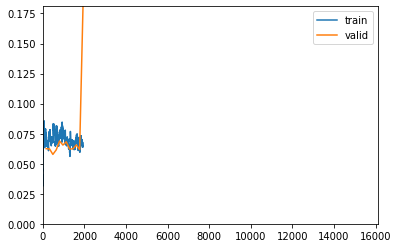

Better model found at epoch 1 with valid_loss value: 0.06231001764535904.
Better model found at epoch 1 with valid_loss value: 0.06231001764535904.
Better model found at epoch 2 with valid_loss value: 0.057756420224905014.
Better model found at epoch 2 with valid_loss value: 0.057756420224905014.
No improvement since epoch 2: early stopping
Fri Sep 24 08:30:36 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 450.80.02    Driver Version: 450.80.02    CUDA Version: 11.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla V100-PCIE...  On   | 00000000:5E:00.0 Off |         

Looking for SURFpatt_v3alpha-RGB-deeplabv3+-resnet152-*-best models in: /home/ranieri/notebooks/models
--------------------
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1a-2021-09-20_17.43.42-WD-0.0001-BS-8-LR-0.0015848932266235352-0.015848932266235353-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1b-2021-09-20_17.43.42-WD-0.0001-BS-8-LR-6.30957365501672e-08-6.30957365501672e-07-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB-deeplabv3+-resnet152-basic-data-aug-img_size-1585-1585-1a-2021-09-20_17.43.42-WD-0.0001-BS-8-LR-0.0007585775852203369-0.007585775852203369-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1a-2021-09-21_12.18.58-WD-0.0001-BS-8-LR-0.0027542285919189453-0.027542285919189453-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB-deeplabv3+-resnet152-no-data-aug-i

0 - valid_loss = 0.05775804817676544
1 - surfpatt_metric = 0.7497308850288391
2 - f-score = 0.9011635739641728
3 - precision = 0.8974859910388566
4 - recall = 0.907126945139296


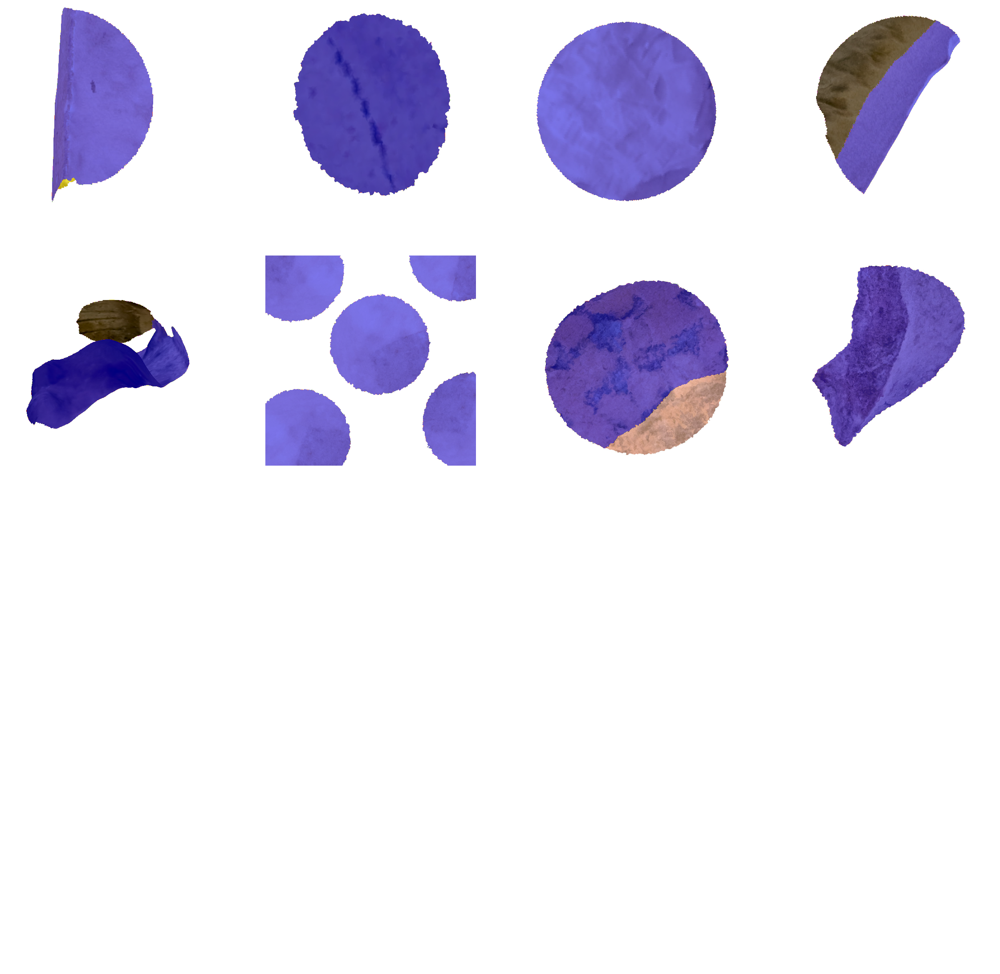

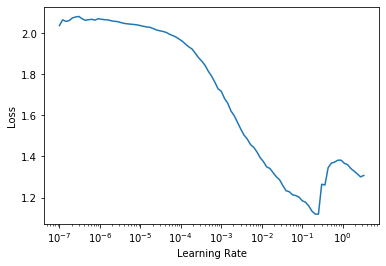

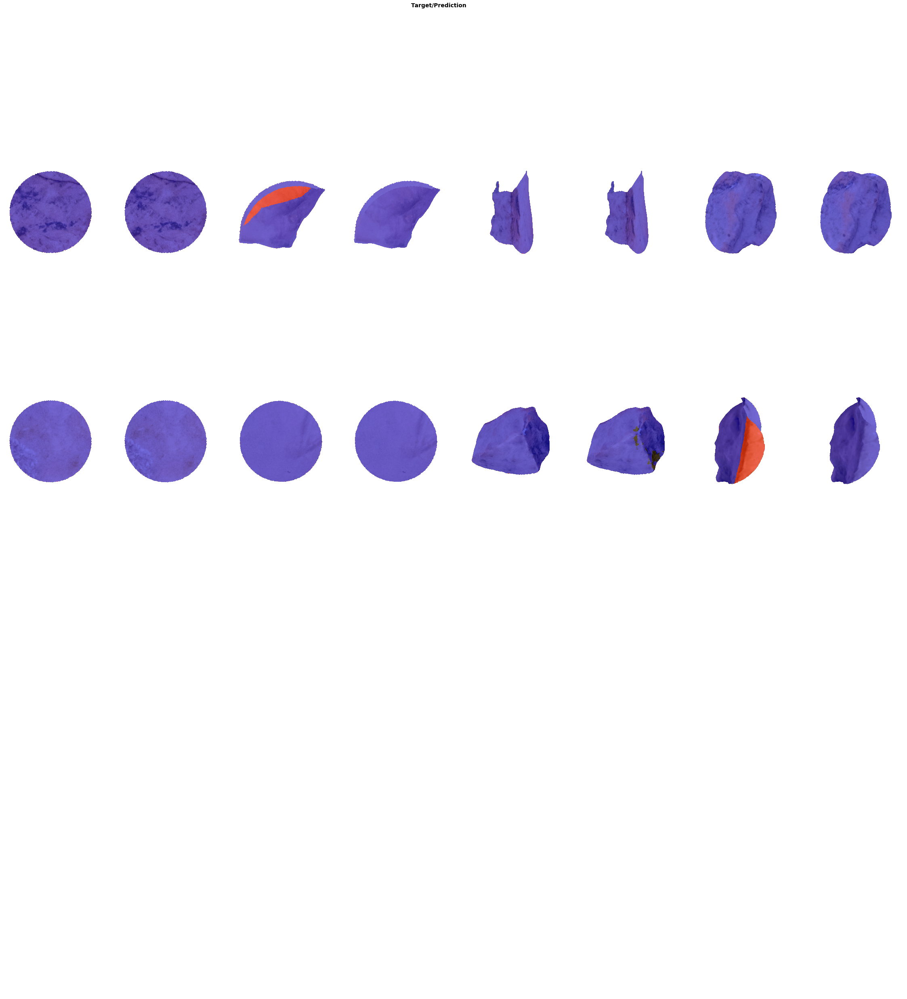

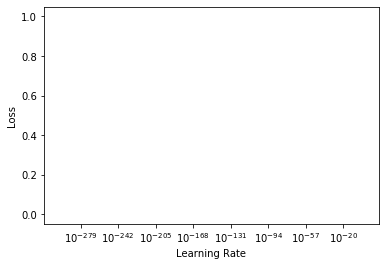

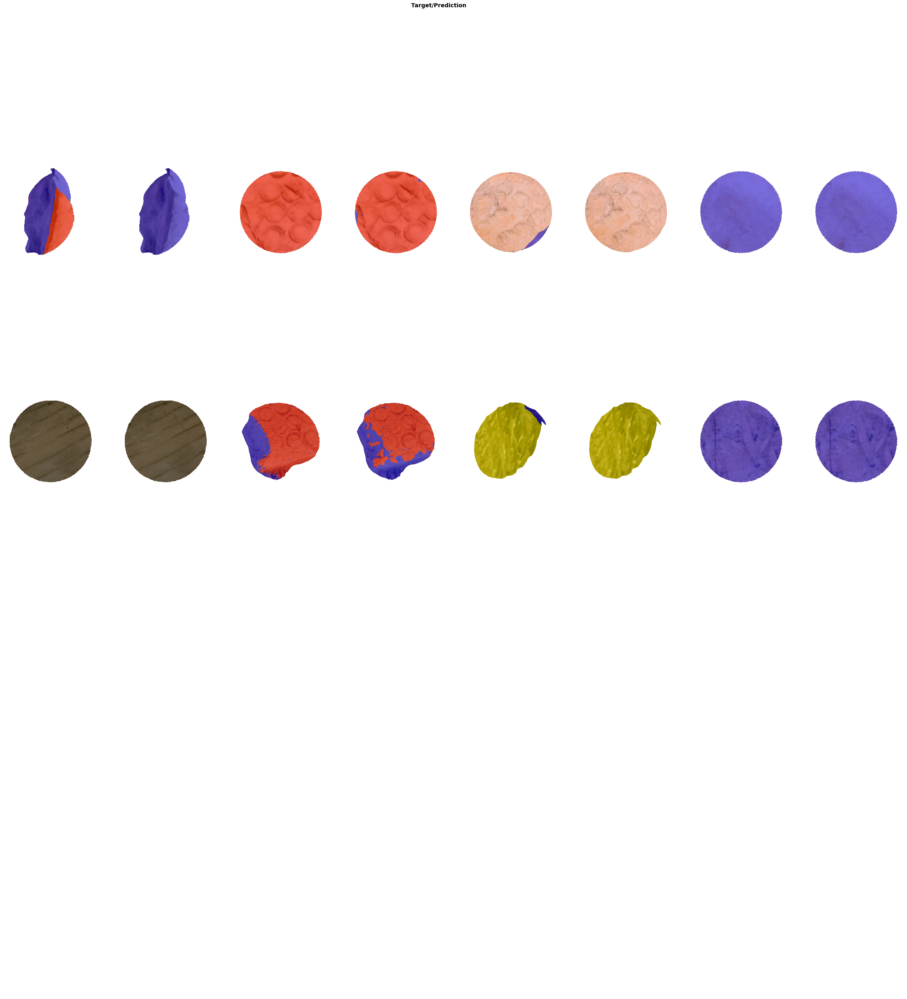

In [70]:
env['train_round']       = 0
env['data-augmentation'] = 'basic-data-aug'
do_training_round(env, learn, epochs=100)

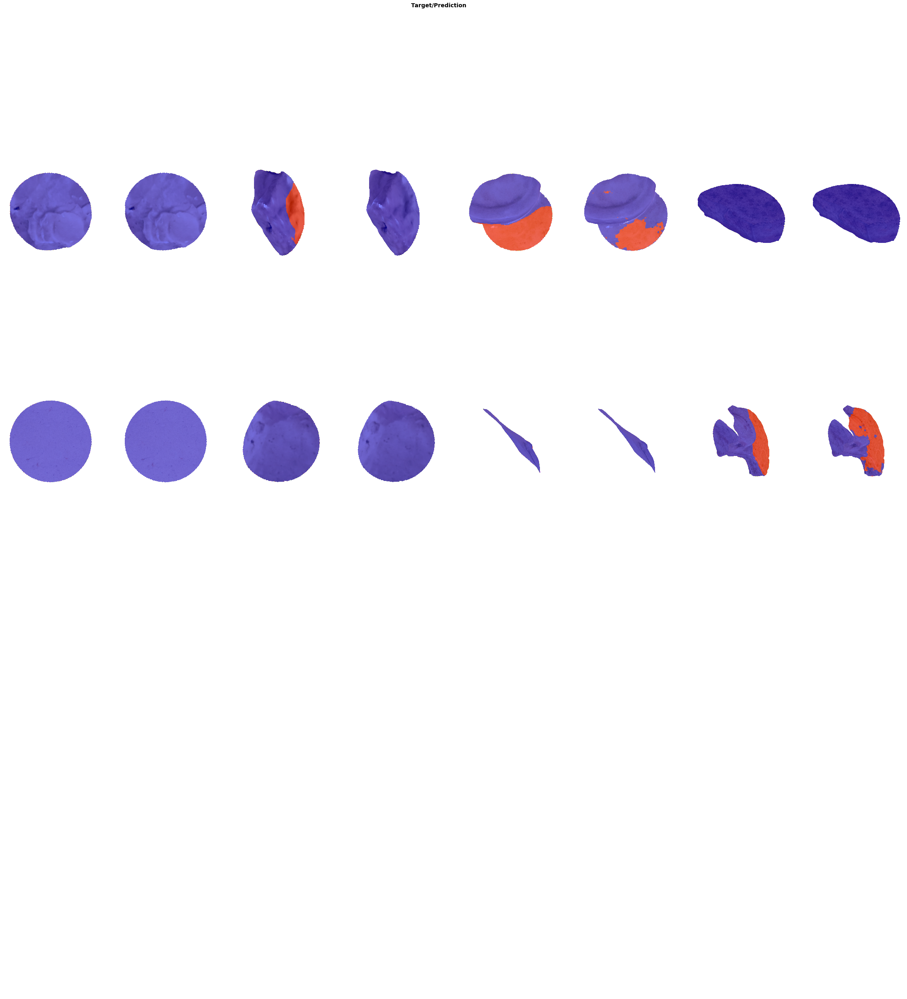

In [71]:
show_results(env, learn)

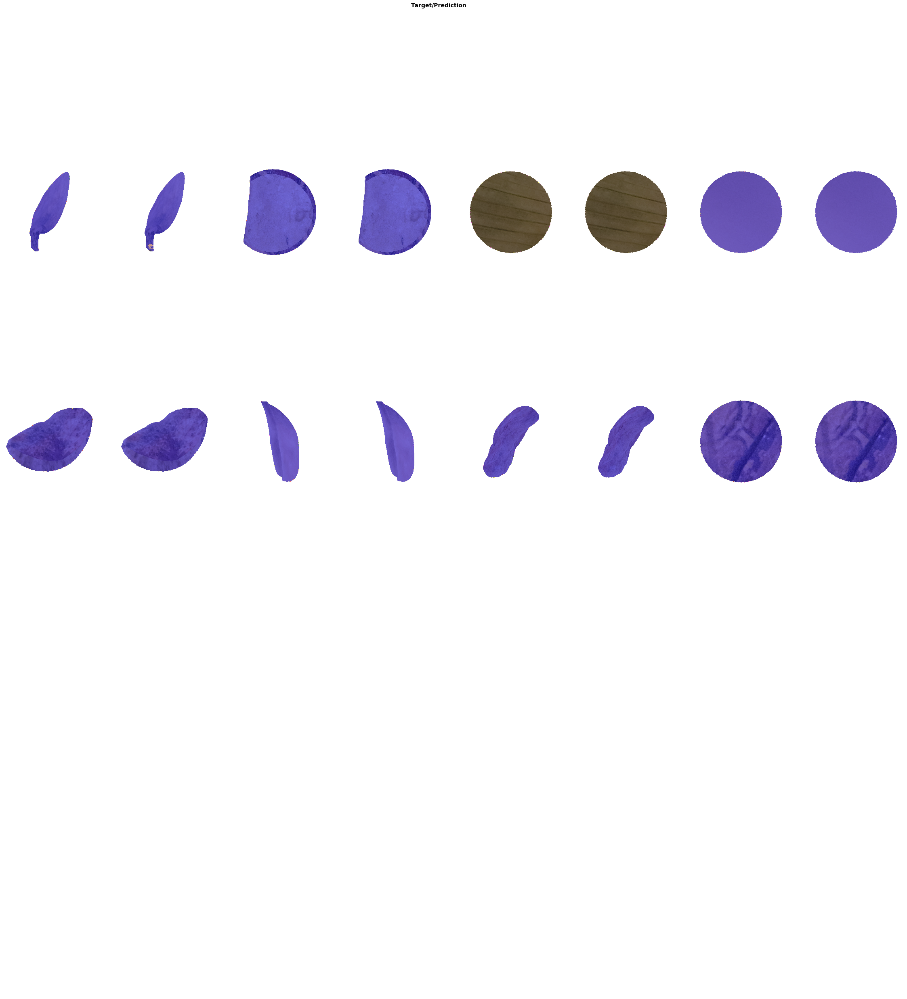

In [72]:
show_results(env, learn)

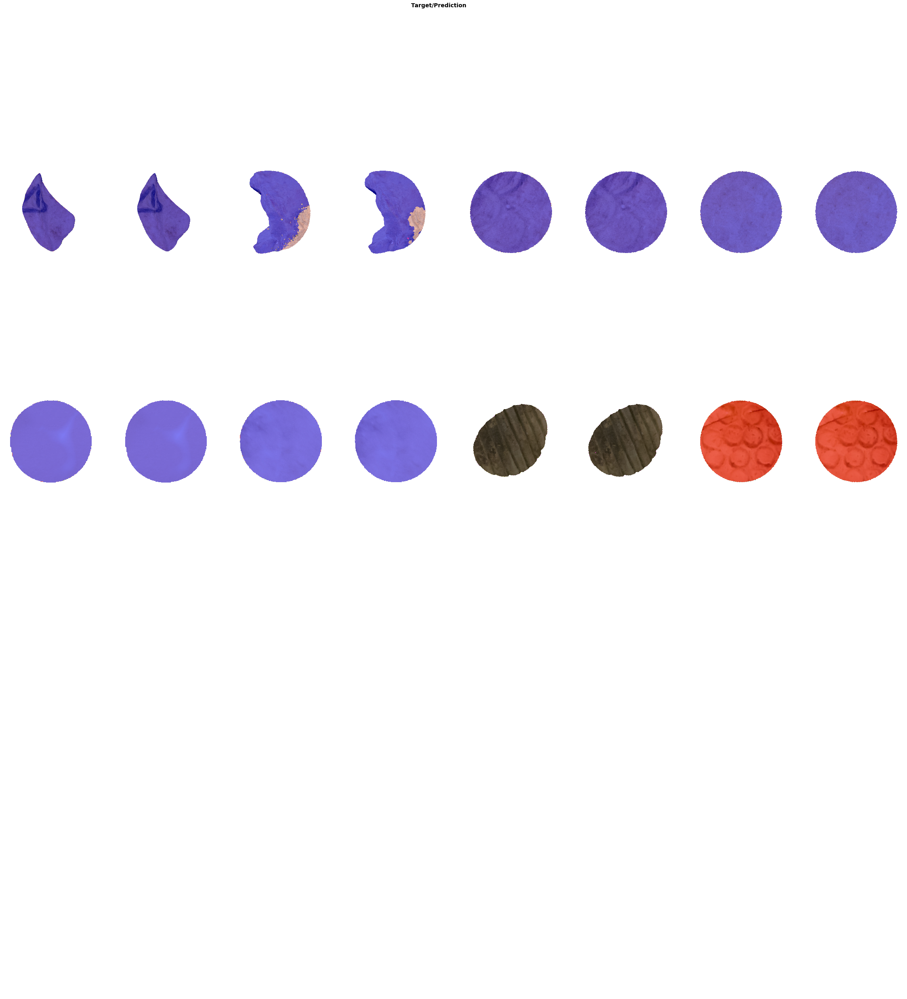

In [73]:
show_results(env, learn)

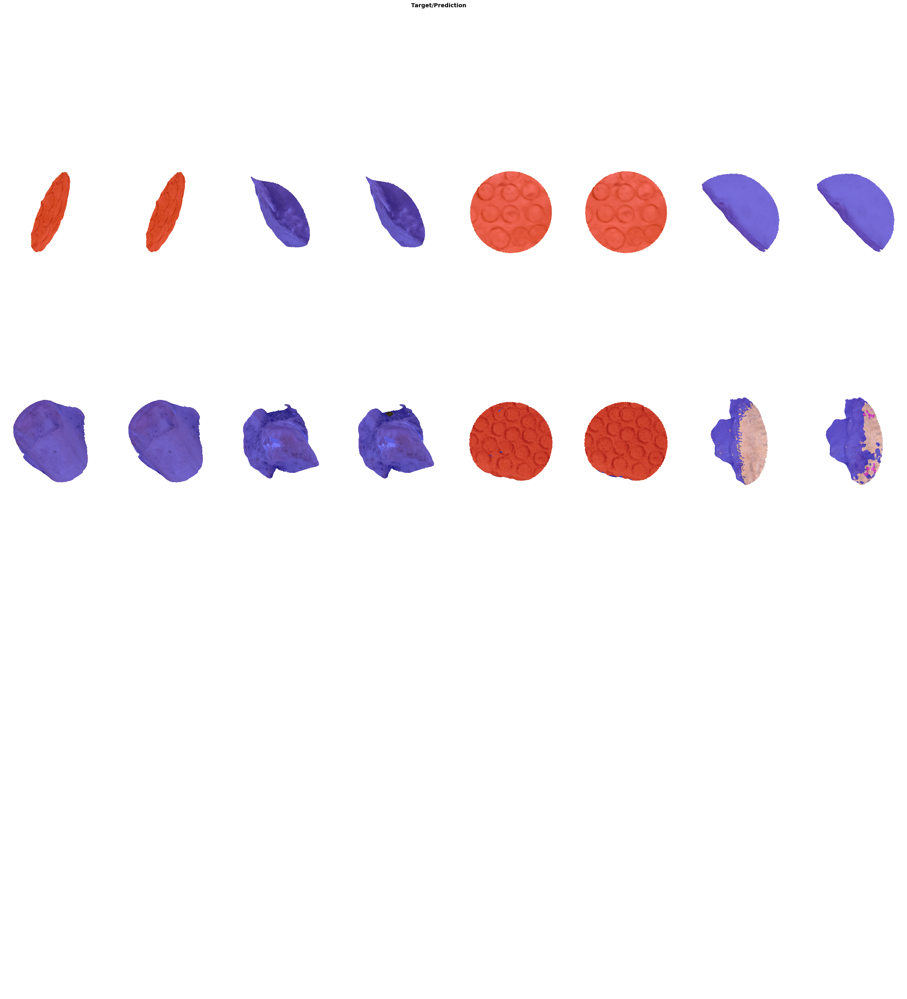

In [74]:
show_results(env, learn)

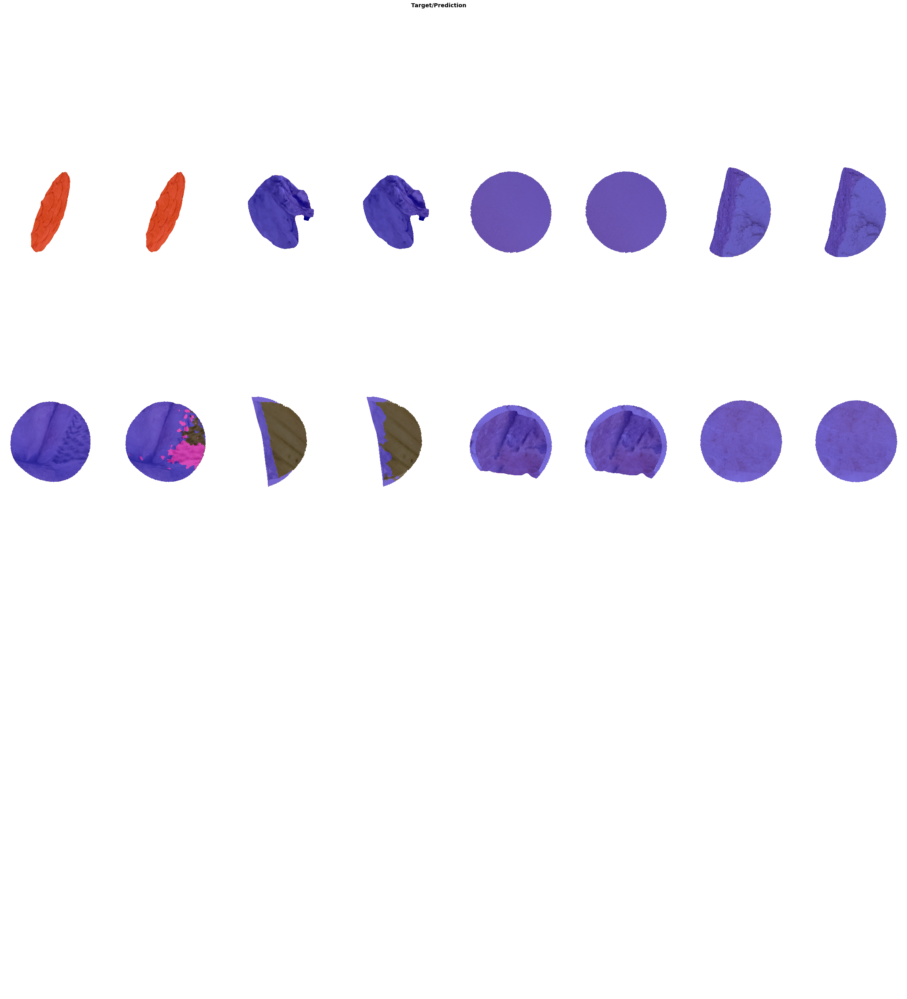

In [75]:
show_results(env, learn)

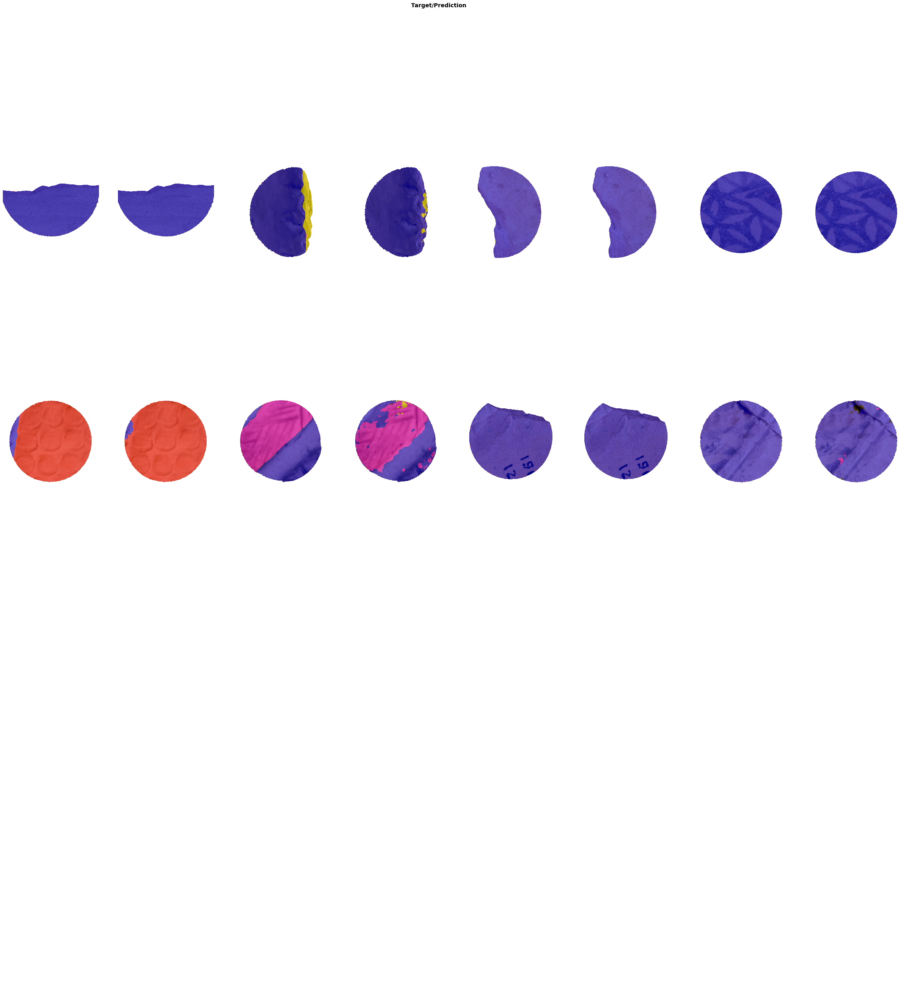

In [76]:
show_results(env, learn)

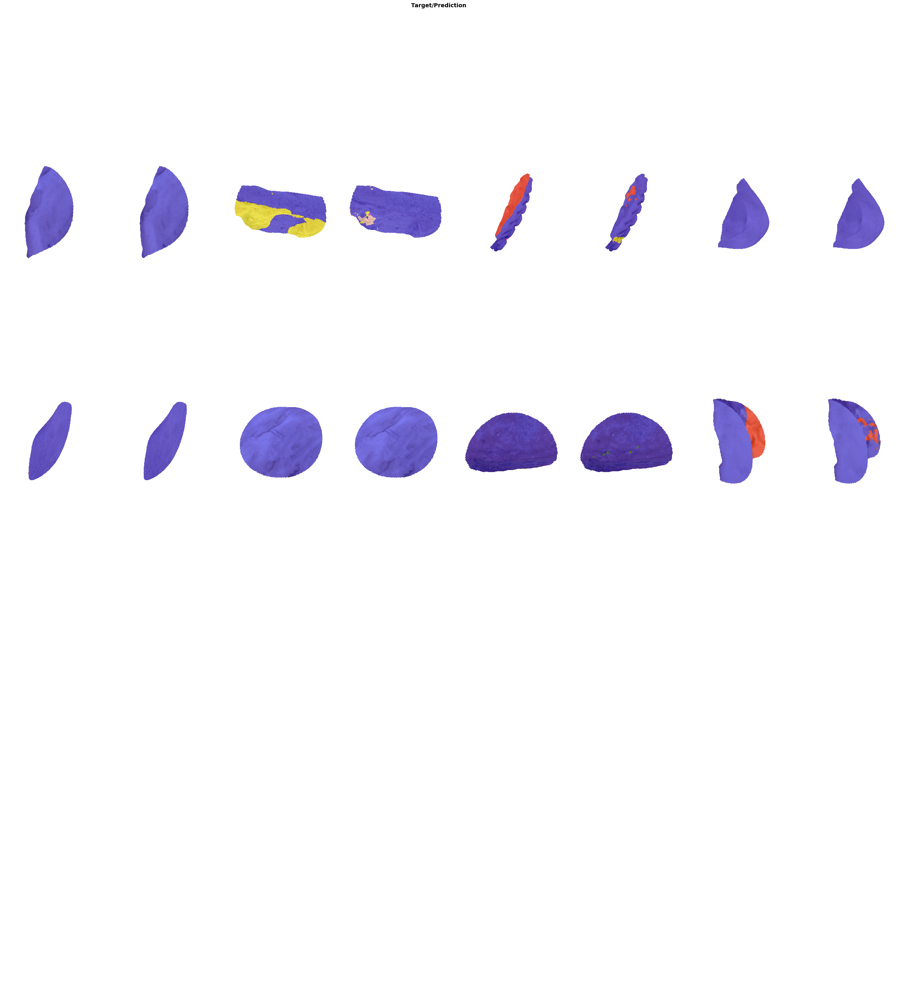

In [77]:
show_results(env, learn)

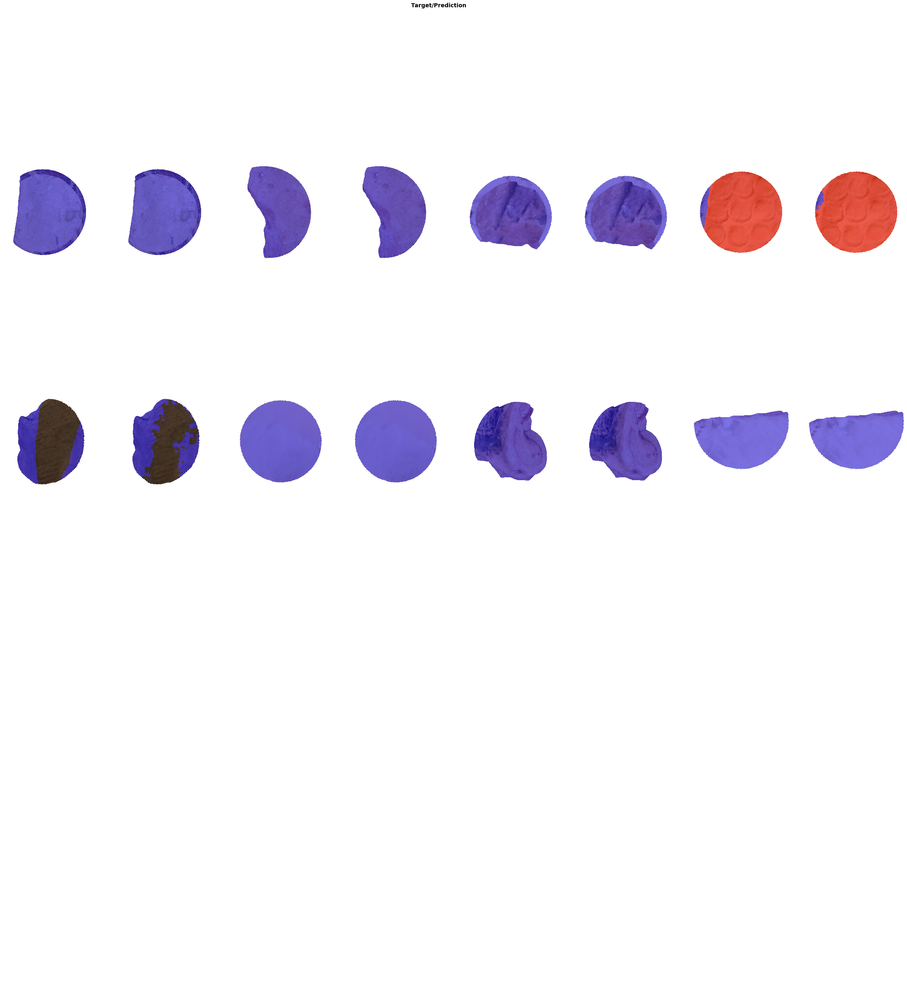

In [78]:
show_results(env, learn)

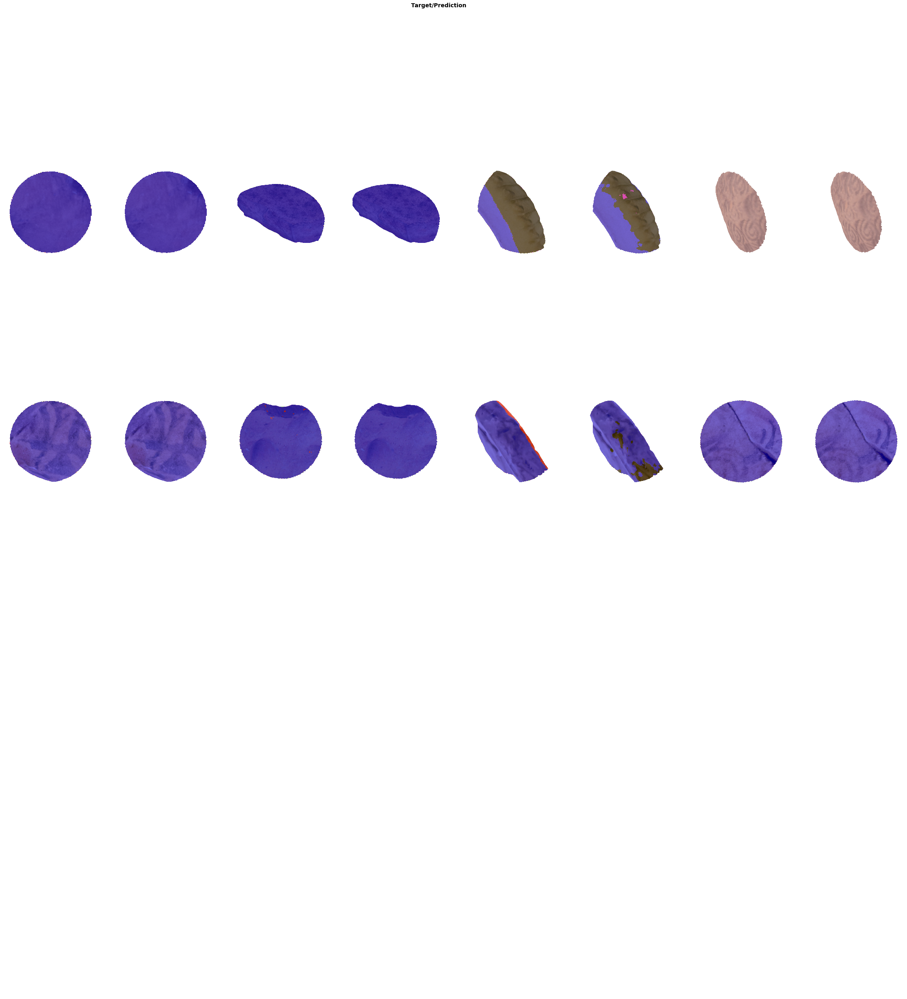

In [79]:
show_results(env, learn)

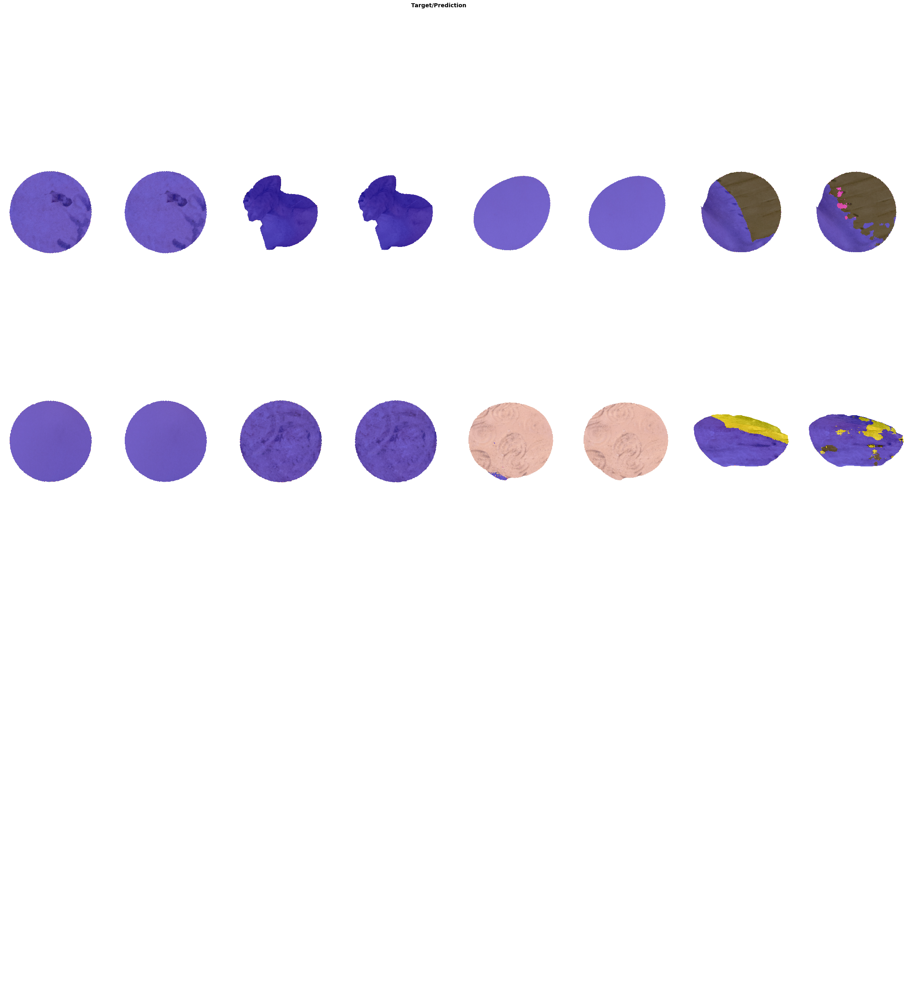

In [80]:
show_results(env, learn)

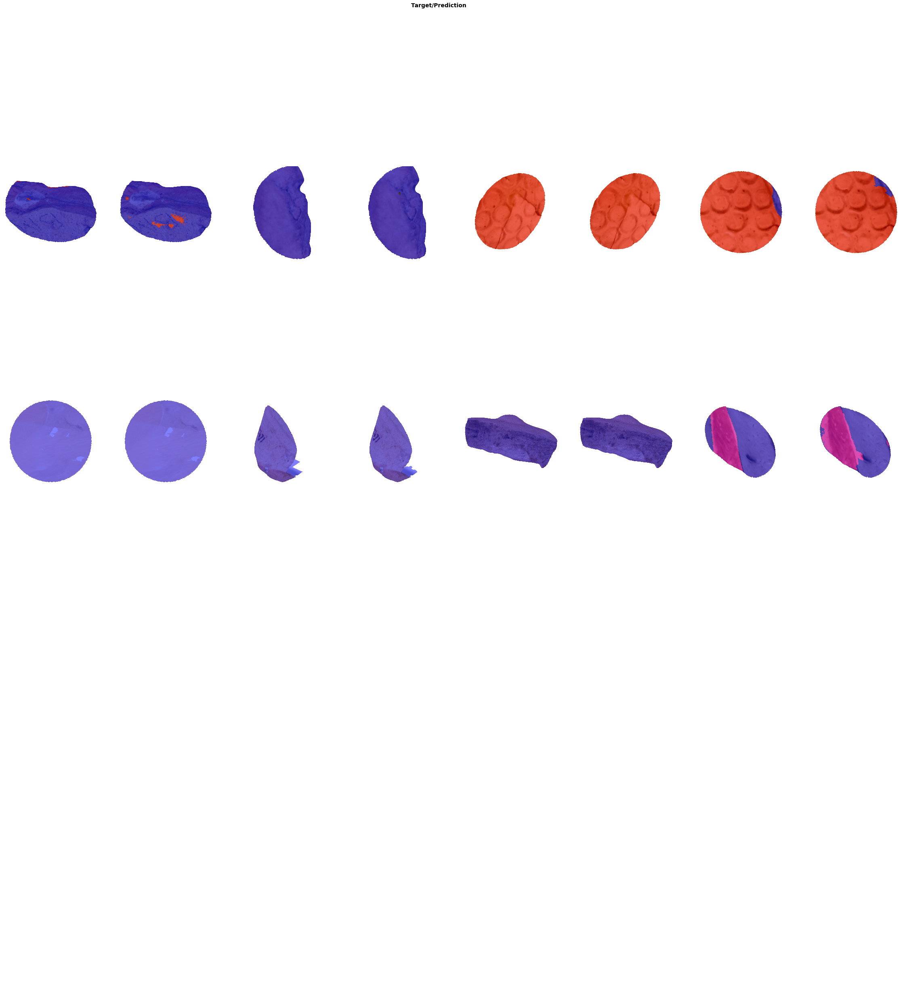

In [81]:
show_results(env, learn)

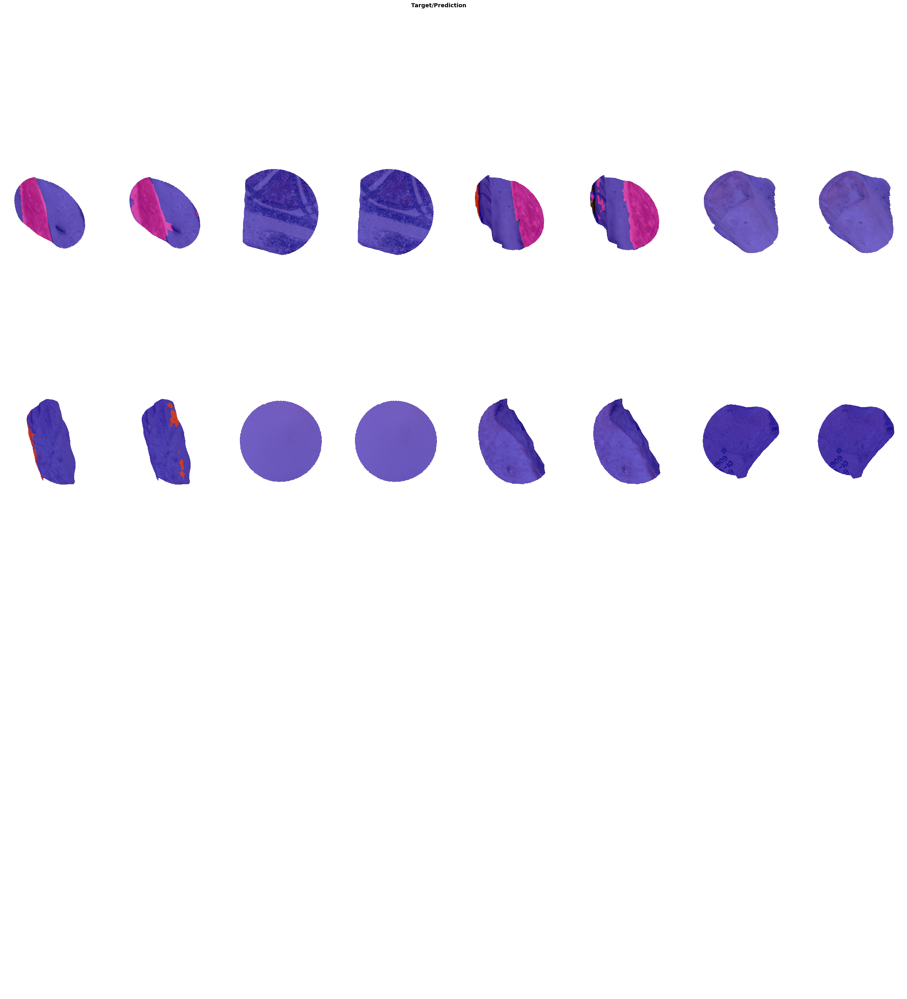

In [82]:
show_results(env, learn)

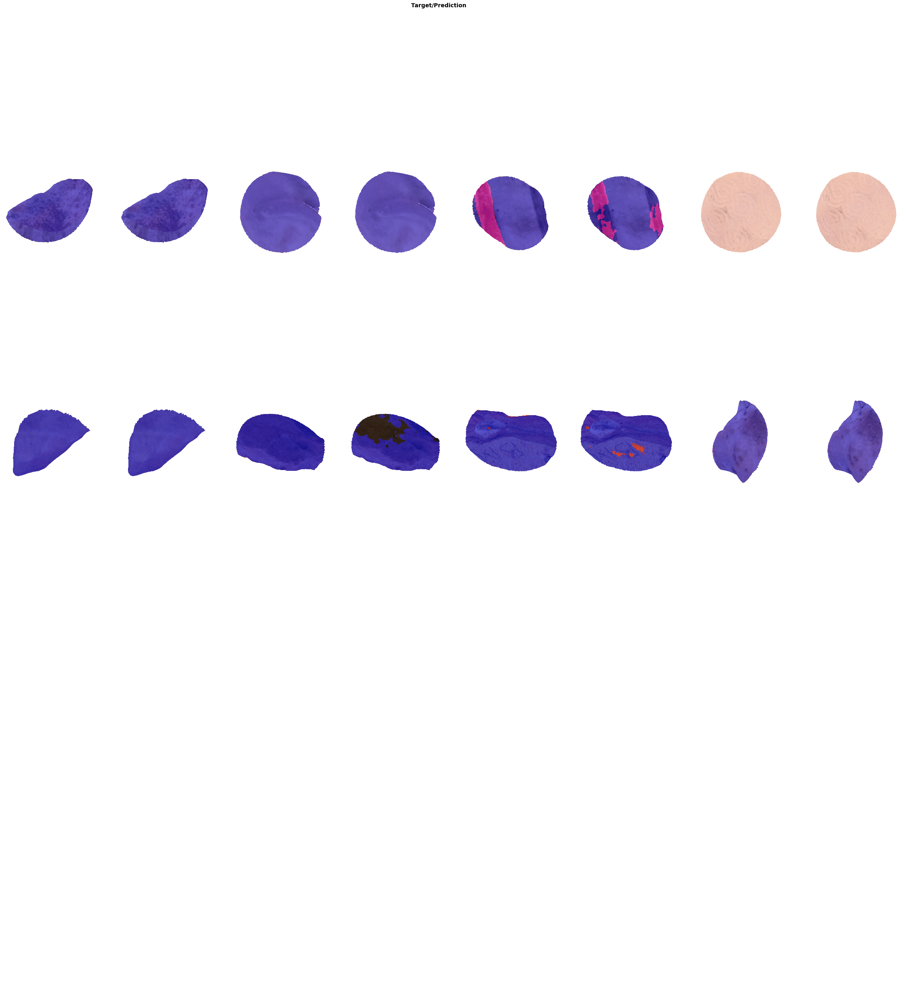

In [83]:
show_results(env, learn)

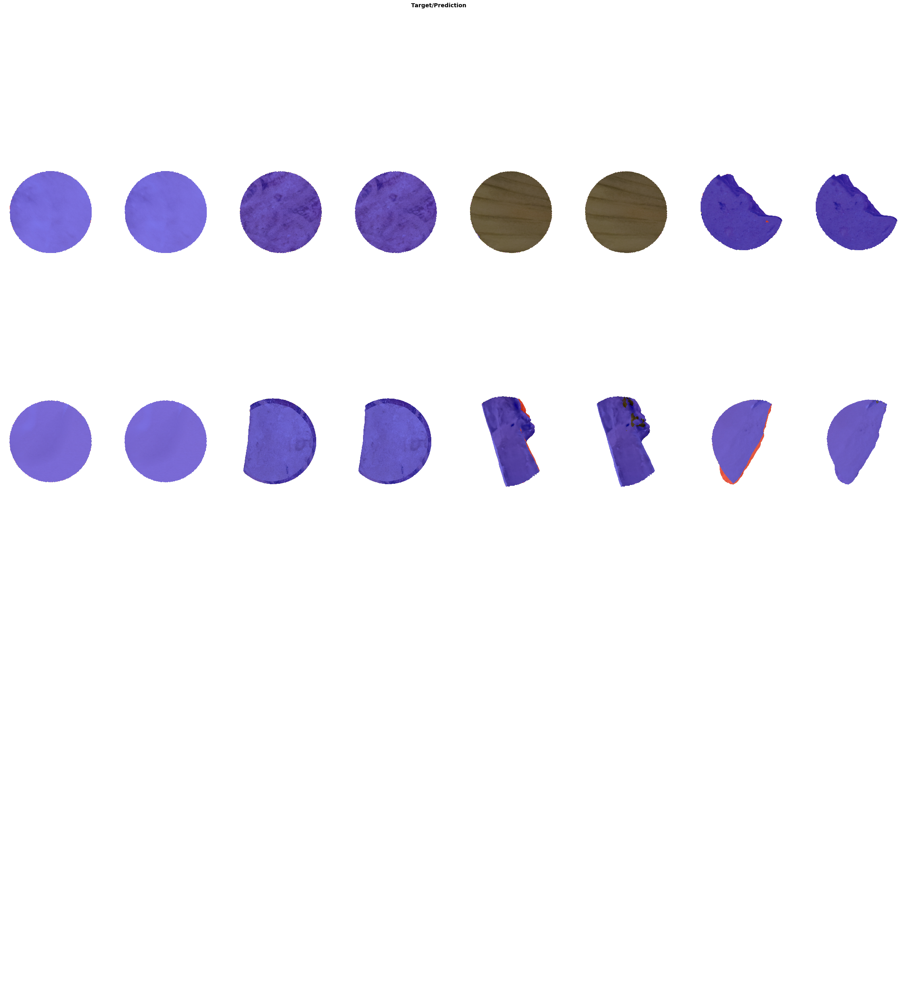

In [84]:
show_results(env, learn)

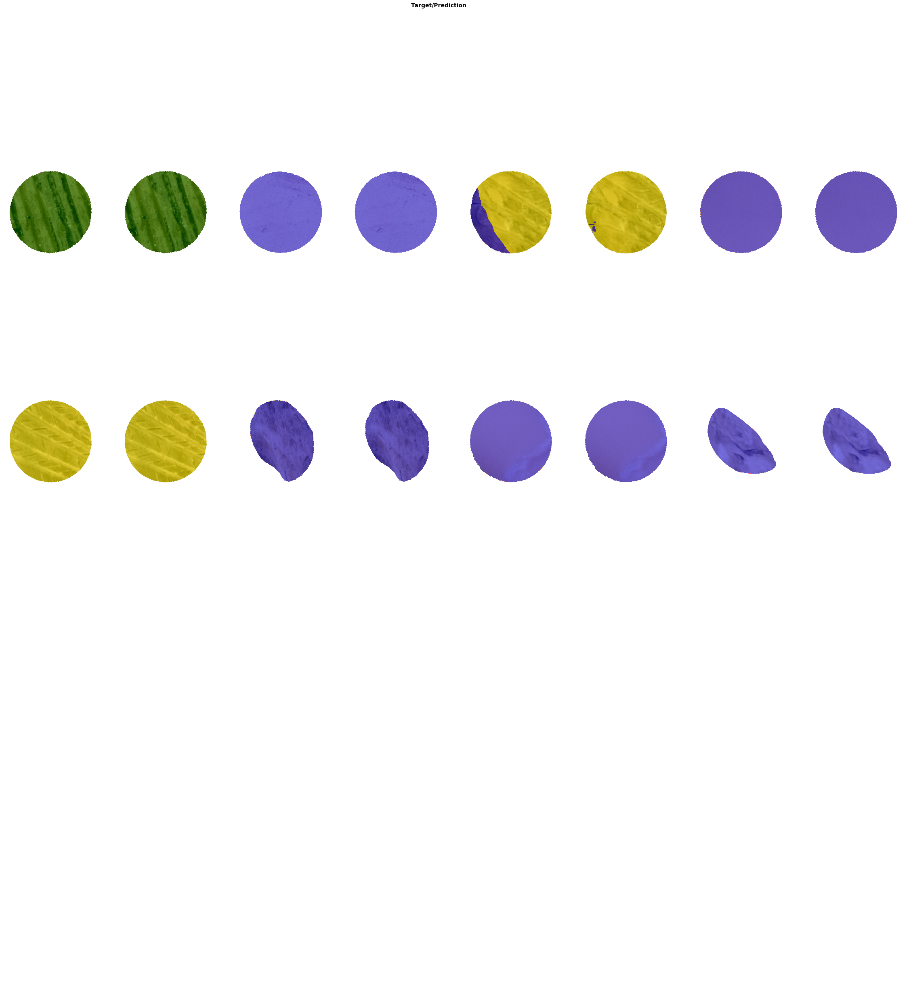

In [85]:
show_results(env, learn)

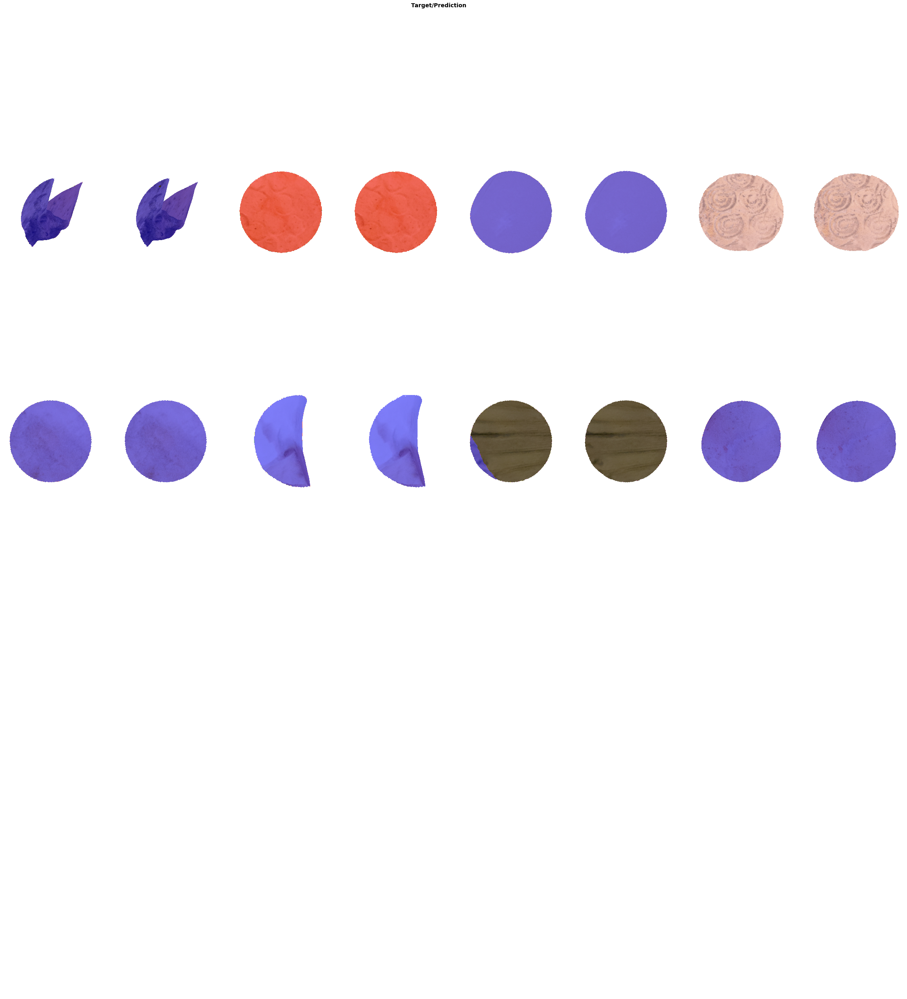

In [86]:
show_results(env, learn)

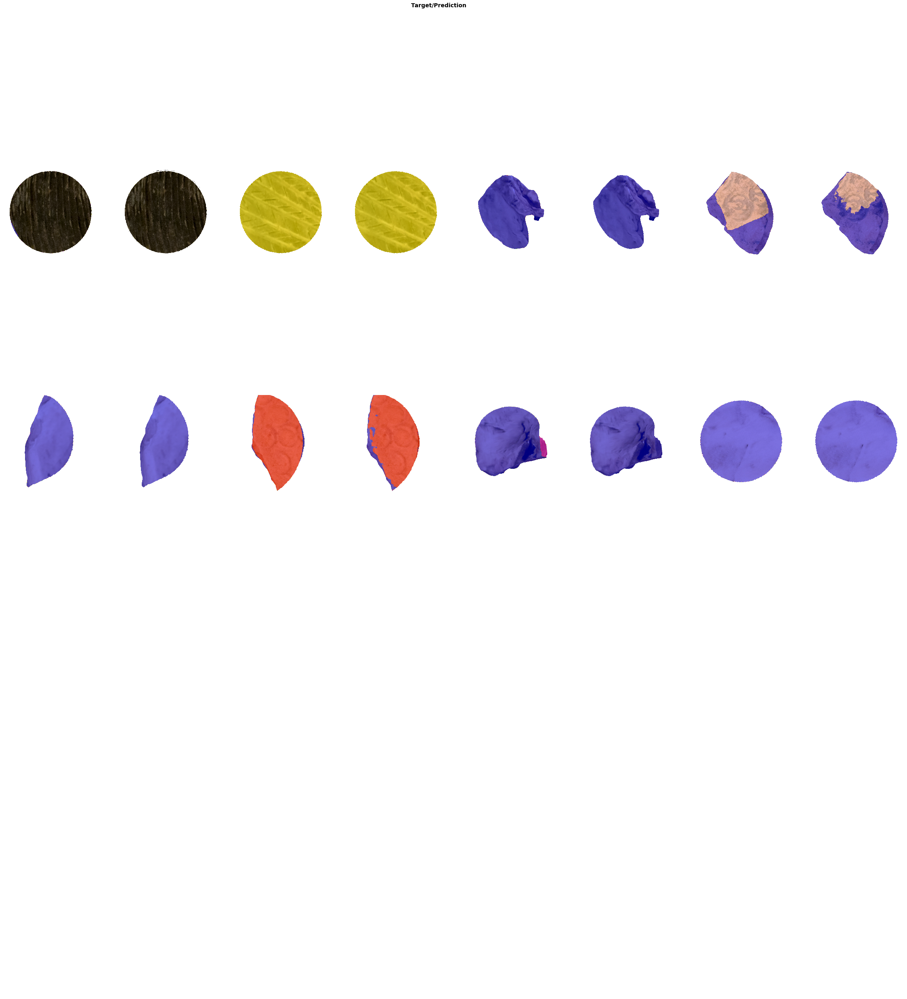

In [87]:
show_results(env, learn)

# Strong Data Aug

Setting-up type transforms pipelines
Found 1821 items
2 datasets of sizes 1290,531
Setting up Pipeline: PILBase.create
Setting up Pipeline: get_y_fn -> PILBase.create

Building one sample
  Pipeline: PILBase.create
    starting from
      /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB/training/images/11_79-col.jpg
    applying PILBase.create gives
      PILImage mode=RGB size=1585x1502
  Pipeline: get_y_fn -> PILBase.create
    starting from
      /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB/training/images/11_79-col.jpg
    applying get_y_fn gives
      /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB/training/masks/11_79-col.png
    applying PILBase.create gives
      PILMask mode=RGB size=1585x1502

Final sample: (PILImage mode=RGB size=1585x1502, PILMask mode=RGB size=1585x1502)


Found 1821 items
2 datasets of sizes 1290,531
Se

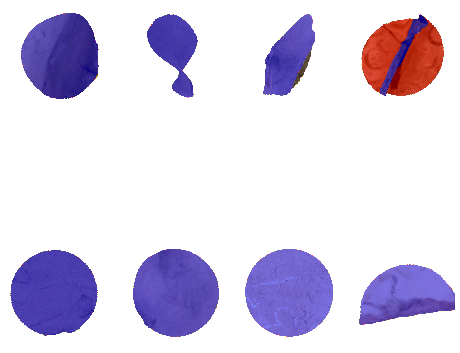

In [88]:
learn = init_learner(env)

## Round 1

-------------------------------------
Running with strong data augmentation
-------------------------------------
Setting-up type transforms pipelines
Found 1821 items
2 datasets of sizes 1290,531
Setting up Pipeline: PILBase.create
Setting up Pipeline: get_y_fn -> PILBase.create

Building one sample
  Pipeline: PILBase.create
    starting from
      /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB/training/images/11_79-col.jpg
    applying PILBase.create gives
      PILImage mode=RGB size=1585x1502
  Pipeline: get_y_fn -> PILBase.create
    starting from
      /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB/training/images/11_79-col.jpg
    applying get_y_fn gives
      /var/tmp/ranieri/dataset/surface-pattern-recognition/segmentation/SURFpattSegmentation_v3alpha-RGB/training/masks/11_79-col.png
    applying PILBase.create gives
      PILMask mode=RGB size=1585x1502

Final sample: (PIL

Fri Sep 24 08:45:49 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 450.80.02    Driver Version: 450.80.02    CUDA Version: 11.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla V100-PCIE...  On   | 00000000:5E:00.0 Off |                    0 |
| N/A   40C    P0    38W / 250W |  31033MiB / 32510MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
|   1  Tesla V100-PCIE...  On   | 00000000:86:00.0 Off |                    0 |
| N/A   

epoch,train_loss,valid_loss,surfpatt_metric,f-score,precision,recall,time
0,0.772250,0.505337,0.000010,0.229824,0.305990,0.247678,11:35
1,0.546410,0.411915,0.008494,0.244235,0.425568,0.255990,11:33
2,0.467160,0.366308,0.013925,0.249777,0.547846,0.258774,11:34
3,0.426049,0.327460,0.080160,0.308308,0.592201,0.300281,11:33
4,0.421566,0.282244,0.214524,0.444912,0.608240,0.405217,11:33
5,0.383443,0.280406,0.338100,0.491540,0.694326,0.486575,11:37
6,0.389742,0.258642,0.328040,0.497380,0.736579,0.465160,11:34
7,0.346205,0.250818,0.250629,0.463222,0.773689,0.425138,11:35
8,0.340618,0.242628,0.347200,0.501493,0.672492,0.477342,11:33
9,0.342189,0.268416,0.407691,0.541381,0.667543,0.530536,11:34


Better model found at epoch 0 with valid_loss value: 0.5053372979164124.
Better model found at epoch 0 with valid_loss value: 0.5053372979164124.


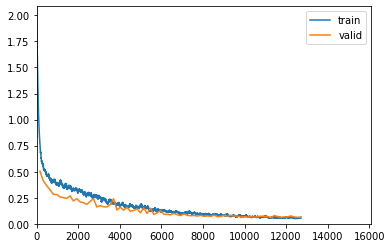

Better model found at epoch 1 with valid_loss value: 0.4119150936603546.
Better model found at epoch 1 with valid_loss value: 0.4119150936603546.
Better model found at epoch 2 with valid_loss value: 0.3663077652454376.
Better model found at epoch 2 with valid_loss value: 0.3663077652454376.
Better model found at epoch 3 with valid_loss value: 0.32746028900146484.
Better model found at epoch 3 with valid_loss value: 0.32746028900146484.
Better model found at epoch 4 with valid_loss value: 0.2822442352771759.
Better model found at epoch 4 with valid_loss value: 0.2822442352771759.
Better model found at epoch 5 with valid_loss value: 0.2804062068462372.
Better model found at epoch 5 with valid_loss value: 0.2804062068462372.
Better model found at epoch 6 with valid_loss value: 0.2586424946784973.
Better model found at epoch 6 with valid_loss value: 0.2586424946784973.
Better model found at epoch 7 with valid_loss value: 0.2508181035518646.
Better model found at epoch 7 with valid_loss val

Looking for SURFpatt_v3alpha-RGB-deeplabv3+-resnet152-*-best models in: /home/ranieri/notebooks/models
--------------------
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1a-2021-09-20_17.43.42-WD-0.0001-BS-8-LR-0.0015848932266235352-0.015848932266235353-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1b-2021-09-20_17.43.42-WD-0.0001-BS-8-LR-6.30957365501672e-08-6.30957365501672e-07-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB-deeplabv3+-resnet152-basic-data-aug-img_size-1585-1585-1a-2021-09-20_17.43.42-WD-0.0001-BS-8-LR-0.0007585775852203369-0.007585775852203369-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1a-2021-09-21_12.18.58-WD-0.0001-BS-8-LR-0.0027542285919189453-0.027542285919189453-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB-deeplabv3+-resnet152-no-data-aug-i

0 - valid_loss = 0.05924293398857117
1 - surfpatt_metric = 0.7634257674217224
2 - f-score = 0.901025532111765
3 - precision = 0.89654347198171
4 - recall = 0.9060224077206607
LR_finding in parallel_ctx context on GPU [0, 1]


Sat Sep 25 00:24:01 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 450.80.02    Driver Version: 450.80.02    CUDA Version: 11.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla V100-PCIE...  On   | 00000000:5E:00.0 Off |                    0 |
| N/A   41C    P0    38W / 250W |  31033MiB / 32510MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
|   1  Tesla V100-PCIE...  On   | 00000000:86:00.0 Off |                    0 |
| N/A   

epoch,train_loss,valid_loss,surfpatt_metric,f-score,precision,recall,time
0,0.063379,0.062724,0.767714,0.894429,0.883394,0.906708,11:52
1,0.055949,0.062745,0.771007,0.896229,0.882531,0.911105,11:54
2,0.055426,0.062441,0.765313,0.894097,0.884351,0.905124,11:51
3,0.054835,0.063683,0.770522,0.890538,0.874377,0.908350,11:53
4,0.061834,0.063292,0.766069,0.893310,0.880925,0.906925,11:54
5,0.052499,0.060894,0.764829,0.894385,0.883257,0.906651,11:49
6,0.055223,0.061952,0.768285,0.898264,0.886742,0.910518,11:52
7,0.059464,0.062606,0.766237,0.893661,0.879766,0.909042,11:52
8,0.054818,0.063852,0.764828,0.888577,0.872968,0.906717,11:52
9,0.055322,0.060995,0.764801,0.897754,0.887070,0.909322,11:51


Better model found at epoch 0 with valid_loss value: 0.06272435933351517.
Better model found at epoch 0 with valid_loss value: 0.06272435933351517.


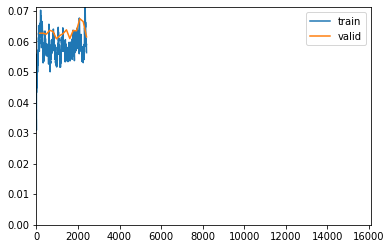

Better model found at epoch 2 with valid_loss value: 0.0624413937330246.
Better model found at epoch 2 with valid_loss value: 0.0624413937330246.
Better model found at epoch 5 with valid_loss value: 0.06089409068226814.
Better model found at epoch 5 with valid_loss value: 0.06089409068226814.
No improvement since epoch 5: early stopping
Sat Sep 25 03:34:29 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 450.80.02    Driver Version: 450.80.02    CUDA Version: 11.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla V100-PCIE...  On   | 00000000:5E:00.0 Off |             

Looking for SURFpatt_v3alpha-RGB-deeplabv3+-resnet152-*-best models in: /home/ranieri/notebooks/models
--------------------
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1a-2021-09-20_17.43.42-WD-0.0001-BS-8-LR-0.0015848932266235352-0.015848932266235353-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1b-2021-09-20_17.43.42-WD-0.0001-BS-8-LR-6.30957365501672e-08-6.30957365501672e-07-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB-deeplabv3+-resnet152-basic-data-aug-img_size-1585-1585-1a-2021-09-20_17.43.42-WD-0.0001-BS-8-LR-0.0007585775852203369-0.007585775852203369-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB-deeplabv3+-resnet152-no-data-aug-img_size-1585-1585-1a-2021-09-21_12.18.58-WD-0.0001-BS-8-LR-0.0027542285919189453-0.027542285919189453-best.pth
/home/ranieri/notebooks/models/SURFpatt_v3alpha-RGB-deeplabv3+-resnet152-no-data-aug-i

0 - valid_loss = 0.06089674308896065
1 - surfpatt_metric = 0.764835000038147
2 - f-score = 0.8943843506822147
3 - precision = 0.8832482796894439
4 - recall = 0.906661038020135


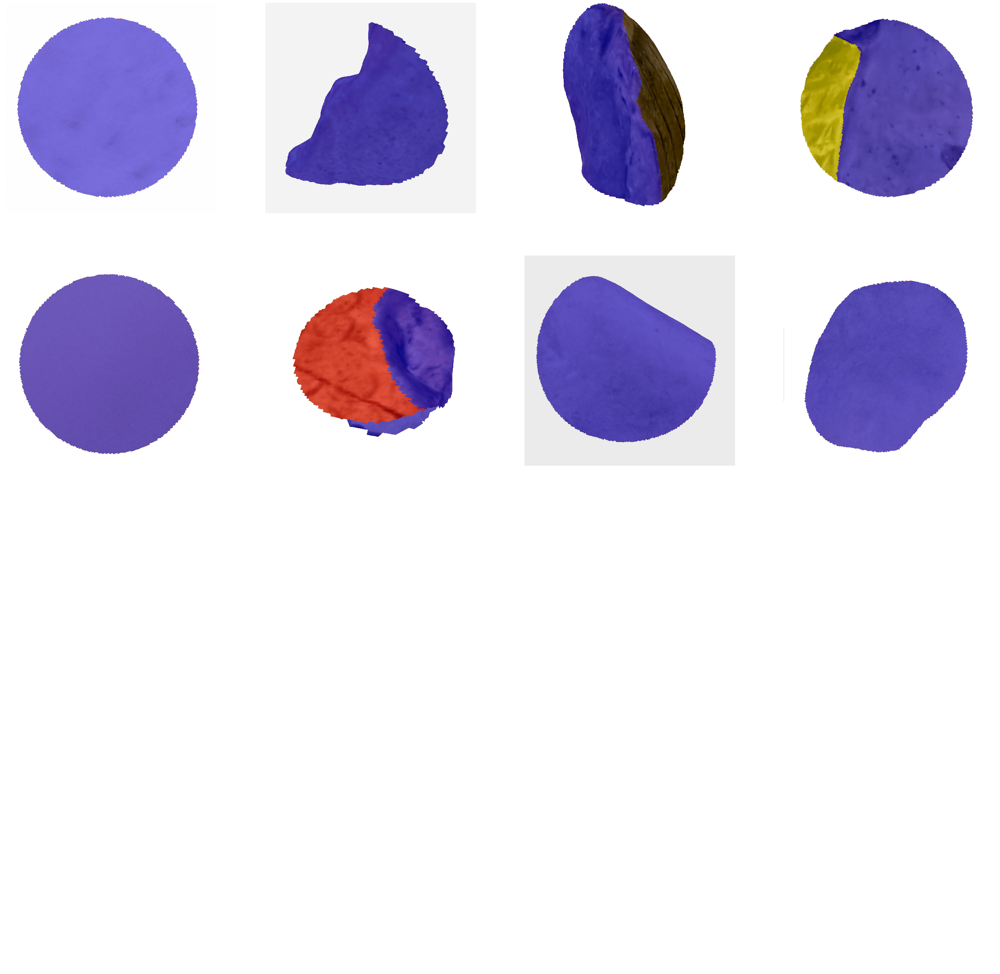

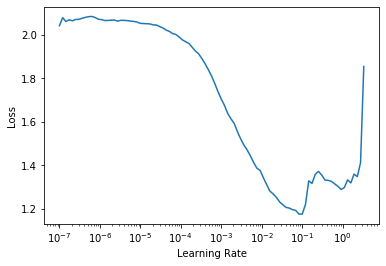

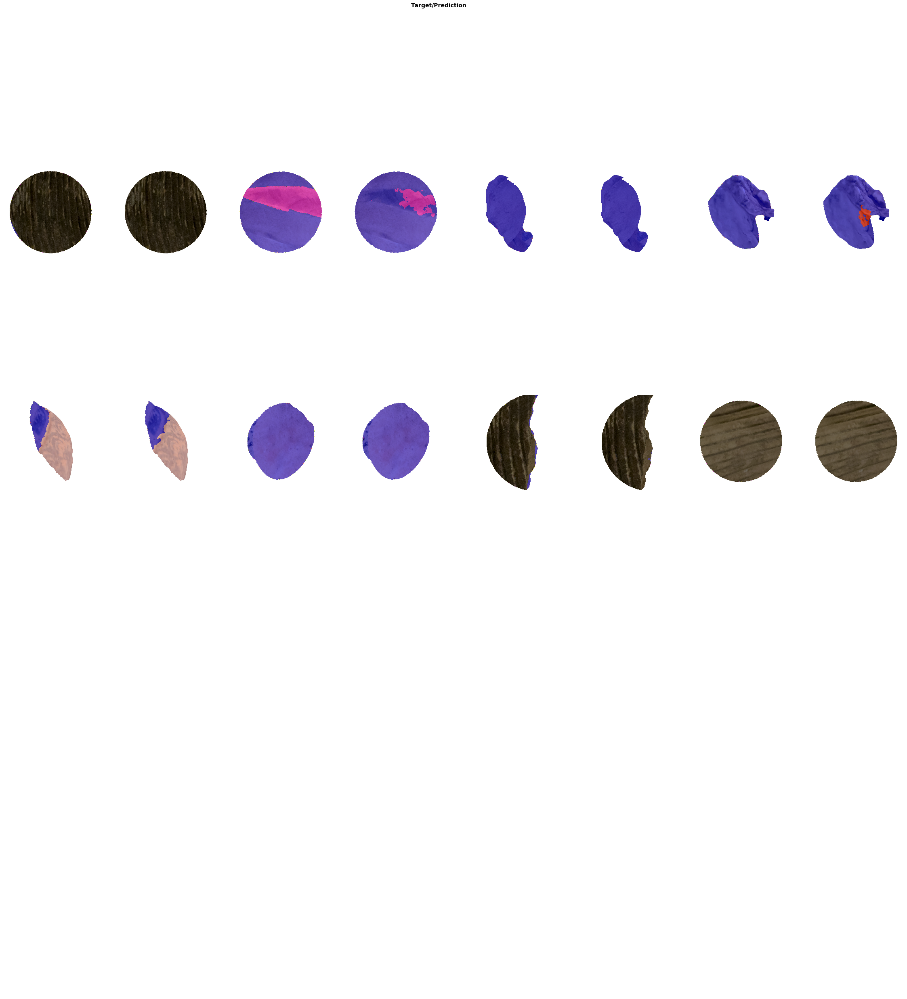

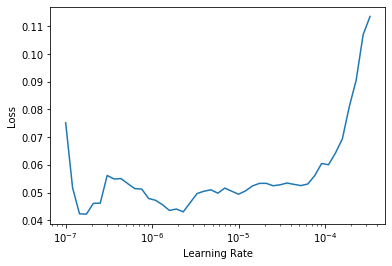

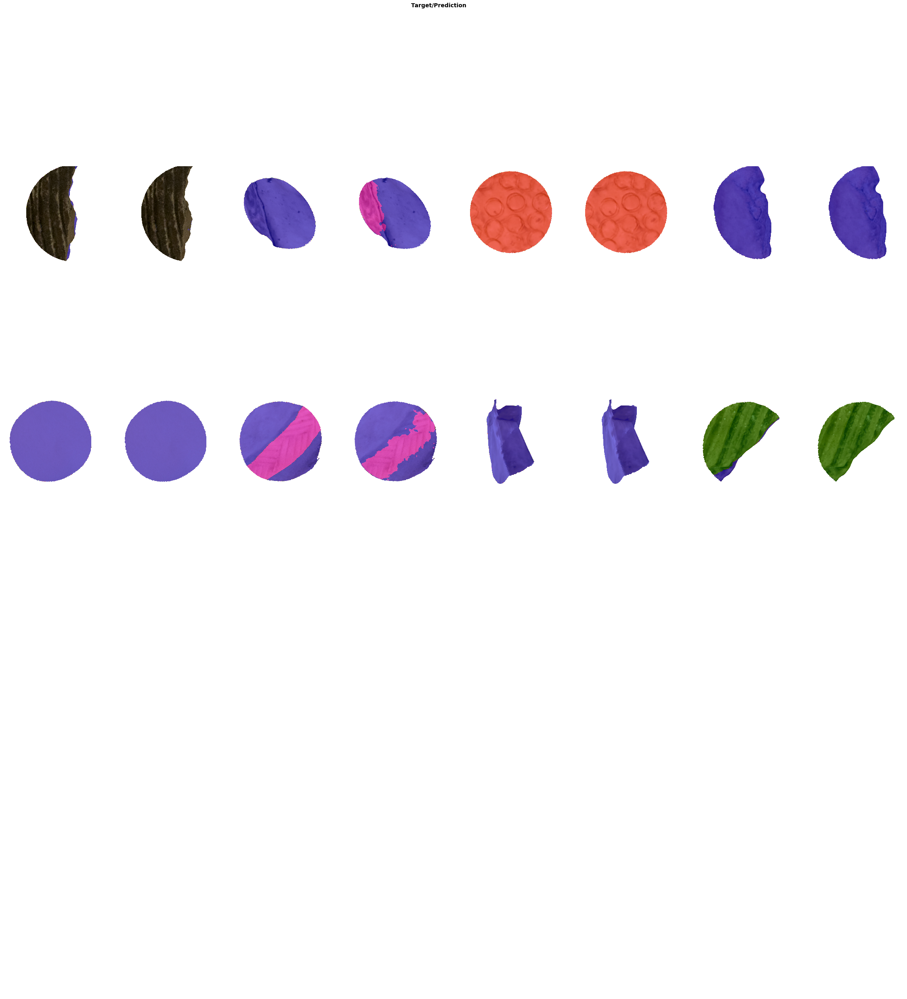

In [89]:
env['train_round']       = 0
env['data-augmentation'] = 'strong-data-aug'
do_training_round(env, learn, epochs=100)

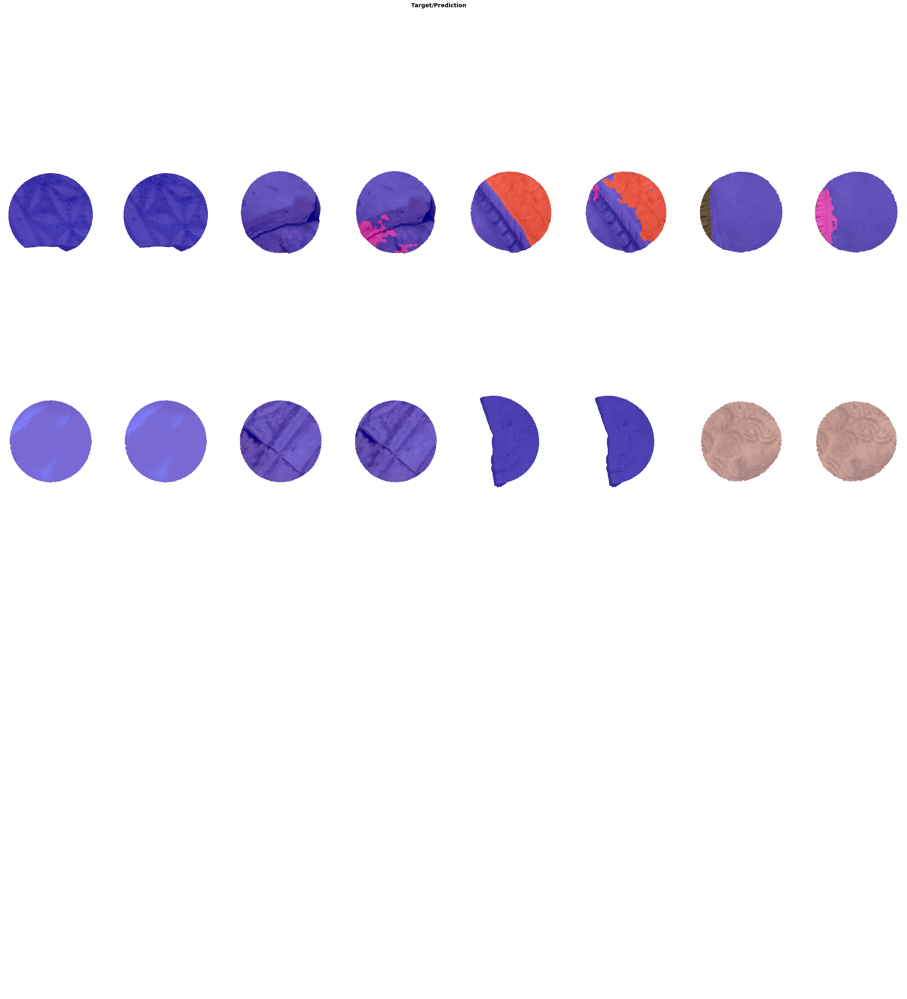

In [90]:
show_results(env, learn)

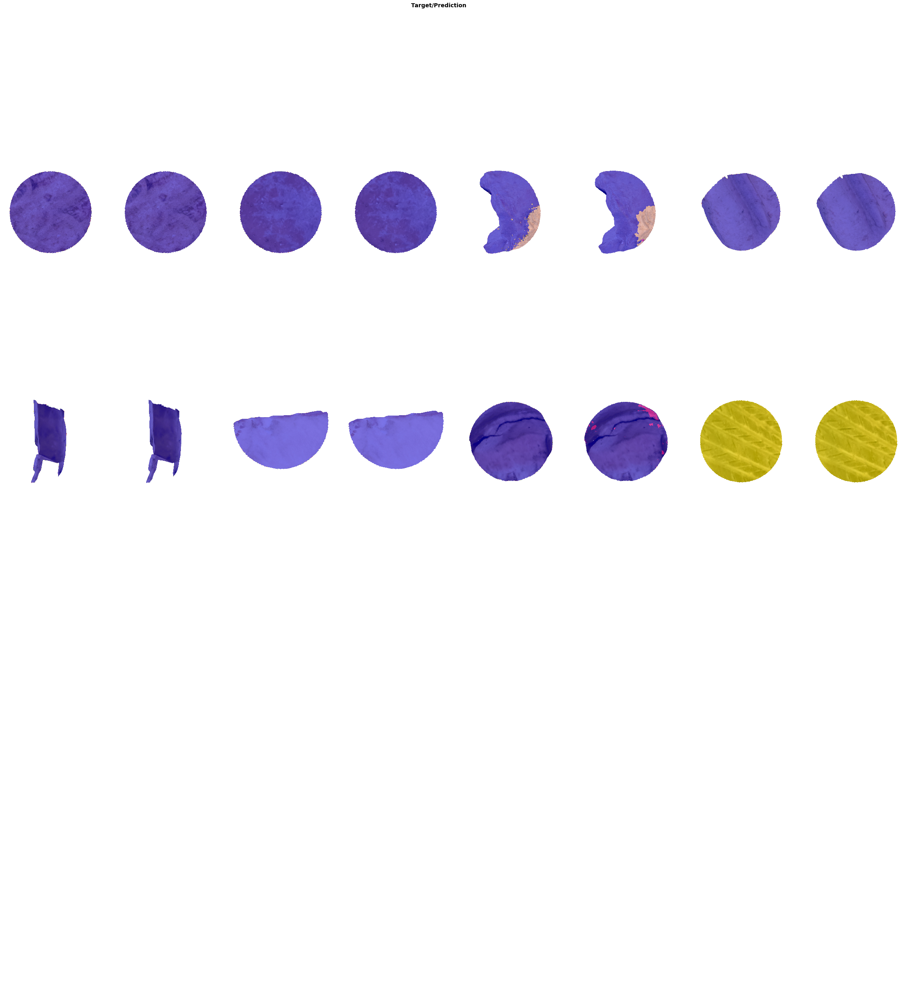

In [91]:
show_results(env, learn)

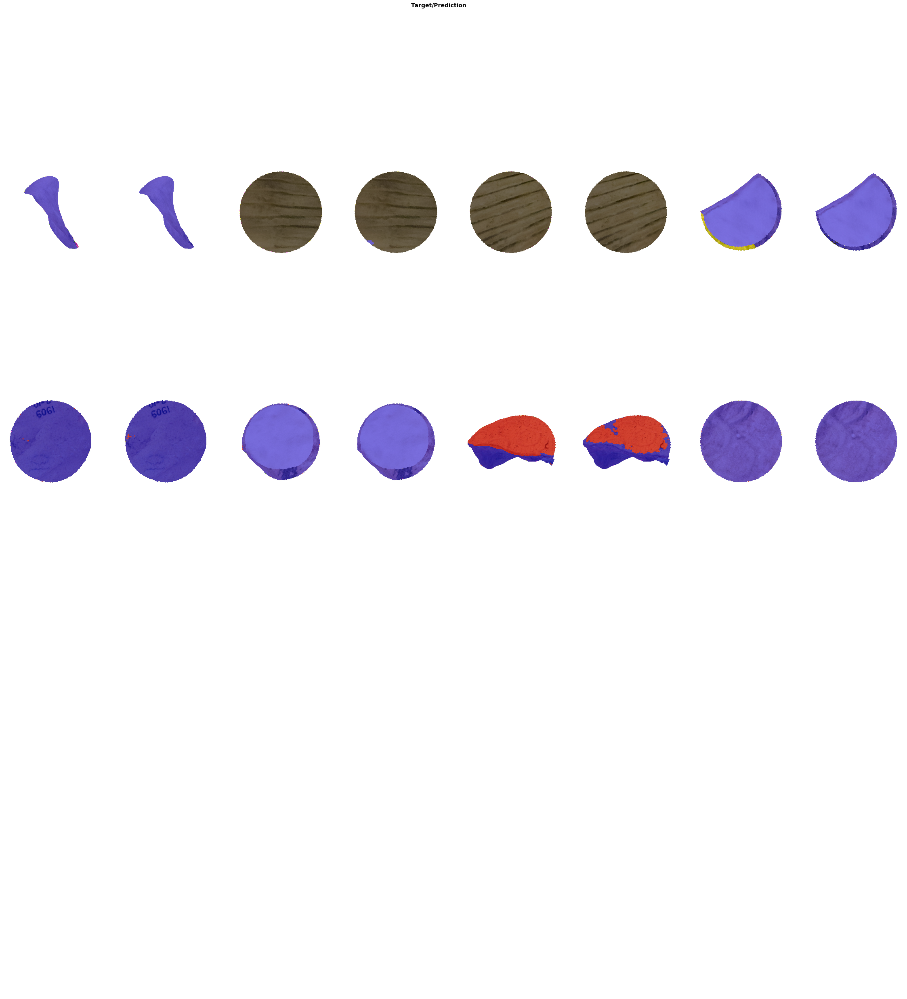

In [92]:
show_results(env, learn)

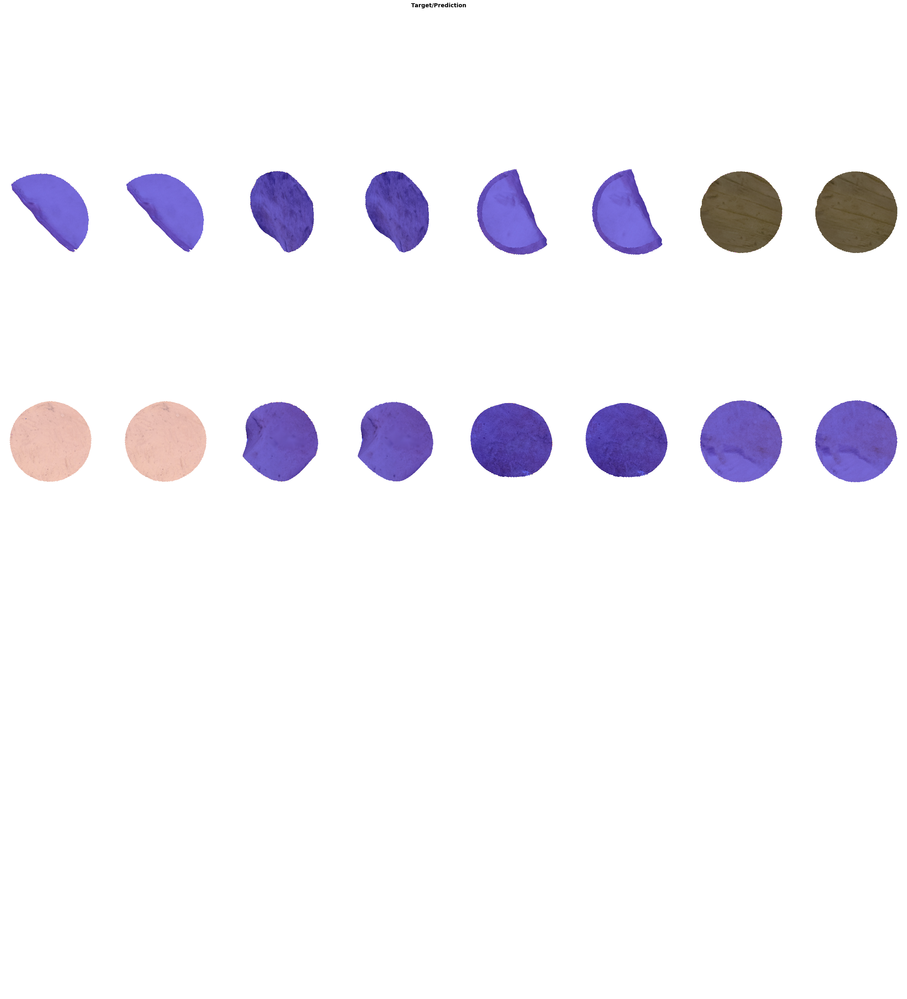

In [93]:
show_results(env, learn)

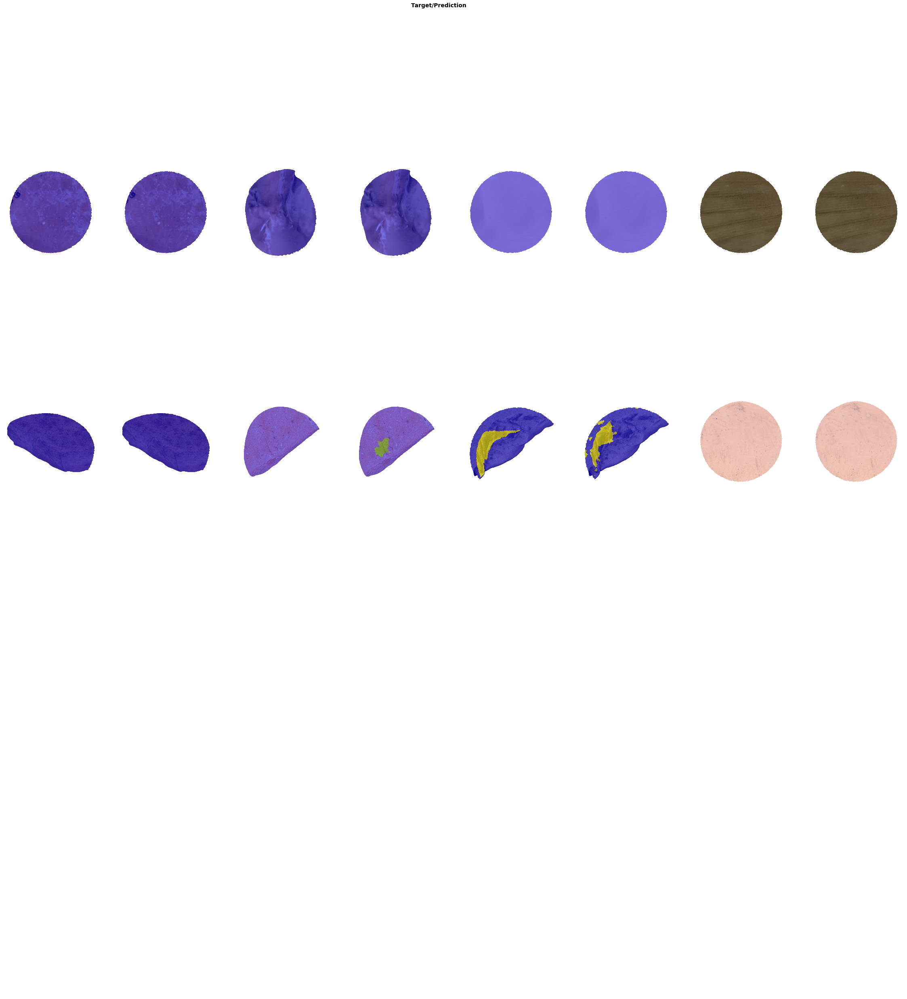

In [94]:
show_results(env, learn)

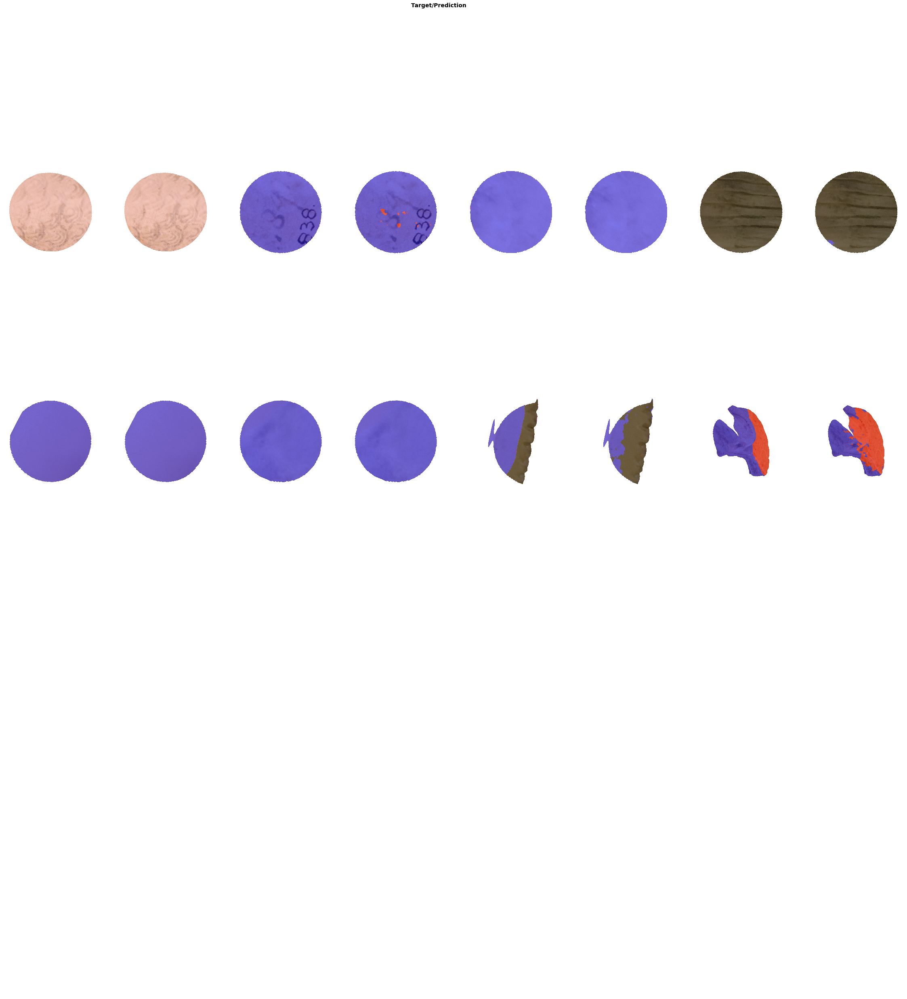

In [95]:
show_results(env, learn)

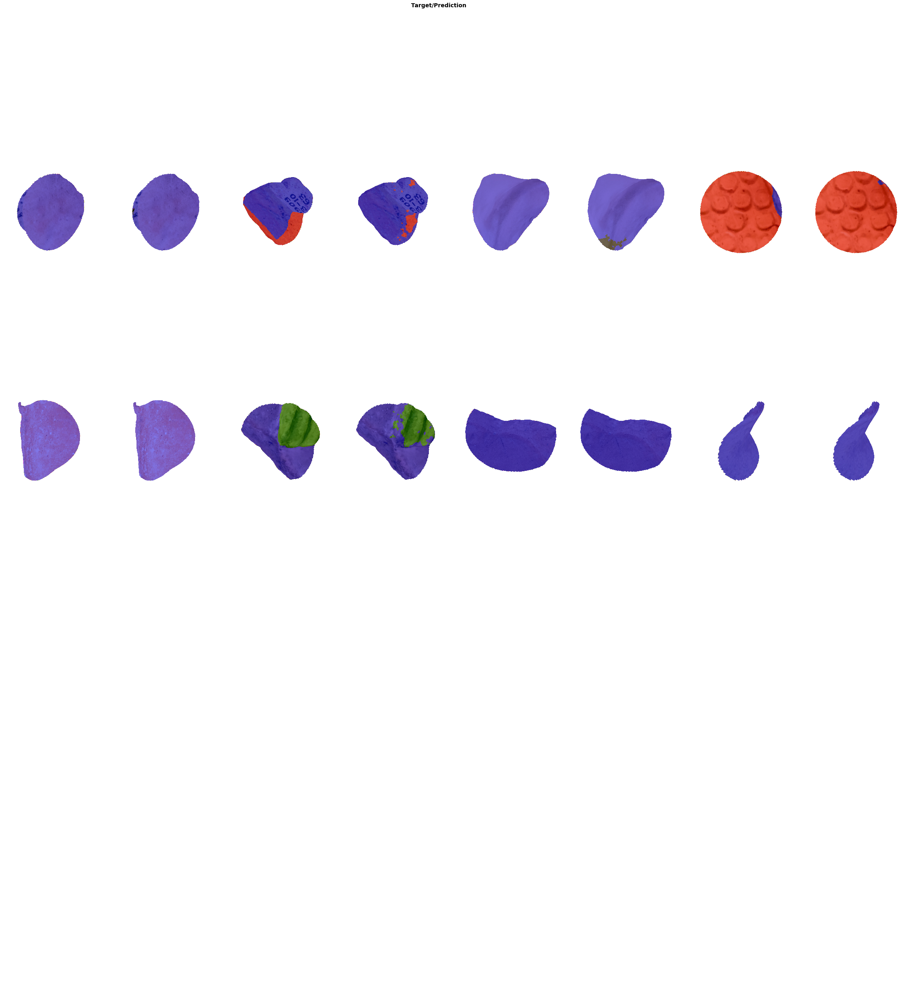

In [96]:
show_results(env, learn)

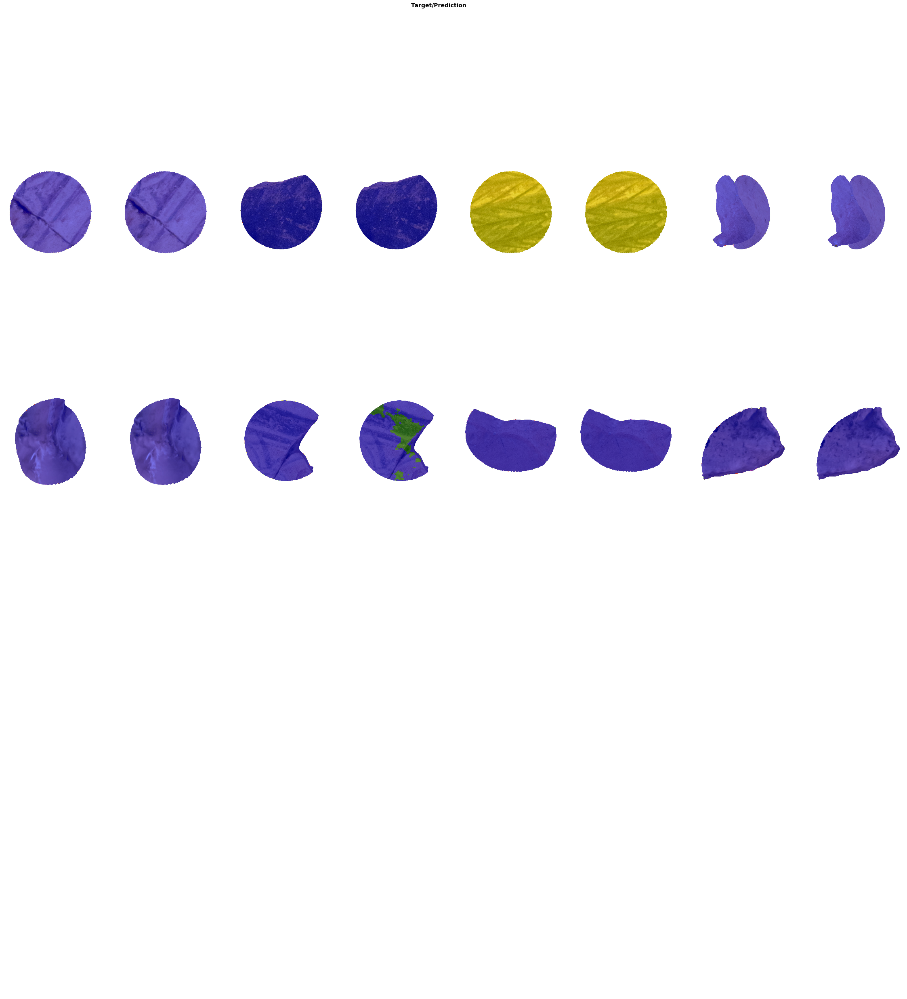

In [97]:
show_results(env, learn)

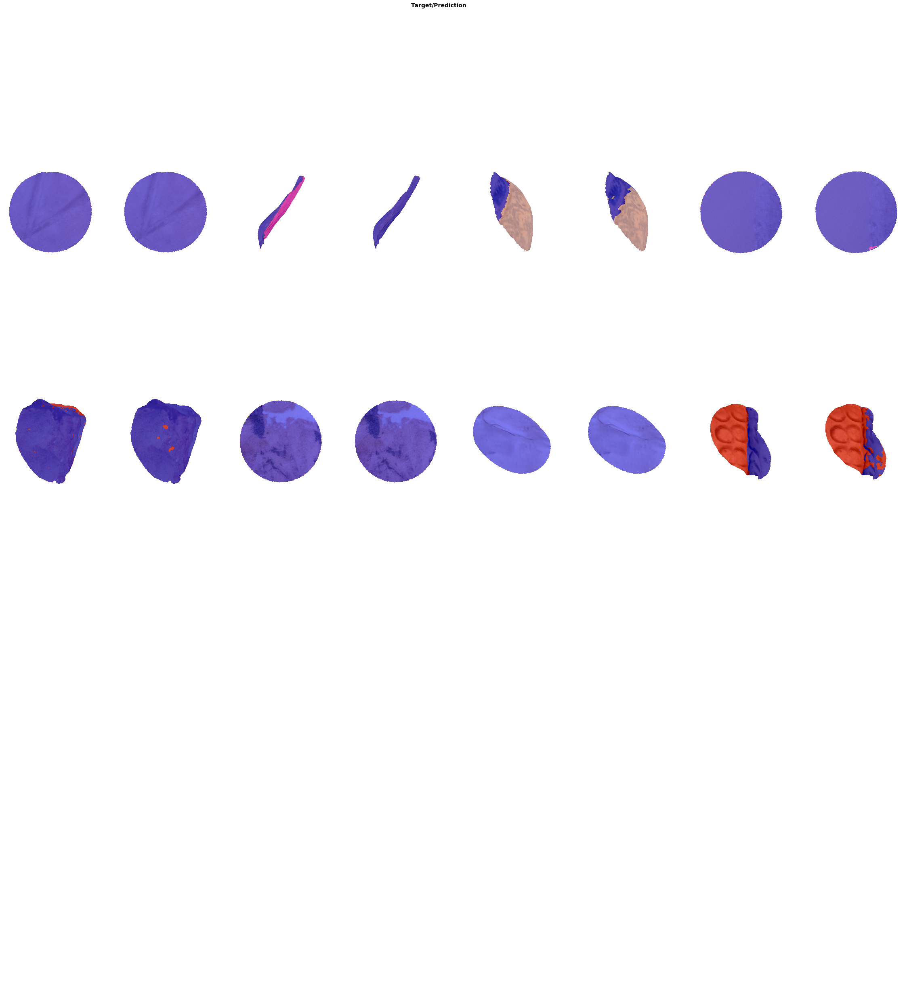

In [98]:
show_results(env, learn)

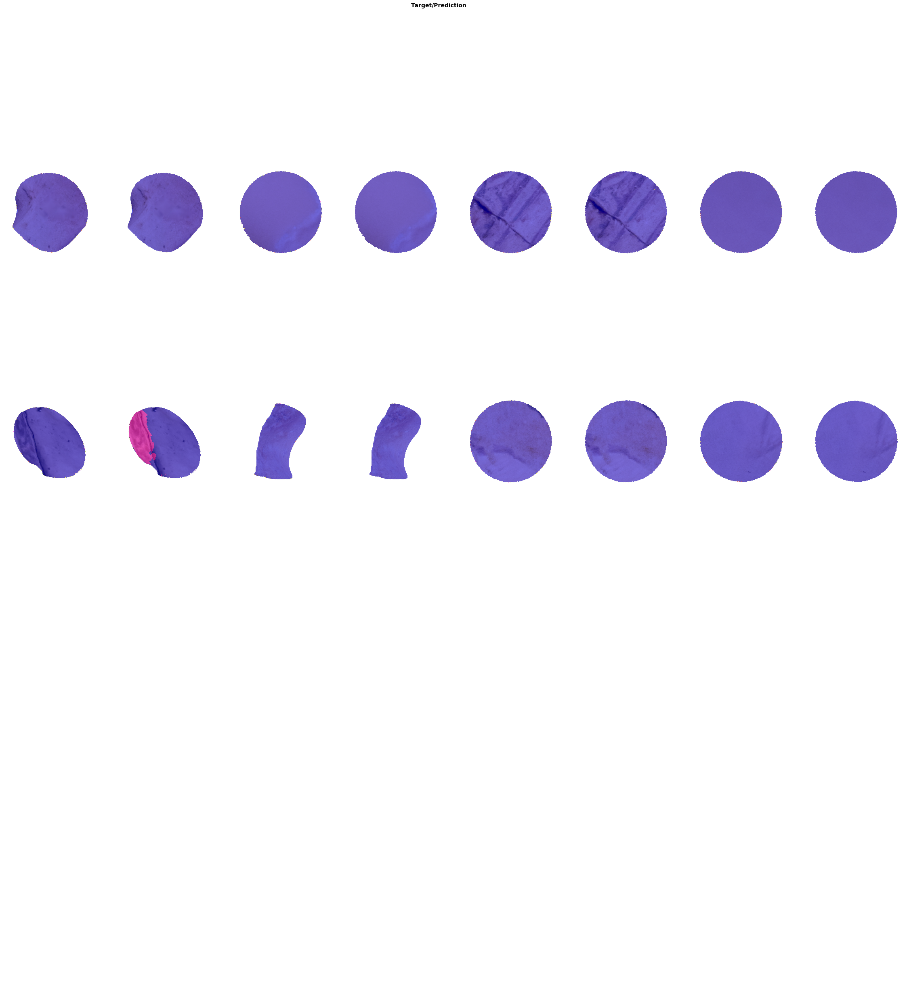

In [99]:
show_results(env, learn)

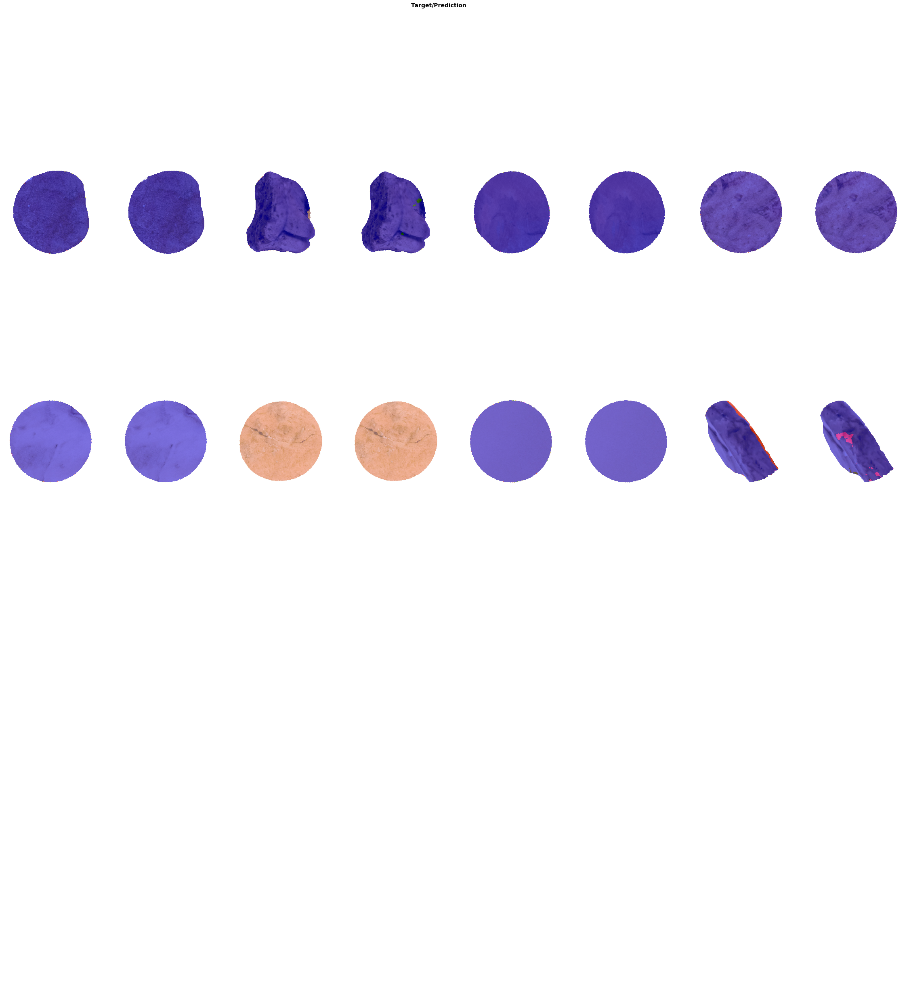

In [100]:
show_results(env, learn)

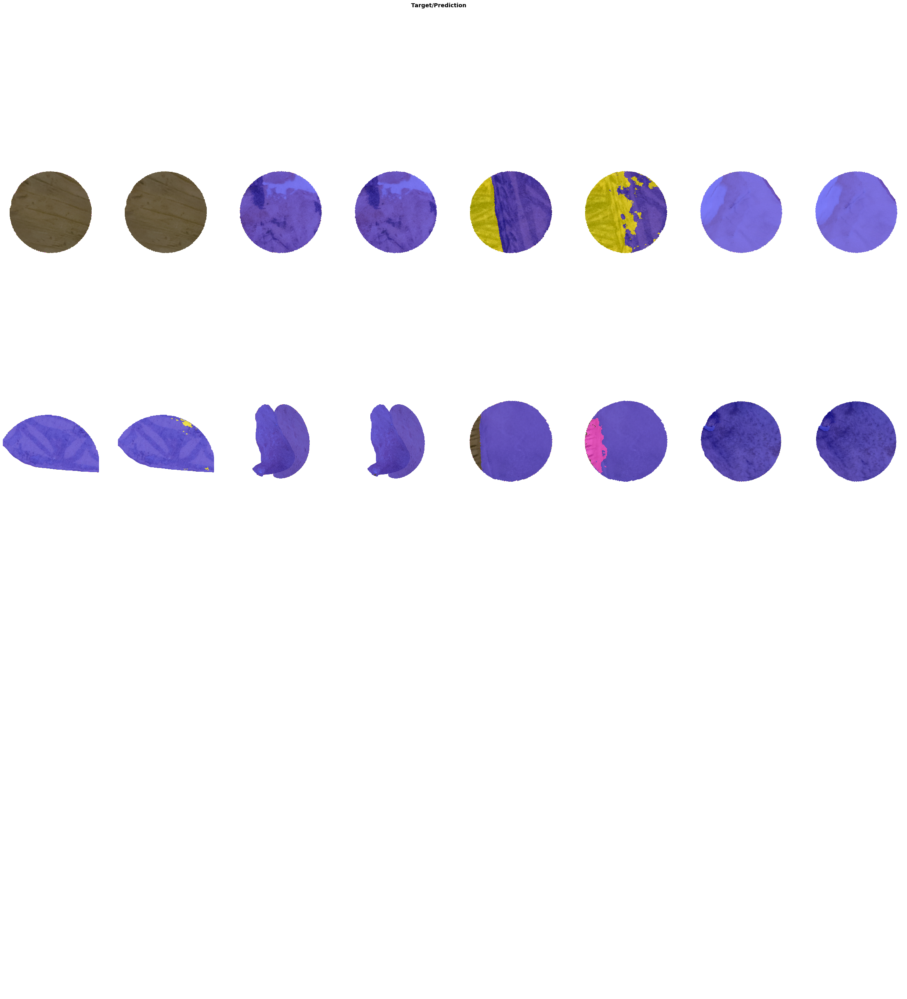

In [101]:
show_results(env, learn)

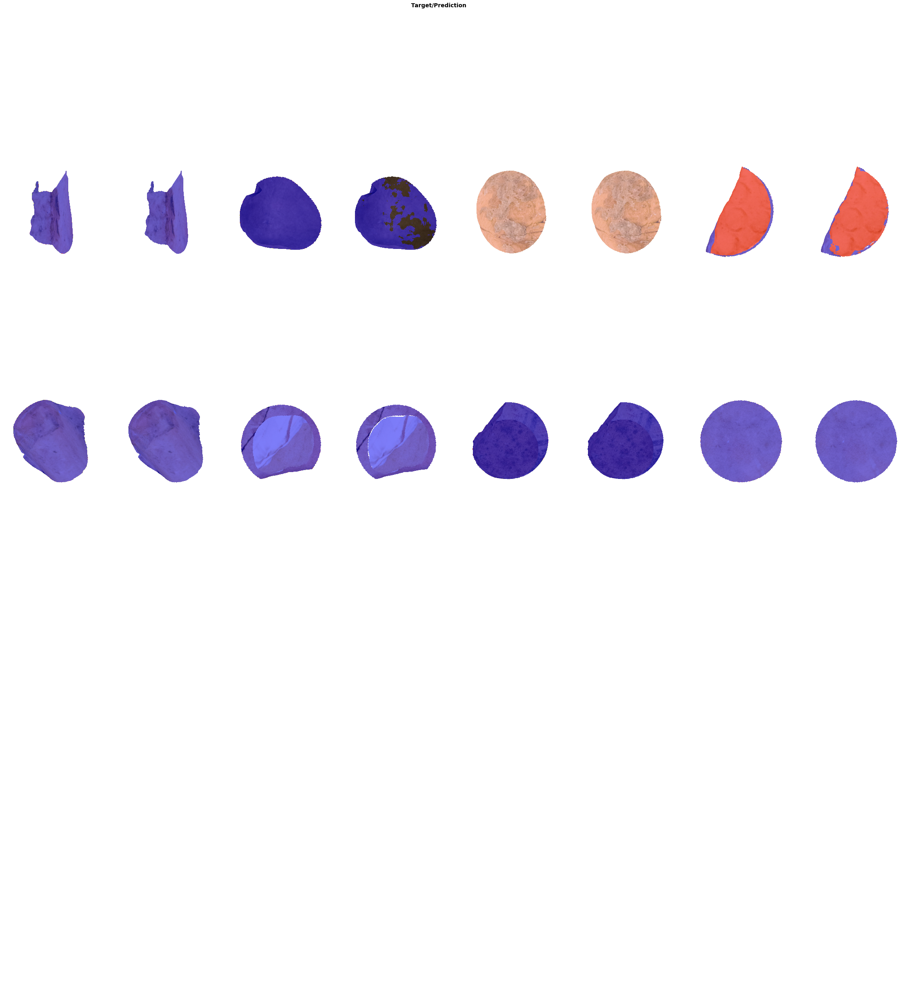

In [102]:
show_results(env, learn)

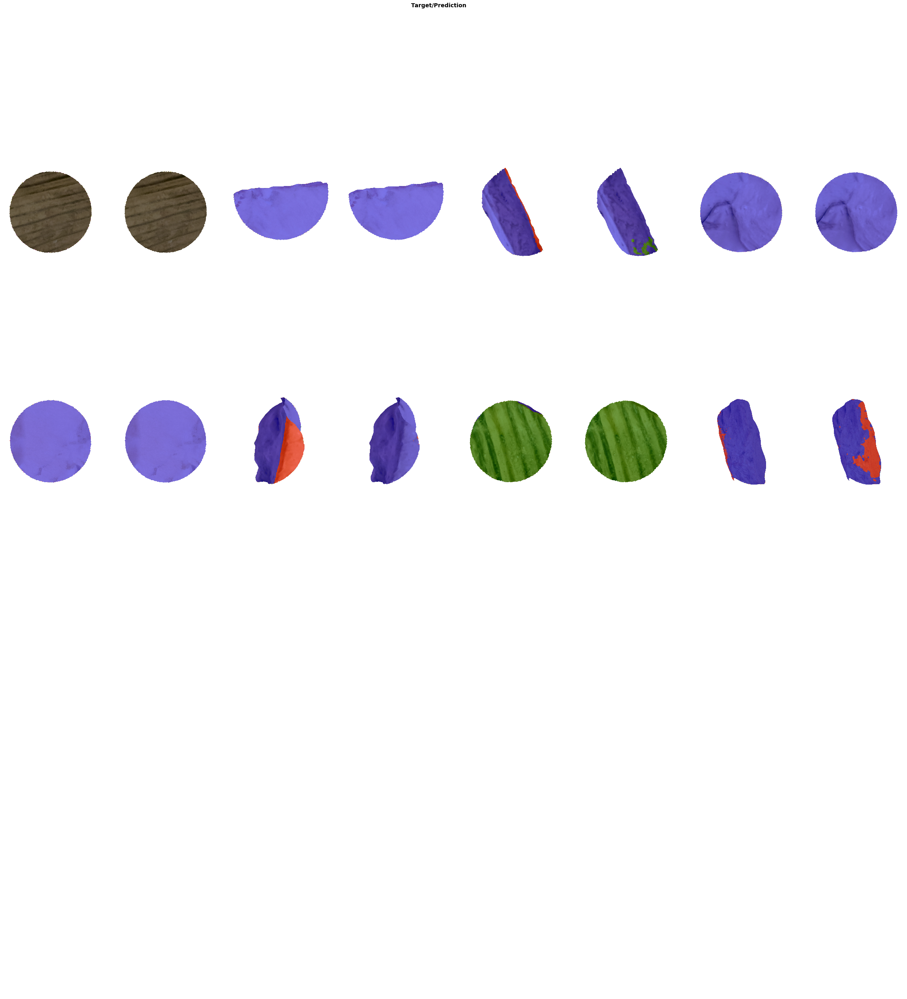

In [103]:
show_results(env, learn)

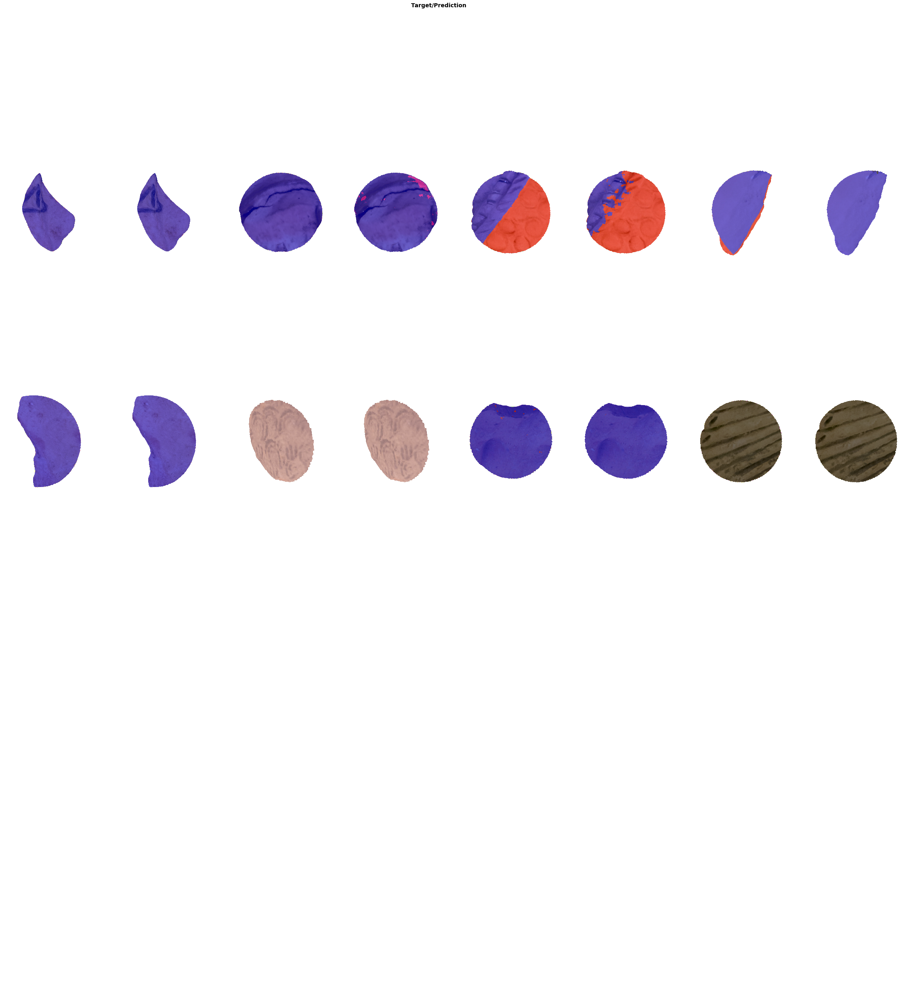

In [104]:
show_results(env, learn)

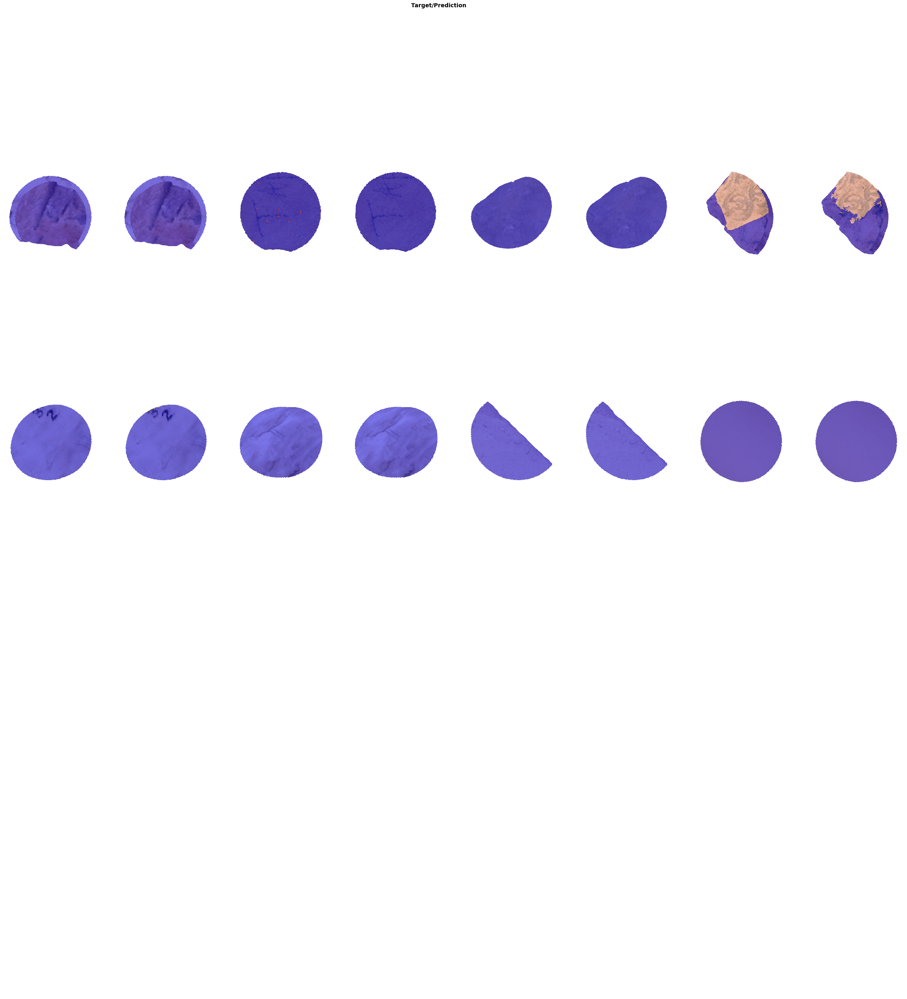

In [105]:
show_results(env, learn)

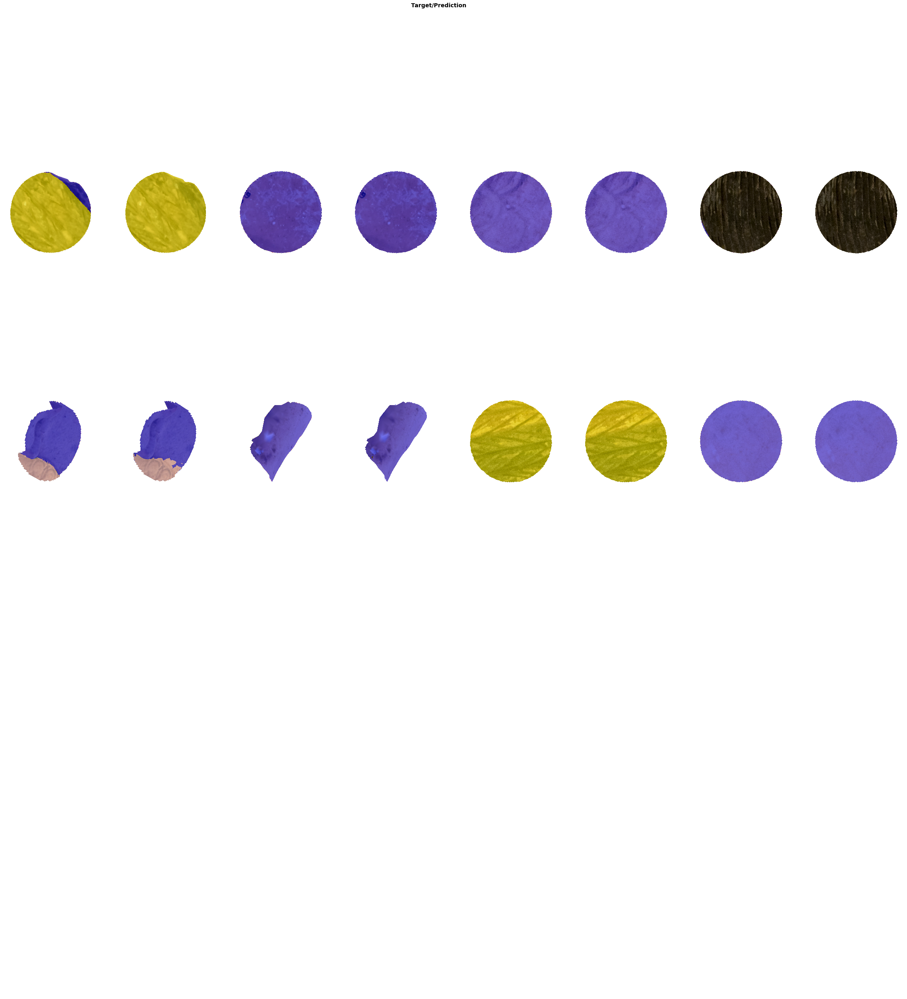

In [106]:
show_results(env, learn)

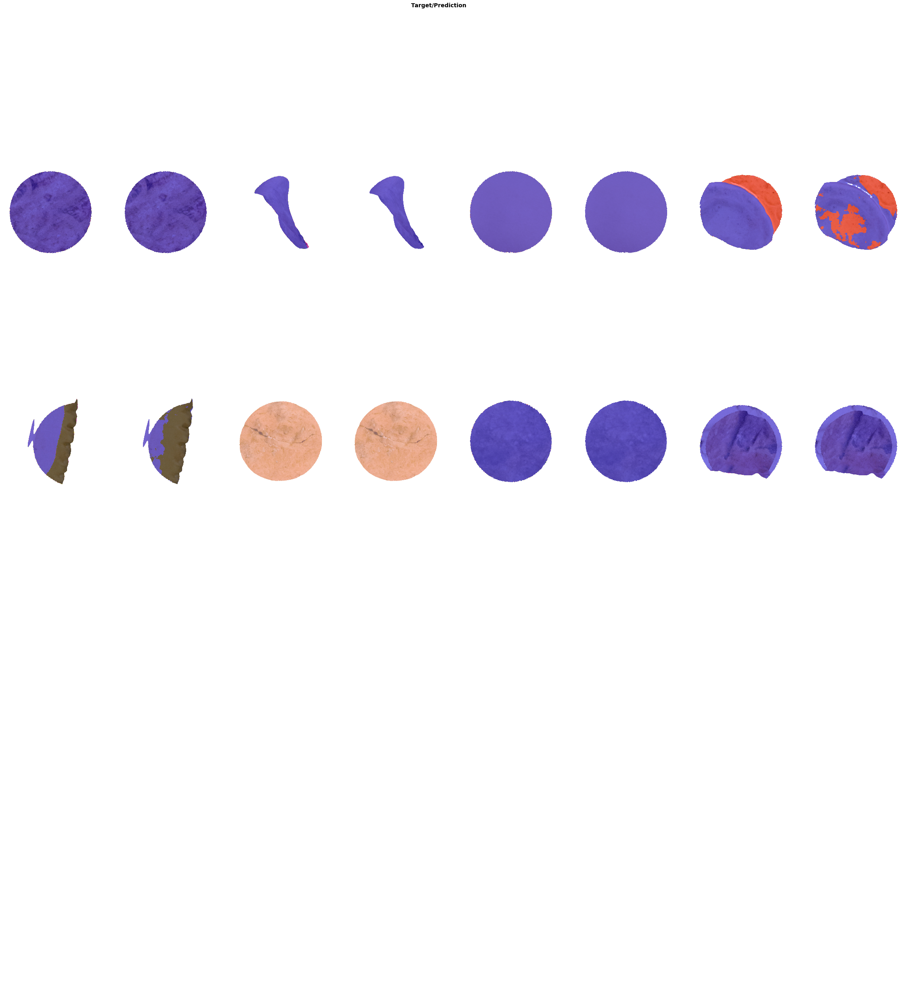

In [107]:
show_results(env, learn)

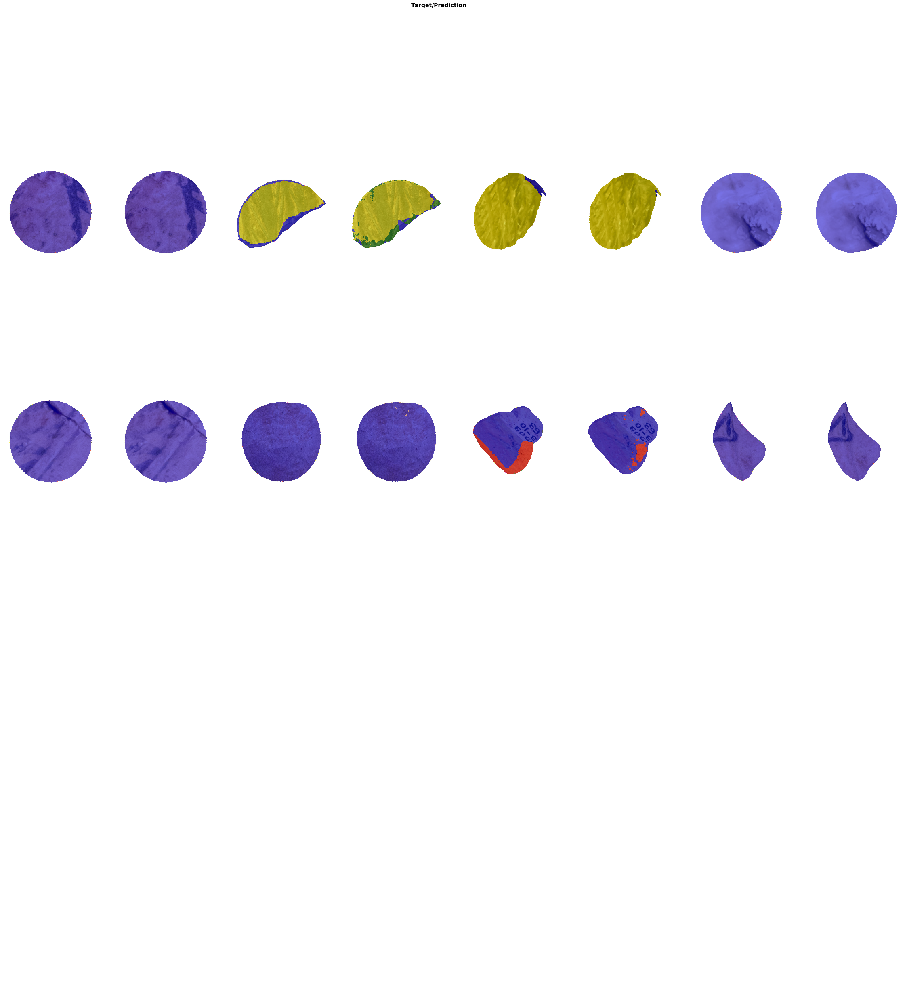

In [108]:
show_results(env, learn)

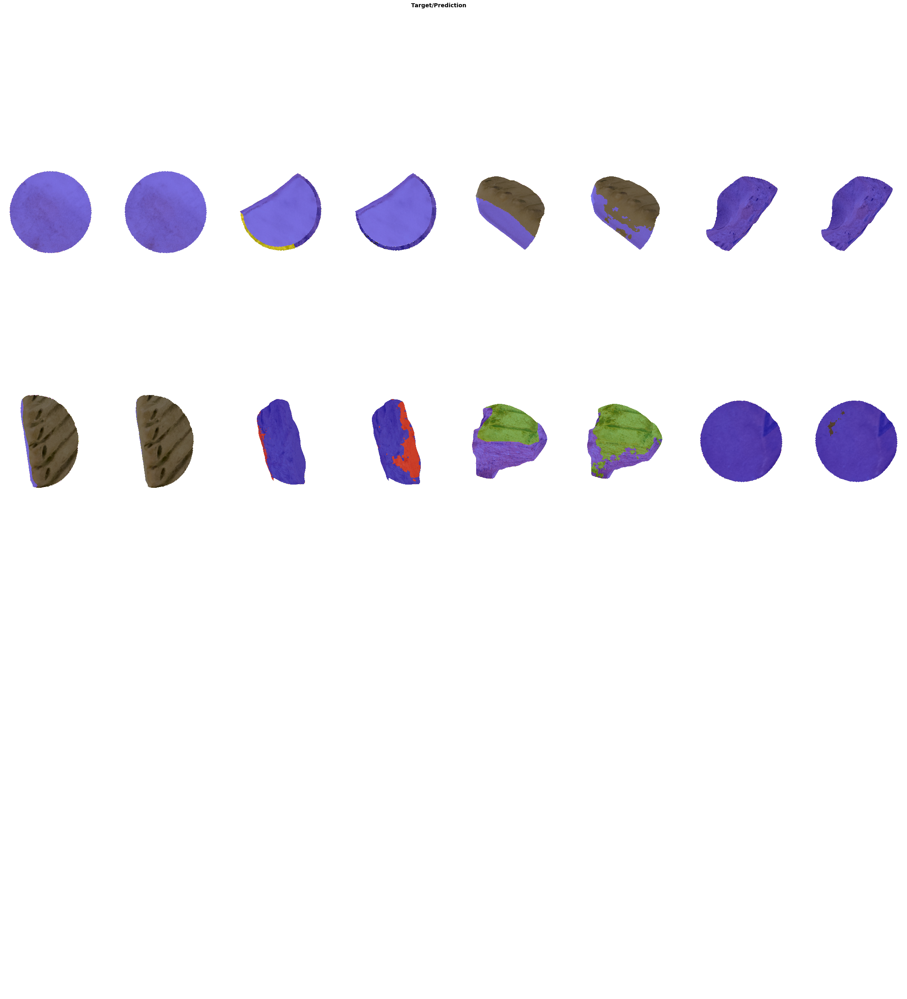

In [109]:
show_results(env, learn)